In [2]:
!pip install tensorflow

  Obtaining dependency information for tensorflow from https://files.pythonhosted.org/packages/93/21/9b035a4f823d6aee2917c75415be9a95861ff3d73a0a65e48edbf210cec1/tensorflow-2.15.0-cp311-cp311-win_amd64.whl.metadata
  Obtaining dependency information for tensorflow-intel==2.15.0 from https://files.pythonhosted.org/packages/4c/48/1a5a15517f18eaa4ff8d598b1c000300b20c1bb0e624539d702117a0c369/tensorflow_intel-2.15.0-cp311-cp311-win_amd64.whl.metadata
  Obtaining dependency information for absl-py>=1.0.0 from https://files.pythonhosted.org/packages/01/e4/dc0a1dcc4e74e08d7abedab278c795eef54a224363bb18f5692f416d834f/absl_py-2.0.0-py3-none-any.whl.metadata
  Obtaining dependency information for flatbuffers>=23.5.26 from https://files.pythonhosted.org/packages/6f/12/d5c79ee252793ffe845d58a913197bfa02ae9a0b5c9bc3dc4b58d477b9e7/flatbuffers-23.5.26-py2.py3-none-any.whl.metadata
     ---------------------------------------- 0.0/57.5 kB ? eta -:--:--
     ---------------------------------------- 57.5

In [4]:
!pip install tensorflow_hub

  Obtaining dependency information for tensorflow_hub from https://files.pythonhosted.org/packages/6e/1a/fbae76f4057b9bcdf9468025d7a8ca952dec14bfafb9fc0b1e4244ce212f/tensorflow_hub-0.15.0-py2.py3-none-any.whl.metadata
   ---------------------------------------- 0.0/85.4 kB ? eta -:--:--
   ---- ----------------------------------- 10.2/85.4 kB ? eta -:--:--
   -------------- ------------------------- 30.7/85.4 kB 262.6 kB/s eta 0:00:01
   ---------------------------- ----------- 61.4/85.4 kB 469.7 kB/s eta 0:00:01
   ---------------------------------------- 85.4/85.4 kB 533.2 kB/s eta 0:00:00


In [1]:
import numpy as np
import pandas as pd
import tensorflow as tf
import tensorflow_hub as hub
from tensorflow.keras.models import Model
from sklearn.model_selection import train_test_split
import matplotlib.pyplot as plt

In [2]:
from tensorflow import keras
from sklearn.metrics import roc_auc_score
import tensorflow
tensorflow.random.set_seed(2)
import re

In [39]:
df=pd.read_excel("hindi-tweets-dataframe.xlsx")
df.drop(columns=['Column1'],inplace=True)
df

,text,label
0,"हमारे गांव में एक मास्टर जी रहते थे, वो मोहल्ले के बच्चों को अपने स्कूल आने को कहते थे। जब मैं बड़ा हुआ तो पता चला- स्कूल मास्टर के बेटे का, बस उनके भतीजे की, कैंटीन उनके भांजे की और पढ़ाने वाले भी सब उनके रिश्तेदार ही थे..! \n\nआज मास्टर जी में सरकार में मंत्री हैं.! \n\n#कटाक्ष",sarcastic
1,"हमारे गांव में एक मास्टर जी रहते थे, वो मोहल्ले के बच्चों को अपने स्कूल आने को कहते थे। जब मैं बड़ा हुआ तो पता चला- स्कूल मास्टर के बेटे का, बस उनके भतीजे की, कैंटीन उनके भांजे की और पढ़ाने वाले भी सब उनके रिश्तेदार ही थे..! \n\nआज मास्टर जी में सरकार में मंत्री हैं.! \n\n#कटाक्ष",sarcastic
2,"हमारे गांव में एक मास्टर जी रहते थे, वो मोहल्ले के बच्चों को अपने स्कूल आने को कहते थे। जब मैं बड़ा हुआ तो पता चला- स्कूल मास्टर के बेटे का, बस उनके भतीजे की, कैंटीन उनके भांजे की और पढ़ाने वाले भी सब उनके रिश्तेदार ही थे..! \n\nआज मास्टर जी में सरकार में मंत्री हैं.! \n\n#कटाक्ष",sarcastic
3,"हमारे गांव में एक मास्टर जी रहते थे, वो मोहल्ले के बच्चों को अपने स्कूल आने को कहते थे। जब मैं बड़ा हुआ तो पता चला- स्कूल मास्टर के बेटे का, बस उनके भतीजे की, कैंटीन उनके भांजे की और पढ़ाने वाले भी सब उनके रिश्तेदार ही थे..! \n\nआज मास्टर जी में सरकार में मंत्री हैं.! \n\n#कटाक्ष",sarcastic
4,"हमारे गांव में एक मास्टर जी रहते थे, वो मोहल्ले के बच्चों को अपने स्कूल आने को कहते थे। जब मैं बड़ा हुआ तो पता चला- स्कूल मास्टर के बेटे का, बस उनके भतीजे की, कैंटीन उनके भांजे की और पढ़ाने वाले भी सब उनके रिश्तेदार ही थे..! \n\nआज मास्टर जी में सरकार में मंत्री हैं.! \n\n#कटाक्ष",sarcastic
...,...,...
16174,स्वर्गीय श्री सुशांत सिंह राजपूत ने हमें छिछोरे मूवी में काम करके यह सिखाया कि संघर्ष से दूर ना भागे । आत्महत्या ना करें और अब खुद ही आत्महत्या कर ली।\n#ripsushant #ripsushantsinghrajput #ripSSR #fuck2020 #sad https://t.co/WwhrA2iqQF,non_sarcastic
16175,"बॉलीवुड एक्टर #सुशांत_सिंह_राजपूत ने #फांसी लगाकर की खुदखुशी-\n#खुदखुशी करने वालो पर मुझे तरस नही आता,\nक्योंकि दुनिया मे #खुशी और #गम दोनों मिलते है जो उसे न झेल सके वो इंसान #बुझदिल होता है!\nसुशांत तुमने सही नहीं किया!\nखैर #अल्लाह घर वालों को सब्र अता करे-आमीन\n#SushantSinghRajput https://t.co/a8pRKR5GZU",non_sarcastic
16176,"#SushantSinghRajput #Suicide क्यों?? चमक धमक सिर्फ दिखावा है इस फिल्म इंडस्ट्री का, बाकी सब अंदर से टूटे हुए हैं चाहे फिर वो कितना भी महान अदाकार क्यों न सबकी जिंदगी सिर्फ दिखावा है सिर्फ घोर दिखावा 👎 #Sad",non_sarcastic
16177,हर हाल में #खुश रहना सीख लो🙃\n उस दिल को क्या #उदास रखना🧐\n जिसमें मेरा #भोले बसता हो❤🙏\n\n#जय_भोलेनाथ की 🙏☘🌺 📿🐚🛐\n\n@Being_Suchita @meShital_ \n@Oye_IShuu_ @sushma_pandey1\n@MansiSi62158538 @SSNaina_ https://t.co/5ouhhtgZjt,non_sarcastic


In [40]:
def count_length():
    df['word_count'] = df['text'].apply(lambda x: len(str(x).split(" ")))

In [41]:
count_length()
df.tail(10)

,text,label,word_count
16169,"बॉलीवुड एक्टर #सुशांत_सिंह_राजपूत ने #फांसी लगाकर की खुदखुशी-\n#खुदखुशी करने वालो पर मुझे तरस नही आता,\nक्योंकि दुनिया मे #खुशी और #गम दोनों मिलते है जो उसे न झेल सके वो इंसान #बुझदिल होता है!\nसुशांत तुमने सही नहीं किया!\nखैर #अल्लाह घर वालों को सब्र अता करे-आमीन\n#SushantSinghRajput https://t.co/a8pRKR5GZU",non_sarcastic,45
16170,"बॉलीवुड एक्टर #सुशांत_सिंह_राजपूत ने #फांसी लगाकर की खुदखुशी-\n#खुदखुशी करने वालो पर मुझे तरस नही आता,\nक्योंकि दुनिया मे #खुशी और #गम दोनों मिलते है जो उसे न झेल सके वो इंसान #बुझदिल होता है!\nसुशांत तुमने सही नहीं किया!\nखैर #अल्लाह घर वालों को सब्र अता करे-आमीन\n#SushantSinghRajput https://t.co/a8pRKR5GZU",non_sarcastic,45
16171,तुम #बारिश और #चाय \n\nतीनों से मेरी #ज़िंदगी #मुकम्मल हो जाये \n\n#बजम \n\n#सुप्रभात \n#happy Good morning !!!!❣️ https://t.co/na3w1BBpCJ,non_sarcastic,19
16172,"बॉलीवुड एक्टर #सुशांत_सिंह_राजपूत ने #फांसी लगाकर की खुदखुशी-\n#खुदखुशी करने वालो पर मुझे तरस नही आता,\nक्योंकि दुनिया मे #खुशी और #गम दोनों मिलते है जो उसे न झेल सके वो इंसान #बुझदिल होता है!\nसुशांत तुमने सही नहीं किया!\nखैर #अल्लाह घर वालों को सब्र अता करे-आमीन\n#SushantSinghRajput https://t.co/a8pRKR5GZU",non_sarcastic,45
16173,हानि लाभ जीवन मरण यश अपयश ये आपके वश में नही होता सच है ।। फिल्मों में आत्महत्या न करने की प्रेरणा देने वाले सुशांत सिंह ने खुद आत्महत्या कर ली बेहद दुखद।। भगवान उनकी आत्मा को शांति दे 🙏🙏🙏#sad,non_sarcastic,40
16174,स्वर्गीय श्री सुशांत सिंह राजपूत ने हमें छिछोरे मूवी में काम करके यह सिखाया कि संघर्ष से दूर ना भागे । आत्महत्या ना करें और अब खुद ही आत्महत्या कर ली।\n#ripsushant #ripsushantsinghrajput #ripSSR #fuck2020 #sad https://t.co/WwhrA2iqQF,non_sarcastic,36
16175,"बॉलीवुड एक्टर #सुशांत_सिंह_राजपूत ने #फांसी लगाकर की खुदखुशी-\n#खुदखुशी करने वालो पर मुझे तरस नही आता,\nक्योंकि दुनिया मे #खुशी और #गम दोनों मिलते है जो उसे न झेल सके वो इंसान #बुझदिल होता है!\nसुशांत तुमने सही नहीं किया!\nखैर #अल्लाह घर वालों को सब्र अता करे-आमीन\n#SushantSinghRajput https://t.co/a8pRKR5GZU",non_sarcastic,45
16176,"#SushantSinghRajput #Suicide क्यों?? चमक धमक सिर्फ दिखावा है इस फिल्म इंडस्ट्री का, बाकी सब अंदर से टूटे हुए हैं चाहे फिर वो कितना भी महान अदाकार क्यों न सबकी जिंदगी सिर्फ दिखावा है सिर्फ घोर दिखावा 👎 #Sad",non_sarcastic,40
16177,हर हाल में #खुश रहना सीख लो🙃\n उस दिल को क्या #उदास रखना🧐\n जिसमें मेरा #भोले बसता हो❤🙏\n\n#जय_भोलेनाथ की 🙏☘🌺 📿🐚🛐\n\n@Being_Suchita @meShital_ \n@Oye_IShuu_ @sushma_pandey1\n@MansiSi62158538 @SSNaina_ https://t.co/5ouhhtgZjt,non_sarcastic,47
16178,"इतना कुछ पाने के बाद भी अगर इंसान जिदंगी से हार जाए , \n 🙄😒 तो उसने क्या पाया , और क्या वो खोए .... #sad #worstyear \n#sushantsinghrajpoot #sushant #ripsushant #RestInPeace 🙏🙏\n जिदंगी को हारना उत्तम नहीं है, जिदंगी को जीना सर्वोत्तम है...🙏🥺 https://t.co/D8P7sps7OI",non_sarcastic,48


In [42]:
import re
emoji_pattern = re.compile("["                 
        u"U0001F600-U0001F64F"  # emoticons
        u"U0001F300-U0001F5FF"  # symbols & pictographs
        u"U0001F680-U0001F6FF"  # transport & map symbols
        u"U0001F1E0-U0001F1FF"  # flags (iOS)
        u"U00002500-U00002BEF"  # chinese char
        u"U00002702-U000027B0"
        u"U00002702-U000027B0"
        u"U000024C2-U0001F251"
        u"U0001f926-U0001f937"
        u"U00010000-U0010ffff"
        u"u2640-u2642" 
        u"u2600-u2B55"
        u"u200d"
        u"u23cf"
        u"u23e9"
        u"u231a"
        u"ufe0f"  # dingbats
        u"u3030"
                           "]+", flags=re.UNICODE)

In [43]:
for i in range(len(df)):
    df['text'][i] = re.sub(emoji_pattern,"", df['text'][i])
count_length()
df

C:\Users\muska\AppData\Local\Temp\ipykernel_14728\1882827771.py:2: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df['text'][i] = re.sub(emoji_pattern,"", df['text'][i])
C:\Users\muska\AppData\Local\Temp\ipykernel_14728\1882827771.py:2: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df['text'][i] = re.sub(emoji_pattern,"", df['text'][i])
C:\Users\muska\AppData\Local\Temp\ipykernel_14728\1882827771.py:2: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-vers

C:\Users\muska\AppData\Local\Temp\ipykernel_14728\1882827771.py:2: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df['text'][i] = re.sub(emoji_pattern,"", df['text'][i])
C:\Users\muska\AppData\Local\Temp\ipykernel_14728\1882827771.py:2: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df['text'][i] = re.sub(emoji_pattern,"", df['text'][i])
C:\Users\muska\AppData\Local\Temp\ipykernel_14728\1882827771.py:2: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-vers

C:\Users\muska\AppData\Local\Temp\ipykernel_14728\1882827771.py:2: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df['text'][i] = re.sub(emoji_pattern,"", df['text'][i])
C:\Users\muska\AppData\Local\Temp\ipykernel_14728\1882827771.py:2: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df['text'][i] = re.sub(emoji_pattern,"", df['text'][i])
C:\Users\muska\AppData\Local\Temp\ipykernel_14728\1882827771.py:2: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-vers

C:\Users\muska\AppData\Local\Temp\ipykernel_14728\1882827771.py:2: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df['text'][i] = re.sub(emoji_pattern,"", df['text'][i])
C:\Users\muska\AppData\Local\Temp\ipykernel_14728\1882827771.py:2: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df['text'][i] = re.sub(emoji_pattern,"", df['text'][i])
C:\Users\muska\AppData\Local\Temp\ipykernel_14728\1882827771.py:2: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-vers

C:\Users\muska\AppData\Local\Temp\ipykernel_14728\1882827771.py:2: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df['text'][i] = re.sub(emoji_pattern,"", df['text'][i])
C:\Users\muska\AppData\Local\Temp\ipykernel_14728\1882827771.py:2: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df['text'][i] = re.sub(emoji_pattern,"", df['text'][i])
C:\Users\muska\AppData\Local\Temp\ipykernel_14728\1882827771.py:2: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-vers

C:\Users\muska\AppData\Local\Temp\ipykernel_14728\1882827771.py:2: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df['text'][i] = re.sub(emoji_pattern,"", df['text'][i])
C:\Users\muska\AppData\Local\Temp\ipykernel_14728\1882827771.py:2: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df['text'][i] = re.sub(emoji_pattern,"", df['text'][i])
C:\Users\muska\AppData\Local\Temp\ipykernel_14728\1882827771.py:2: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-vers

C:\Users\muska\AppData\Local\Temp\ipykernel_14728\1882827771.py:2: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df['text'][i] = re.sub(emoji_pattern,"", df['text'][i])
C:\Users\muska\AppData\Local\Temp\ipykernel_14728\1882827771.py:2: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df['text'][i] = re.sub(emoji_pattern,"", df['text'][i])
C:\Users\muska\AppData\Local\Temp\ipykernel_14728\1882827771.py:2: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-vers

C:\Users\muska\AppData\Local\Temp\ipykernel_14728\1882827771.py:2: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df['text'][i] = re.sub(emoji_pattern,"", df['text'][i])
C:\Users\muska\AppData\Local\Temp\ipykernel_14728\1882827771.py:2: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df['text'][i] = re.sub(emoji_pattern,"", df['text'][i])
C:\Users\muska\AppData\Local\Temp\ipykernel_14728\1882827771.py:2: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-vers

C:\Users\muska\AppData\Local\Temp\ipykernel_14728\1882827771.py:2: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df['text'][i] = re.sub(emoji_pattern,"", df['text'][i])
C:\Users\muska\AppData\Local\Temp\ipykernel_14728\1882827771.py:2: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df['text'][i] = re.sub(emoji_pattern,"", df['text'][i])
C:\Users\muska\AppData\Local\Temp\ipykernel_14728\1882827771.py:2: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-vers

C:\Users\muska\AppData\Local\Temp\ipykernel_14728\1882827771.py:2: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df['text'][i] = re.sub(emoji_pattern,"", df['text'][i])
C:\Users\muska\AppData\Local\Temp\ipykernel_14728\1882827771.py:2: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df['text'][i] = re.sub(emoji_pattern,"", df['text'][i])
C:\Users\muska\AppData\Local\Temp\ipykernel_14728\1882827771.py:2: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-vers

C:\Users\muska\AppData\Local\Temp\ipykernel_14728\1882827771.py:2: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df['text'][i] = re.sub(emoji_pattern,"", df['text'][i])
C:\Users\muska\AppData\Local\Temp\ipykernel_14728\1882827771.py:2: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df['text'][i] = re.sub(emoji_pattern,"", df['text'][i])
C:\Users\muska\AppData\Local\Temp\ipykernel_14728\1882827771.py:2: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-vers

C:\Users\muska\AppData\Local\Temp\ipykernel_14728\1882827771.py:2: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df['text'][i] = re.sub(emoji_pattern,"", df['text'][i])
C:\Users\muska\AppData\Local\Temp\ipykernel_14728\1882827771.py:2: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df['text'][i] = re.sub(emoji_pattern,"", df['text'][i])
C:\Users\muska\AppData\Local\Temp\ipykernel_14728\1882827771.py:2: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-vers

C:\Users\muska\AppData\Local\Temp\ipykernel_14728\1882827771.py:2: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df['text'][i] = re.sub(emoji_pattern,"", df['text'][i])
C:\Users\muska\AppData\Local\Temp\ipykernel_14728\1882827771.py:2: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df['text'][i] = re.sub(emoji_pattern,"", df['text'][i])
C:\Users\muska\AppData\Local\Temp\ipykernel_14728\1882827771.py:2: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-vers

IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.

Current values:
NotebookApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
NotebookApp.rate_limit_window=3.0 (secs)

C:\Users\muska\AppData\Local\Temp\ipykernel_14728\1882827771.py:2: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df['text'][i] = re.sub(emoji_pattern,"", df['text'][i])
C:\Users\muska\AppData\Local\Temp\ipykernel_14728\1882827771.py:2: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df['text'][i] = 

C:\Users\muska\AppData\Local\Temp\ipykernel_14728\1882827771.py:2: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df['text'][i] = re.sub(emoji_pattern,"", df['text'][i])
C:\Users\muska\AppData\Local\Temp\ipykernel_14728\1882827771.py:2: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df['text'][i] = re.sub(emoji_pattern,"", df['text'][i])
C:\Users\muska\AppData\Local\Temp\ipykernel_14728\1882827771.py:2: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-vers

C:\Users\muska\AppData\Local\Temp\ipykernel_14728\1882827771.py:2: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df['text'][i] = re.sub(emoji_pattern,"", df['text'][i])
C:\Users\muska\AppData\Local\Temp\ipykernel_14728\1882827771.py:2: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df['text'][i] = re.sub(emoji_pattern,"", df['text'][i])
C:\Users\muska\AppData\Local\Temp\ipykernel_14728\1882827771.py:2: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-vers

C:\Users\muska\AppData\Local\Temp\ipykernel_14728\1882827771.py:2: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df['text'][i] = re.sub(emoji_pattern,"", df['text'][i])
C:\Users\muska\AppData\Local\Temp\ipykernel_14728\1882827771.py:2: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df['text'][i] = re.sub(emoji_pattern,"", df['text'][i])
C:\Users\muska\AppData\Local\Temp\ipykernel_14728\1882827771.py:2: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-vers

C:\Users\muska\AppData\Local\Temp\ipykernel_14728\1882827771.py:2: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df['text'][i] = re.sub(emoji_pattern,"", df['text'][i])
C:\Users\muska\AppData\Local\Temp\ipykernel_14728\1882827771.py:2: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df['text'][i] = re.sub(emoji_pattern,"", df['text'][i])
C:\Users\muska\AppData\Local\Temp\ipykernel_14728\1882827771.py:2: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-vers

C:\Users\muska\AppData\Local\Temp\ipykernel_14728\1882827771.py:2: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df['text'][i] = re.sub(emoji_pattern,"", df['text'][i])
C:\Users\muska\AppData\Local\Temp\ipykernel_14728\1882827771.py:2: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df['text'][i] = re.sub(emoji_pattern,"", df['text'][i])
C:\Users\muska\AppData\Local\Temp\ipykernel_14728\1882827771.py:2: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-vers

C:\Users\muska\AppData\Local\Temp\ipykernel_14728\1882827771.py:2: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df['text'][i] = re.sub(emoji_pattern,"", df['text'][i])
C:\Users\muska\AppData\Local\Temp\ipykernel_14728\1882827771.py:2: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df['text'][i] = re.sub(emoji_pattern,"", df['text'][i])
C:\Users\muska\AppData\Local\Temp\ipykernel_14728\1882827771.py:2: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-vers

C:\Users\muska\AppData\Local\Temp\ipykernel_14728\1882827771.py:2: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df['text'][i] = re.sub(emoji_pattern,"", df['text'][i])
C:\Users\muska\AppData\Local\Temp\ipykernel_14728\1882827771.py:2: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df['text'][i] = re.sub(emoji_pattern,"", df['text'][i])
C:\Users\muska\AppData\Local\Temp\ipykernel_14728\1882827771.py:2: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-vers

C:\Users\muska\AppData\Local\Temp\ipykernel_14728\1882827771.py:2: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df['text'][i] = re.sub(emoji_pattern,"", df['text'][i])
C:\Users\muska\AppData\Local\Temp\ipykernel_14728\1882827771.py:2: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df['text'][i] = re.sub(emoji_pattern,"", df['text'][i])
C:\Users\muska\AppData\Local\Temp\ipykernel_14728\1882827771.py:2: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-vers

C:\Users\muska\AppData\Local\Temp\ipykernel_14728\1882827771.py:2: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df['text'][i] = re.sub(emoji_pattern,"", df['text'][i])
C:\Users\muska\AppData\Local\Temp\ipykernel_14728\1882827771.py:2: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df['text'][i] = re.sub(emoji_pattern,"", df['text'][i])
C:\Users\muska\AppData\Local\Temp\ipykernel_14728\1882827771.py:2: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-vers

C:\Users\muska\AppData\Local\Temp\ipykernel_14728\1882827771.py:2: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df['text'][i] = re.sub(emoji_pattern,"", df['text'][i])
C:\Users\muska\AppData\Local\Temp\ipykernel_14728\1882827771.py:2: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df['text'][i] = re.sub(emoji_pattern,"", df['text'][i])
C:\Users\muska\AppData\Local\Temp\ipykernel_14728\1882827771.py:2: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-vers

C:\Users\muska\AppData\Local\Temp\ipykernel_14728\1882827771.py:2: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df['text'][i] = re.sub(emoji_pattern,"", df['text'][i])
C:\Users\muska\AppData\Local\Temp\ipykernel_14728\1882827771.py:2: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df['text'][i] = re.sub(emoji_pattern,"", df['text'][i])
C:\Users\muska\AppData\Local\Temp\ipykernel_14728\1882827771.py:2: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-vers

C:\Users\muska\AppData\Local\Temp\ipykernel_14728\1882827771.py:2: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df['text'][i] = re.sub(emoji_pattern,"", df['text'][i])
C:\Users\muska\AppData\Local\Temp\ipykernel_14728\1882827771.py:2: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df['text'][i] = re.sub(emoji_pattern,"", df['text'][i])
C:\Users\muska\AppData\Local\Temp\ipykernel_14728\1882827771.py:2: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-vers

C:\Users\muska\AppData\Local\Temp\ipykernel_14728\1882827771.py:2: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df['text'][i] = re.sub(emoji_pattern,"", df['text'][i])
C:\Users\muska\AppData\Local\Temp\ipykernel_14728\1882827771.py:2: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df['text'][i] = re.sub(emoji_pattern,"", df['text'][i])
C:\Users\muska\AppData\Local\Temp\ipykernel_14728\1882827771.py:2: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-vers

,text,label,word_count
0,"हमारे गांव में एक मास्टर जी रहते थे, वो मोहल्ले के बच्चों को अपने स्कूल आने को कहते थे। जब मैं बड़ा हुआ तो पता चला- स्कूल मास्टर के बेटे का, बस उनके भतीजे की, कैंटीन उनके भांजे की और पढ़ाने वाले भी सब उनके रिश्तेदार ही थे..! \n\nआज मास्टर जी में सरकार में मंत्री हैं.! \n\n#कटाक्ष",sarcastic,58
1,"हमारे गांव में एक मास्टर जी रहते थे, वो मोहल्ले के बच्चों को अपने स्कूल आने को कहते थे। जब मैं बड़ा हुआ तो पता चला- स्कूल मास्टर के बेटे का, बस उनके भतीजे की, कैंटीन उनके भांजे की और पढ़ाने वाले भी सब उनके रिश्तेदार ही थे..! \n\nआज मास्टर जी में सरकार में मंत्री हैं.! \n\n#कटाक्ष",sarcastic,58
2,"हमारे गांव में एक मास्टर जी रहते थे, वो मोहल्ले के बच्चों को अपने स्कूल आने को कहते थे। जब मैं बड़ा हुआ तो पता चला- स्कूल मास्टर के बेटे का, बस उनके भतीजे की, कैंटीन उनके भांजे की और पढ़ाने वाले भी सब उनके रिश्तेदार ही थे..! \n\nआज मास्टर जी में सरकार में मंत्री हैं.! \n\n#कटाक्ष",sarcastic,58
3,"हमारे गांव में एक मास्टर जी रहते थे, वो मोहल्ले के बच्चों को अपने स्कूल आने को कहते थे। जब मैं बड़ा हुआ तो पता चला- स्कूल मास्टर के बेटे का, बस उनके भतीजे की, कैंटीन उनके भांजे की और पढ़ाने वाले भी सब उनके रिश्तेदार ही थे..! \n\nआज मास्टर जी में सरकार में मंत्री हैं.! \n\n#कटाक्ष",sarcastic,58
4,"हमारे गांव में एक मास्टर जी रहते थे, वो मोहल्ले के बच्चों को अपने स्कूल आने को कहते थे। जब मैं बड़ा हुआ तो पता चला- स्कूल मास्टर के बेटे का, बस उनके भतीजे की, कैंटीन उनके भांजे की और पढ़ाने वाले भी सब उनके रिश्तेदार ही थे..! \n\nआज मास्टर जी में सरकार में मंत्री हैं.! \n\n#कटाक्ष",sarcastic,58
...,...,...,...
16174,स्वर्गीय श्री सुशांत सिंह राजपूत ने हमें छिछोरे मूवी में काम करके यह सिखाया कि संघर्ष से दूर ना भागे । आत्महत्या ना करें और अब खुद ही आत्महत्या कर ली।\n# # # # # //./w,non_sarcastic,36
16175,"बॉलीवुड एक्टर #सुशांतसिंहराजपूत ने #फांसी लगाकर की खुदखुशी-\n#खुदखुशी करने वालो पर मुझे तरस नही आता,\nक्योंकि दुनिया मे #खुशी और #गम दोनों मिलते है जो उसे न झेल सके वो इंसान #बुझदिल होता है!\nसुशांत तुमने सही नहीं किया!\nखैर #अल्लाह घर वालों को सब्र अता करे-आमीन\n# //./",non_sarcastic,45
16176,"# # क्यों चमक धमक सिर्फ दिखावा है इस फिल्म इंडस्ट्री का, बाकी सब अंदर से टूटे हुए हैं चाहे फिर वो कितना भी महान अदाकार क्यों न सबकी जिंदगी सिर्फ दिखावा है सिर्फ घोर दिखावा 👎 #",non_sarcastic,40
16177,हर हाल में #खुश रहना सीख लो🙃\n उस दिल को क्या #उदास रखना🧐\n जिसमें मेरा #भोले बसता हो❤🙏\n\n#जयभोलेनाथ की 🙏☘🌺 📿🐚🛐\n\n \ny y\n //./,non_sarcastic,47


In [44]:
import re
def processText(text):
    text = text.lower()
    text = re.sub('((www.[^s]+)|(https?://[^s]+))','',text)
    text = re.sub('@[^s]+','',text)
    text = re.sub('[s]+', ' ', text)
    text = re.sub(r'#([^s]+)', r'1', text)
    
  
    return text

In [45]:
for i in range(len(df)):
    df['text'][i] = processText(df['text'][i])
df

C:\Users\muska\AppData\Local\Temp\ipykernel_14728\1235565361.py:2: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df['text'][i] = processText(df['text'][i])
C:\Users\muska\AppData\Local\Temp\ipykernel_14728\1235565361.py:2: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df['text'][i] = processText(df['text'][i])
C:\Users\muska\AppData\Local\Temp\ipykernel_14728\1235565361.py:2: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df['text'][i] 

C:\Users\muska\AppData\Local\Temp\ipykernel_14728\1235565361.py:2: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df['text'][i] = processText(df['text'][i])
C:\Users\muska\AppData\Local\Temp\ipykernel_14728\1235565361.py:2: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df['text'][i] = processText(df['text'][i])
C:\Users\muska\AppData\Local\Temp\ipykernel_14728\1235565361.py:2: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df['text'][i] 

C:\Users\muska\AppData\Local\Temp\ipykernel_14728\1235565361.py:2: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df['text'][i] = processText(df['text'][i])
C:\Users\muska\AppData\Local\Temp\ipykernel_14728\1235565361.py:2: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df['text'][i] = processText(df['text'][i])
C:\Users\muska\AppData\Local\Temp\ipykernel_14728\1235565361.py:2: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df['text'][i] 

C:\Users\muska\AppData\Local\Temp\ipykernel_14728\1235565361.py:2: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df['text'][i] = processText(df['text'][i])
C:\Users\muska\AppData\Local\Temp\ipykernel_14728\1235565361.py:2: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df['text'][i] = processText(df['text'][i])
C:\Users\muska\AppData\Local\Temp\ipykernel_14728\1235565361.py:2: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df['text'][i] 

C:\Users\muska\AppData\Local\Temp\ipykernel_14728\1235565361.py:2: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df['text'][i] = processText(df['text'][i])
C:\Users\muska\AppData\Local\Temp\ipykernel_14728\1235565361.py:2: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df['text'][i] = processText(df['text'][i])
C:\Users\muska\AppData\Local\Temp\ipykernel_14728\1235565361.py:2: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df['text'][i] 

C:\Users\muska\AppData\Local\Temp\ipykernel_14728\1235565361.py:2: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df['text'][i] = processText(df['text'][i])
C:\Users\muska\AppData\Local\Temp\ipykernel_14728\1235565361.py:2: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df['text'][i] = processText(df['text'][i])
C:\Users\muska\AppData\Local\Temp\ipykernel_14728\1235565361.py:2: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df['text'][i] 

C:\Users\muska\AppData\Local\Temp\ipykernel_14728\1235565361.py:2: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df['text'][i] = processText(df['text'][i])
C:\Users\muska\AppData\Local\Temp\ipykernel_14728\1235565361.py:2: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df['text'][i] = processText(df['text'][i])
C:\Users\muska\AppData\Local\Temp\ipykernel_14728\1235565361.py:2: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df['text'][i] 

C:\Users\muska\AppData\Local\Temp\ipykernel_14728\1235565361.py:2: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df['text'][i] = processText(df['text'][i])
C:\Users\muska\AppData\Local\Temp\ipykernel_14728\1235565361.py:2: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df['text'][i] = processText(df['text'][i])
C:\Users\muska\AppData\Local\Temp\ipykernel_14728\1235565361.py:2: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df['text'][i] 

C:\Users\muska\AppData\Local\Temp\ipykernel_14728\1235565361.py:2: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df['text'][i] = processText(df['text'][i])
C:\Users\muska\AppData\Local\Temp\ipykernel_14728\1235565361.py:2: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df['text'][i] = processText(df['text'][i])
C:\Users\muska\AppData\Local\Temp\ipykernel_14728\1235565361.py:2: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df['text'][i] 

C:\Users\muska\AppData\Local\Temp\ipykernel_14728\1235565361.py:2: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df['text'][i] = processText(df['text'][i])
C:\Users\muska\AppData\Local\Temp\ipykernel_14728\1235565361.py:2: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df['text'][i] = processText(df['text'][i])
C:\Users\muska\AppData\Local\Temp\ipykernel_14728\1235565361.py:2: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df['text'][i] 

C:\Users\muska\AppData\Local\Temp\ipykernel_14728\1235565361.py:2: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df['text'][i] = processText(df['text'][i])
C:\Users\muska\AppData\Local\Temp\ipykernel_14728\1235565361.py:2: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df['text'][i] = processText(df['text'][i])
C:\Users\muska\AppData\Local\Temp\ipykernel_14728\1235565361.py:2: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df['text'][i] 

C:\Users\muska\AppData\Local\Temp\ipykernel_14728\1235565361.py:2: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df['text'][i] = processText(df['text'][i])
C:\Users\muska\AppData\Local\Temp\ipykernel_14728\1235565361.py:2: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df['text'][i] = processText(df['text'][i])
C:\Users\muska\AppData\Local\Temp\ipykernel_14728\1235565361.py:2: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df['text'][i] 

C:\Users\muska\AppData\Local\Temp\ipykernel_14728\1235565361.py:2: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df['text'][i] = processText(df['text'][i])
C:\Users\muska\AppData\Local\Temp\ipykernel_14728\1235565361.py:2: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df['text'][i] = processText(df['text'][i])
C:\Users\muska\AppData\Local\Temp\ipykernel_14728\1235565361.py:2: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df['text'][i] 

C:\Users\muska\AppData\Local\Temp\ipykernel_14728\1235565361.py:2: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df['text'][i] = processText(df['text'][i])
C:\Users\muska\AppData\Local\Temp\ipykernel_14728\1235565361.py:2: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df['text'][i] = processText(df['text'][i])
C:\Users\muska\AppData\Local\Temp\ipykernel_14728\1235565361.py:2: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df['text'][i] 

C:\Users\muska\AppData\Local\Temp\ipykernel_14728\1235565361.py:2: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df['text'][i] = processText(df['text'][i])
C:\Users\muska\AppData\Local\Temp\ipykernel_14728\1235565361.py:2: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df['text'][i] = processText(df['text'][i])
C:\Users\muska\AppData\Local\Temp\ipykernel_14728\1235565361.py:2: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df['text'][i] 

C:\Users\muska\AppData\Local\Temp\ipykernel_14728\1235565361.py:2: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df['text'][i] = processText(df['text'][i])
C:\Users\muska\AppData\Local\Temp\ipykernel_14728\1235565361.py:2: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df['text'][i] = processText(df['text'][i])
C:\Users\muska\AppData\Local\Temp\ipykernel_14728\1235565361.py:2: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df['text'][i] 

C:\Users\muska\AppData\Local\Temp\ipykernel_14728\1235565361.py:2: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df['text'][i] = processText(df['text'][i])
C:\Users\muska\AppData\Local\Temp\ipykernel_14728\1235565361.py:2: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df['text'][i] = processText(df['text'][i])
C:\Users\muska\AppData\Local\Temp\ipykernel_14728\1235565361.py:2: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df['text'][i] 

C:\Users\muska\AppData\Local\Temp\ipykernel_14728\1235565361.py:2: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df['text'][i] = processText(df['text'][i])
C:\Users\muska\AppData\Local\Temp\ipykernel_14728\1235565361.py:2: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df['text'][i] = processText(df['text'][i])
C:\Users\muska\AppData\Local\Temp\ipykernel_14728\1235565361.py:2: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df['text'][i] 

C:\Users\muska\AppData\Local\Temp\ipykernel_14728\1235565361.py:2: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df['text'][i] = processText(df['text'][i])
C:\Users\muska\AppData\Local\Temp\ipykernel_14728\1235565361.py:2: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df['text'][i] = processText(df['text'][i])
C:\Users\muska\AppData\Local\Temp\ipykernel_14728\1235565361.py:2: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df['text'][i] 

C:\Users\muska\AppData\Local\Temp\ipykernel_14728\1235565361.py:2: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df['text'][i] = processText(df['text'][i])
C:\Users\muska\AppData\Local\Temp\ipykernel_14728\1235565361.py:2: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df['text'][i] = processText(df['text'][i])
C:\Users\muska\AppData\Local\Temp\ipykernel_14728\1235565361.py:2: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df['text'][i] 

C:\Users\muska\AppData\Local\Temp\ipykernel_14728\1235565361.py:2: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df['text'][i] = processText(df['text'][i])
C:\Users\muska\AppData\Local\Temp\ipykernel_14728\1235565361.py:2: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df['text'][i] = processText(df['text'][i])
C:\Users\muska\AppData\Local\Temp\ipykernel_14728\1235565361.py:2: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df['text'][i] 

C:\Users\muska\AppData\Local\Temp\ipykernel_14728\1235565361.py:2: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df['text'][i] = processText(df['text'][i])
C:\Users\muska\AppData\Local\Temp\ipykernel_14728\1235565361.py:2: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df['text'][i] = processText(df['text'][i])
C:\Users\muska\AppData\Local\Temp\ipykernel_14728\1235565361.py:2: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df['text'][i] 

C:\Users\muska\AppData\Local\Temp\ipykernel_14728\1235565361.py:2: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df['text'][i] = processText(df['text'][i])
C:\Users\muska\AppData\Local\Temp\ipykernel_14728\1235565361.py:2: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df['text'][i] = processText(df['text'][i])
C:\Users\muska\AppData\Local\Temp\ipykernel_14728\1235565361.py:2: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df['text'][i] 

C:\Users\muska\AppData\Local\Temp\ipykernel_14728\1235565361.py:2: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df['text'][i] = processText(df['text'][i])
C:\Users\muska\AppData\Local\Temp\ipykernel_14728\1235565361.py:2: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df['text'][i] = processText(df['text'][i])
C:\Users\muska\AppData\Local\Temp\ipykernel_14728\1235565361.py:2: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df['text'][i] 

C:\Users\muska\AppData\Local\Temp\ipykernel_14728\1235565361.py:2: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df['text'][i] = processText(df['text'][i])
C:\Users\muska\AppData\Local\Temp\ipykernel_14728\1235565361.py:2: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df['text'][i] = processText(df['text'][i])
C:\Users\muska\AppData\Local\Temp\ipykernel_14728\1235565361.py:2: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df['text'][i] 

C:\Users\muska\AppData\Local\Temp\ipykernel_14728\1235565361.py:2: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df['text'][i] = processText(df['text'][i])
C:\Users\muska\AppData\Local\Temp\ipykernel_14728\1235565361.py:2: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df['text'][i] = processText(df['text'][i])
C:\Users\muska\AppData\Local\Temp\ipykernel_14728\1235565361.py:2: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df['text'][i] 

C:\Users\muska\AppData\Local\Temp\ipykernel_14728\1235565361.py:2: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df['text'][i] = processText(df['text'][i])
C:\Users\muska\AppData\Local\Temp\ipykernel_14728\1235565361.py:2: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df['text'][i] = processText(df['text'][i])
C:\Users\muska\AppData\Local\Temp\ipykernel_14728\1235565361.py:2: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df['text'][i] 

C:\Users\muska\AppData\Local\Temp\ipykernel_14728\1235565361.py:2: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df['text'][i] = processText(df['text'][i])
C:\Users\muska\AppData\Local\Temp\ipykernel_14728\1235565361.py:2: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df['text'][i] = processText(df['text'][i])
C:\Users\muska\AppData\Local\Temp\ipykernel_14728\1235565361.py:2: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df['text'][i] 

C:\Users\muska\AppData\Local\Temp\ipykernel_14728\1235565361.py:2: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df['text'][i] = processText(df['text'][i])
C:\Users\muska\AppData\Local\Temp\ipykernel_14728\1235565361.py:2: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df['text'][i] = processText(df['text'][i])
C:\Users\muska\AppData\Local\Temp\ipykernel_14728\1235565361.py:2: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df['text'][i] 

C:\Users\muska\AppData\Local\Temp\ipykernel_14728\1235565361.py:2: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df['text'][i] = processText(df['text'][i])
C:\Users\muska\AppData\Local\Temp\ipykernel_14728\1235565361.py:2: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df['text'][i] = processText(df['text'][i])
C:\Users\muska\AppData\Local\Temp\ipykernel_14728\1235565361.py:2: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df['text'][i] 

C:\Users\muska\AppData\Local\Temp\ipykernel_14728\1235565361.py:2: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df['text'][i] = processText(df['text'][i])
C:\Users\muska\AppData\Local\Temp\ipykernel_14728\1235565361.py:2: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df['text'][i] = processText(df['text'][i])
C:\Users\muska\AppData\Local\Temp\ipykernel_14728\1235565361.py:2: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df['text'][i] 

C:\Users\muska\AppData\Local\Temp\ipykernel_14728\1235565361.py:2: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df['text'][i] = processText(df['text'][i])
C:\Users\muska\AppData\Local\Temp\ipykernel_14728\1235565361.py:2: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df['text'][i] = processText(df['text'][i])
C:\Users\muska\AppData\Local\Temp\ipykernel_14728\1235565361.py:2: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df['text'][i] 

C:\Users\muska\AppData\Local\Temp\ipykernel_14728\1235565361.py:2: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df['text'][i] = processText(df['text'][i])
C:\Users\muska\AppData\Local\Temp\ipykernel_14728\1235565361.py:2: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df['text'][i] = processText(df['text'][i])
C:\Users\muska\AppData\Local\Temp\ipykernel_14728\1235565361.py:2: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df['text'][i] 

C:\Users\muska\AppData\Local\Temp\ipykernel_14728\1235565361.py:2: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df['text'][i] = processText(df['text'][i])
C:\Users\muska\AppData\Local\Temp\ipykernel_14728\1235565361.py:2: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df['text'][i] = processText(df['text'][i])
C:\Users\muska\AppData\Local\Temp\ipykernel_14728\1235565361.py:2: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df['text'][i] 

C:\Users\muska\AppData\Local\Temp\ipykernel_14728\1235565361.py:2: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df['text'][i] = processText(df['text'][i])
C:\Users\muska\AppData\Local\Temp\ipykernel_14728\1235565361.py:2: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df['text'][i] = processText(df['text'][i])
C:\Users\muska\AppData\Local\Temp\ipykernel_14728\1235565361.py:2: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df['text'][i] 

C:\Users\muska\AppData\Local\Temp\ipykernel_14728\1235565361.py:2: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df['text'][i] = processText(df['text'][i])
C:\Users\muska\AppData\Local\Temp\ipykernel_14728\1235565361.py:2: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df['text'][i] = processText(df['text'][i])
C:\Users\muska\AppData\Local\Temp\ipykernel_14728\1235565361.py:2: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df['text'][i] 

C:\Users\muska\AppData\Local\Temp\ipykernel_14728\1235565361.py:2: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df['text'][i] = processText(df['text'][i])
C:\Users\muska\AppData\Local\Temp\ipykernel_14728\1235565361.py:2: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df['text'][i] = processText(df['text'][i])
C:\Users\muska\AppData\Local\Temp\ipykernel_14728\1235565361.py:2: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df['text'][i] 

C:\Users\muska\AppData\Local\Temp\ipykernel_14728\1235565361.py:2: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df['text'][i] = processText(df['text'][i])
C:\Users\muska\AppData\Local\Temp\ipykernel_14728\1235565361.py:2: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df['text'][i] = processText(df['text'][i])
C:\Users\muska\AppData\Local\Temp\ipykernel_14728\1235565361.py:2: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df['text'][i] 

C:\Users\muska\AppData\Local\Temp\ipykernel_14728\1235565361.py:2: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df['text'][i] = processText(df['text'][i])
C:\Users\muska\AppData\Local\Temp\ipykernel_14728\1235565361.py:2: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df['text'][i] = processText(df['text'][i])
C:\Users\muska\AppData\Local\Temp\ipykernel_14728\1235565361.py:2: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df['text'][i] 

C:\Users\muska\AppData\Local\Temp\ipykernel_14728\1235565361.py:2: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df['text'][i] = processText(df['text'][i])
C:\Users\muska\AppData\Local\Temp\ipykernel_14728\1235565361.py:2: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df['text'][i] = processText(df['text'][i])
C:\Users\muska\AppData\Local\Temp\ipykernel_14728\1235565361.py:2: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df['text'][i] 

C:\Users\muska\AppData\Local\Temp\ipykernel_14728\1235565361.py:2: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df['text'][i] = processText(df['text'][i])
C:\Users\muska\AppData\Local\Temp\ipykernel_14728\1235565361.py:2: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df['text'][i] = processText(df['text'][i])
C:\Users\muska\AppData\Local\Temp\ipykernel_14728\1235565361.py:2: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df['text'][i] 

C:\Users\muska\AppData\Local\Temp\ipykernel_14728\1235565361.py:2: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df['text'][i] = processText(df['text'][i])
C:\Users\muska\AppData\Local\Temp\ipykernel_14728\1235565361.py:2: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df['text'][i] = processText(df['text'][i])
C:\Users\muska\AppData\Local\Temp\ipykernel_14728\1235565361.py:2: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df['text'][i] 

C:\Users\muska\AppData\Local\Temp\ipykernel_14728\1235565361.py:2: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df['text'][i] = processText(df['text'][i])
C:\Users\muska\AppData\Local\Temp\ipykernel_14728\1235565361.py:2: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df['text'][i] = processText(df['text'][i])
C:\Users\muska\AppData\Local\Temp\ipykernel_14728\1235565361.py:2: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df['text'][i] 

C:\Users\muska\AppData\Local\Temp\ipykernel_14728\1235565361.py:2: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df['text'][i] = processText(df['text'][i])
C:\Users\muska\AppData\Local\Temp\ipykernel_14728\1235565361.py:2: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df['text'][i] = processText(df['text'][i])
C:\Users\muska\AppData\Local\Temp\ipykernel_14728\1235565361.py:2: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df['text'][i] 

C:\Users\muska\AppData\Local\Temp\ipykernel_14728\1235565361.py:2: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df['text'][i] = processText(df['text'][i])
C:\Users\muska\AppData\Local\Temp\ipykernel_14728\1235565361.py:2: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df['text'][i] = processText(df['text'][i])
C:\Users\muska\AppData\Local\Temp\ipykernel_14728\1235565361.py:2: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df['text'][i] 

C:\Users\muska\AppData\Local\Temp\ipykernel_14728\1235565361.py:2: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df['text'][i] = processText(df['text'][i])
C:\Users\muska\AppData\Local\Temp\ipykernel_14728\1235565361.py:2: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df['text'][i] = processText(df['text'][i])
C:\Users\muska\AppData\Local\Temp\ipykernel_14728\1235565361.py:2: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df['text'][i] 

C:\Users\muska\AppData\Local\Temp\ipykernel_14728\1235565361.py:2: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df['text'][i] = processText(df['text'][i])
C:\Users\muska\AppData\Local\Temp\ipykernel_14728\1235565361.py:2: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df['text'][i] = processText(df['text'][i])
C:\Users\muska\AppData\Local\Temp\ipykernel_14728\1235565361.py:2: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df['text'][i] 

C:\Users\muska\AppData\Local\Temp\ipykernel_14728\1235565361.py:2: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df['text'][i] = processText(df['text'][i])
C:\Users\muska\AppData\Local\Temp\ipykernel_14728\1235565361.py:2: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df['text'][i] = processText(df['text'][i])
C:\Users\muska\AppData\Local\Temp\ipykernel_14728\1235565361.py:2: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df['text'][i] 

C:\Users\muska\AppData\Local\Temp\ipykernel_14728\1235565361.py:2: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df['text'][i] = processText(df['text'][i])
C:\Users\muska\AppData\Local\Temp\ipykernel_14728\1235565361.py:2: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df['text'][i] = processText(df['text'][i])
C:\Users\muska\AppData\Local\Temp\ipykernel_14728\1235565361.py:2: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df['text'][i] 

C:\Users\muska\AppData\Local\Temp\ipykernel_14728\1235565361.py:2: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df['text'][i] = processText(df['text'][i])
C:\Users\muska\AppData\Local\Temp\ipykernel_14728\1235565361.py:2: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df['text'][i] = processText(df['text'][i])
C:\Users\muska\AppData\Local\Temp\ipykernel_14728\1235565361.py:2: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df['text'][i] 

C:\Users\muska\AppData\Local\Temp\ipykernel_14728\1235565361.py:2: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df['text'][i] = processText(df['text'][i])
C:\Users\muska\AppData\Local\Temp\ipykernel_14728\1235565361.py:2: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df['text'][i] = processText(df['text'][i])
C:\Users\muska\AppData\Local\Temp\ipykernel_14728\1235565361.py:2: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df['text'][i] 

C:\Users\muska\AppData\Local\Temp\ipykernel_14728\1235565361.py:2: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df['text'][i] = processText(df['text'][i])
C:\Users\muska\AppData\Local\Temp\ipykernel_14728\1235565361.py:2: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df['text'][i] = processText(df['text'][i])
C:\Users\muska\AppData\Local\Temp\ipykernel_14728\1235565361.py:2: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df['text'][i] 

C:\Users\muska\AppData\Local\Temp\ipykernel_14728\1235565361.py:2: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df['text'][i] = processText(df['text'][i])
C:\Users\muska\AppData\Local\Temp\ipykernel_14728\1235565361.py:2: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df['text'][i] = processText(df['text'][i])
C:\Users\muska\AppData\Local\Temp\ipykernel_14728\1235565361.py:2: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df['text'][i] 

C:\Users\muska\AppData\Local\Temp\ipykernel_14728\1235565361.py:2: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df['text'][i] = processText(df['text'][i])
C:\Users\muska\AppData\Local\Temp\ipykernel_14728\1235565361.py:2: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df['text'][i] = processText(df['text'][i])
C:\Users\muska\AppData\Local\Temp\ipykernel_14728\1235565361.py:2: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df['text'][i] 

C:\Users\muska\AppData\Local\Temp\ipykernel_14728\1235565361.py:2: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df['text'][i] = processText(df['text'][i])
C:\Users\muska\AppData\Local\Temp\ipykernel_14728\1235565361.py:2: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df['text'][i] = processText(df['text'][i])
C:\Users\muska\AppData\Local\Temp\ipykernel_14728\1235565361.py:2: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df['text'][i] 

C:\Users\muska\AppData\Local\Temp\ipykernel_14728\1235565361.py:2: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df['text'][i] = processText(df['text'][i])
C:\Users\muska\AppData\Local\Temp\ipykernel_14728\1235565361.py:2: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df['text'][i] = processText(df['text'][i])
C:\Users\muska\AppData\Local\Temp\ipykernel_14728\1235565361.py:2: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df['text'][i] 

C:\Users\muska\AppData\Local\Temp\ipykernel_14728\1235565361.py:2: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df['text'][i] = processText(df['text'][i])
C:\Users\muska\AppData\Local\Temp\ipykernel_14728\1235565361.py:2: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df['text'][i] = processText(df['text'][i])
C:\Users\muska\AppData\Local\Temp\ipykernel_14728\1235565361.py:2: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df['text'][i] 

C:\Users\muska\AppData\Local\Temp\ipykernel_14728\1235565361.py:2: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df['text'][i] = processText(df['text'][i])
C:\Users\muska\AppData\Local\Temp\ipykernel_14728\1235565361.py:2: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df['text'][i] = processText(df['text'][i])
C:\Users\muska\AppData\Local\Temp\ipykernel_14728\1235565361.py:2: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df['text'][i] 

C:\Users\muska\AppData\Local\Temp\ipykernel_14728\1235565361.py:2: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df['text'][i] = processText(df['text'][i])
C:\Users\muska\AppData\Local\Temp\ipykernel_14728\1235565361.py:2: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df['text'][i] = processText(df['text'][i])
C:\Users\muska\AppData\Local\Temp\ipykernel_14728\1235565361.py:2: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df['text'][i] 

C:\Users\muska\AppData\Local\Temp\ipykernel_14728\1235565361.py:2: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df['text'][i] = processText(df['text'][i])
C:\Users\muska\AppData\Local\Temp\ipykernel_14728\1235565361.py:2: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df['text'][i] = processText(df['text'][i])
C:\Users\muska\AppData\Local\Temp\ipykernel_14728\1235565361.py:2: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df['text'][i] 

C:\Users\muska\AppData\Local\Temp\ipykernel_14728\1235565361.py:2: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df['text'][i] = processText(df['text'][i])
C:\Users\muska\AppData\Local\Temp\ipykernel_14728\1235565361.py:2: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df['text'][i] = processText(df['text'][i])
C:\Users\muska\AppData\Local\Temp\ipykernel_14728\1235565361.py:2: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df['text'][i] 

,text,label,word_count
0,"हमारे गांव में एक मास्टर जी रहते थे, वो मोहल्ले के बच्चों को अपने स्कूल आने को कहते थे। जब मैं बड़ा हुआ तो पता चला- स्कूल मास्टर के बेटे का, बस उनके भतीजे की, कैंटीन उनके भांजे की और पढ़ाने वाले भी सब उनके रिश्तेदार ही थे..! \n\nआज मास्टर जी में सरकार में मंत्री हैं.! \n\n1",sarcastic,58
1,"हमारे गांव में एक मास्टर जी रहते थे, वो मोहल्ले के बच्चों को अपने स्कूल आने को कहते थे। जब मैं बड़ा हुआ तो पता चला- स्कूल मास्टर के बेटे का, बस उनके भतीजे की, कैंटीन उनके भांजे की और पढ़ाने वाले भी सब उनके रिश्तेदार ही थे..! \n\nआज मास्टर जी में सरकार में मंत्री हैं.! \n\n1",sarcastic,58
2,"हमारे गांव में एक मास्टर जी रहते थे, वो मोहल्ले के बच्चों को अपने स्कूल आने को कहते थे। जब मैं बड़ा हुआ तो पता चला- स्कूल मास्टर के बेटे का, बस उनके भतीजे की, कैंटीन उनके भांजे की और पढ़ाने वाले भी सब उनके रिश्तेदार ही थे..! \n\nआज मास्टर जी में सरकार में मंत्री हैं.! \n\n1",sarcastic,58
3,"हमारे गांव में एक मास्टर जी रहते थे, वो मोहल्ले के बच्चों को अपने स्कूल आने को कहते थे। जब मैं बड़ा हुआ तो पता चला- स्कूल मास्टर के बेटे का, बस उनके भतीजे की, कैंटीन उनके भांजे की और पढ़ाने वाले भी सब उनके रिश्तेदार ही थे..! \n\nआज मास्टर जी में सरकार में मंत्री हैं.! \n\n1",sarcastic,58
4,"हमारे गांव में एक मास्टर जी रहते थे, वो मोहल्ले के बच्चों को अपने स्कूल आने को कहते थे। जब मैं बड़ा हुआ तो पता चला- स्कूल मास्टर के बेटे का, बस उनके भतीजे की, कैंटीन उनके भांजे की और पढ़ाने वाले भी सब उनके रिश्तेदार ही थे..! \n\nआज मास्टर जी में सरकार में मंत्री हैं.! \n\n1",sarcastic,58
...,...,...,...
16174,स्वर्गीय श्री सुशांत सिंह राजपूत ने हमें छिछोरे मूवी में काम करके यह सिखाया कि संघर्ष से दूर ना भागे । आत्महत्या ना करें और अब खुद ही आत्महत्या कर ली।\n1,non_sarcastic,36
16175,बॉलीवुड एक्टर 1,non_sarcastic,45
16176,1,non_sarcastic,40
16177,हर हाल में 1,non_sarcastic,47


In [46]:
# !pip install indic-nlp-library

In [47]:
# from indicnlp.tokenize import indic_tokenize
# def tokenization(indic_string):
#     tokens = []
#     for t in indic_tokenize.trivial_tokenize(indic_string):
#         tokens.append(t)
#     return tokens
# # df['text'] = df['text'].apply(lambda x: tokenization(x))

In [48]:
df

,text,label,word_count
0,"हमारे गांव में एक मास्टर जी रहते थे, वो मोहल्ले के बच्चों को अपने स्कूल आने को कहते थे। जब मैं बड़ा हुआ तो पता चला- स्कूल मास्टर के बेटे का, बस उनके भतीजे की, कैंटीन उनके भांजे की और पढ़ाने वाले भी सब उनके रिश्तेदार ही थे..! \n\nआज मास्टर जी में सरकार में मंत्री हैं.! \n\n1",sarcastic,58
1,"हमारे गांव में एक मास्टर जी रहते थे, वो मोहल्ले के बच्चों को अपने स्कूल आने को कहते थे। जब मैं बड़ा हुआ तो पता चला- स्कूल मास्टर के बेटे का, बस उनके भतीजे की, कैंटीन उनके भांजे की और पढ़ाने वाले भी सब उनके रिश्तेदार ही थे..! \n\nआज मास्टर जी में सरकार में मंत्री हैं.! \n\n1",sarcastic,58
2,"हमारे गांव में एक मास्टर जी रहते थे, वो मोहल्ले के बच्चों को अपने स्कूल आने को कहते थे। जब मैं बड़ा हुआ तो पता चला- स्कूल मास्टर के बेटे का, बस उनके भतीजे की, कैंटीन उनके भांजे की और पढ़ाने वाले भी सब उनके रिश्तेदार ही थे..! \n\nआज मास्टर जी में सरकार में मंत्री हैं.! \n\n1",sarcastic,58
3,"हमारे गांव में एक मास्टर जी रहते थे, वो मोहल्ले के बच्चों को अपने स्कूल आने को कहते थे। जब मैं बड़ा हुआ तो पता चला- स्कूल मास्टर के बेटे का, बस उनके भतीजे की, कैंटीन उनके भांजे की और पढ़ाने वाले भी सब उनके रिश्तेदार ही थे..! \n\nआज मास्टर जी में सरकार में मंत्री हैं.! \n\n1",sarcastic,58
4,"हमारे गांव में एक मास्टर जी रहते थे, वो मोहल्ले के बच्चों को अपने स्कूल आने को कहते थे। जब मैं बड़ा हुआ तो पता चला- स्कूल मास्टर के बेटे का, बस उनके भतीजे की, कैंटीन उनके भांजे की और पढ़ाने वाले भी सब उनके रिश्तेदार ही थे..! \n\nआज मास्टर जी में सरकार में मंत्री हैं.! \n\n1",sarcastic,58
...,...,...,...
16174,स्वर्गीय श्री सुशांत सिंह राजपूत ने हमें छिछोरे मूवी में काम करके यह सिखाया कि संघर्ष से दूर ना भागे । आत्महत्या ना करें और अब खुद ही आत्महत्या कर ली।\n1,non_sarcastic,36
16175,बॉलीवुड एक्टर 1,non_sarcastic,45
16176,1,non_sarcastic,40
16177,हर हाल में 1,non_sarcastic,47


In [49]:
for i in range(len(df)):
     df['text'][i] = re.sub('\.', '', df['text'][i])
     df['text'][i] = re.sub('\n', '', df['text'][i])
     df['text'][i] = re.sub('1', '', df['text'][i])
df['text'][16178]

C:\Users\muska\AppData\Local\Temp\ipykernel_14728\583944142.py:2: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df['text'][i] = re.sub('\.', '', df['text'][i])
C:\Users\muska\AppData\Local\Temp\ipykernel_14728\583944142.py:3: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df['text'][i] = re.sub('\n', '', df['text'][i])
C:\Users\muska\AppData\Local\Temp\ipykernel_14728\583944142.py:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df['tex

C:\Users\muska\AppData\Local\Temp\ipykernel_14728\583944142.py:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df['text'][i] = re.sub('1', '', df['text'][i])
C:\Users\muska\AppData\Local\Temp\ipykernel_14728\583944142.py:2: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df['text'][i] = re.sub('\.', '', df['text'][i])
C:\Users\muska\AppData\Local\Temp\ipykernel_14728\583944142.py:3: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df['text

C:\Users\muska\AppData\Local\Temp\ipykernel_14728\583944142.py:2: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df['text'][i] = re.sub('\.', '', df['text'][i])
C:\Users\muska\AppData\Local\Temp\ipykernel_14728\583944142.py:3: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df['text'][i] = re.sub('\n', '', df['text'][i])
C:\Users\muska\AppData\Local\Temp\ipykernel_14728\583944142.py:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df['tex

C:\Users\muska\AppData\Local\Temp\ipykernel_14728\583944142.py:3: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df['text'][i] = re.sub('\n', '', df['text'][i])
C:\Users\muska\AppData\Local\Temp\ipykernel_14728\583944142.py:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df['text'][i] = re.sub('1', '', df['text'][i])
C:\Users\muska\AppData\Local\Temp\ipykernel_14728\583944142.py:2: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df['text

C:\Users\muska\AppData\Local\Temp\ipykernel_14728\583944142.py:2: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df['text'][i] = re.sub('\.', '', df['text'][i])
C:\Users\muska\AppData\Local\Temp\ipykernel_14728\583944142.py:3: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df['text'][i] = re.sub('\n', '', df['text'][i])
C:\Users\muska\AppData\Local\Temp\ipykernel_14728\583944142.py:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df['tex

C:\Users\muska\AppData\Local\Temp\ipykernel_14728\583944142.py:2: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df['text'][i] = re.sub('\.', '', df['text'][i])
C:\Users\muska\AppData\Local\Temp\ipykernel_14728\583944142.py:3: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df['text'][i] = re.sub('\n', '', df['text'][i])
C:\Users\muska\AppData\Local\Temp\ipykernel_14728\583944142.py:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df['tex

C:\Users\muska\AppData\Local\Temp\ipykernel_14728\583944142.py:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df['text'][i] = re.sub('1', '', df['text'][i])
C:\Users\muska\AppData\Local\Temp\ipykernel_14728\583944142.py:2: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df['text'][i] = re.sub('\.', '', df['text'][i])
C:\Users\muska\AppData\Local\Temp\ipykernel_14728\583944142.py:3: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df['text

C:\Users\muska\AppData\Local\Temp\ipykernel_14728\583944142.py:2: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df['text'][i] = re.sub('\.', '', df['text'][i])
C:\Users\muska\AppData\Local\Temp\ipykernel_14728\583944142.py:3: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df['text'][i] = re.sub('\n', '', df['text'][i])
C:\Users\muska\AppData\Local\Temp\ipykernel_14728\583944142.py:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df['tex

C:\Users\muska\AppData\Local\Temp\ipykernel_14728\583944142.py:2: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df['text'][i] = re.sub('\.', '', df['text'][i])
C:\Users\muska\AppData\Local\Temp\ipykernel_14728\583944142.py:3: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df['text'][i] = re.sub('\n', '', df['text'][i])
C:\Users\muska\AppData\Local\Temp\ipykernel_14728\583944142.py:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df['tex

C:\Users\muska\AppData\Local\Temp\ipykernel_14728\583944142.py:3: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df['text'][i] = re.sub('\n', '', df['text'][i])
C:\Users\muska\AppData\Local\Temp\ipykernel_14728\583944142.py:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df['text'][i] = re.sub('1', '', df['text'][i])
C:\Users\muska\AppData\Local\Temp\ipykernel_14728\583944142.py:2: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df['text

C:\Users\muska\AppData\Local\Temp\ipykernel_14728\583944142.py:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df['text'][i] = re.sub('1', '', df['text'][i])
C:\Users\muska\AppData\Local\Temp\ipykernel_14728\583944142.py:2: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df['text'][i] = re.sub('\.', '', df['text'][i])
C:\Users\muska\AppData\Local\Temp\ipykernel_14728\583944142.py:3: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df['text

C:\Users\muska\AppData\Local\Temp\ipykernel_14728\583944142.py:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df['text'][i] = re.sub('1', '', df['text'][i])
C:\Users\muska\AppData\Local\Temp\ipykernel_14728\583944142.py:2: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df['text'][i] = re.sub('\.', '', df['text'][i])
C:\Users\muska\AppData\Local\Temp\ipykernel_14728\583944142.py:3: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df['text

C:\Users\muska\AppData\Local\Temp\ipykernel_14728\583944142.py:3: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df['text'][i] = re.sub('\n', '', df['text'][i])
C:\Users\muska\AppData\Local\Temp\ipykernel_14728\583944142.py:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df['text'][i] = re.sub('1', '', df['text'][i])
C:\Users\muska\AppData\Local\Temp\ipykernel_14728\583944142.py:2: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df['text

C:\Users\muska\AppData\Local\Temp\ipykernel_14728\583944142.py:2: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df['text'][i] = re.sub('\.', '', df['text'][i])
C:\Users\muska\AppData\Local\Temp\ipykernel_14728\583944142.py:3: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df['text'][i] = re.sub('\n', '', df['text'][i])
C:\Users\muska\AppData\Local\Temp\ipykernel_14728\583944142.py:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df['tex

C:\Users\muska\AppData\Local\Temp\ipykernel_14728\583944142.py:3: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df['text'][i] = re.sub('\n', '', df['text'][i])
C:\Users\muska\AppData\Local\Temp\ipykernel_14728\583944142.py:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df['text'][i] = re.sub('1', '', df['text'][i])
C:\Users\muska\AppData\Local\Temp\ipykernel_14728\583944142.py:2: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df['text

C:\Users\muska\AppData\Local\Temp\ipykernel_14728\583944142.py:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df['text'][i] = re.sub('1', '', df['text'][i])
C:\Users\muska\AppData\Local\Temp\ipykernel_14728\583944142.py:2: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df['text'][i] = re.sub('\.', '', df['text'][i])
C:\Users\muska\AppData\Local\Temp\ipykernel_14728\583944142.py:3: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df['text

C:\Users\muska\AppData\Local\Temp\ipykernel_14728\583944142.py:2: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df['text'][i] = re.sub('\.', '', df['text'][i])
C:\Users\muska\AppData\Local\Temp\ipykernel_14728\583944142.py:3: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df['text'][i] = re.sub('\n', '', df['text'][i])
C:\Users\muska\AppData\Local\Temp\ipykernel_14728\583944142.py:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df['tex

C:\Users\muska\AppData\Local\Temp\ipykernel_14728\583944142.py:2: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df['text'][i] = re.sub('\.', '', df['text'][i])
C:\Users\muska\AppData\Local\Temp\ipykernel_14728\583944142.py:3: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df['text'][i] = re.sub('\n', '', df['text'][i])
C:\Users\muska\AppData\Local\Temp\ipykernel_14728\583944142.py:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df['tex

C:\Users\muska\AppData\Local\Temp\ipykernel_14728\583944142.py:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df['text'][i] = re.sub('1', '', df['text'][i])
C:\Users\muska\AppData\Local\Temp\ipykernel_14728\583944142.py:2: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df['text'][i] = re.sub('\.', '', df['text'][i])
C:\Users\muska\AppData\Local\Temp\ipykernel_14728\583944142.py:3: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df['text

C:\Users\muska\AppData\Local\Temp\ipykernel_14728\583944142.py:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df['text'][i] = re.sub('1', '', df['text'][i])
C:\Users\muska\AppData\Local\Temp\ipykernel_14728\583944142.py:2: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df['text'][i] = re.sub('\.', '', df['text'][i])
C:\Users\muska\AppData\Local\Temp\ipykernel_14728\583944142.py:3: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df['text

C:\Users\muska\AppData\Local\Temp\ipykernel_14728\583944142.py:2: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df['text'][i] = re.sub('\.', '', df['text'][i])
C:\Users\muska\AppData\Local\Temp\ipykernel_14728\583944142.py:3: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df['text'][i] = re.sub('\n', '', df['text'][i])
C:\Users\muska\AppData\Local\Temp\ipykernel_14728\583944142.py:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df['tex

C:\Users\muska\AppData\Local\Temp\ipykernel_14728\583944142.py:3: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df['text'][i] = re.sub('\n', '', df['text'][i])
C:\Users\muska\AppData\Local\Temp\ipykernel_14728\583944142.py:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df['text'][i] = re.sub('1', '', df['text'][i])
C:\Users\muska\AppData\Local\Temp\ipykernel_14728\583944142.py:2: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df['text

C:\Users\muska\AppData\Local\Temp\ipykernel_14728\583944142.py:3: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df['text'][i] = re.sub('\n', '', df['text'][i])
C:\Users\muska\AppData\Local\Temp\ipykernel_14728\583944142.py:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df['text'][i] = re.sub('1', '', df['text'][i])
C:\Users\muska\AppData\Local\Temp\ipykernel_14728\583944142.py:2: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df['text

C:\Users\muska\AppData\Local\Temp\ipykernel_14728\583944142.py:2: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df['text'][i] = re.sub('\.', '', df['text'][i])
C:\Users\muska\AppData\Local\Temp\ipykernel_14728\583944142.py:3: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df['text'][i] = re.sub('\n', '', df['text'][i])
C:\Users\muska\AppData\Local\Temp\ipykernel_14728\583944142.py:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df['tex

C:\Users\muska\AppData\Local\Temp\ipykernel_14728\583944142.py:3: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df['text'][i] = re.sub('\n', '', df['text'][i])
C:\Users\muska\AppData\Local\Temp\ipykernel_14728\583944142.py:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df['text'][i] = re.sub('1', '', df['text'][i])
C:\Users\muska\AppData\Local\Temp\ipykernel_14728\583944142.py:2: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df['text

C:\Users\muska\AppData\Local\Temp\ipykernel_14728\583944142.py:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df['text'][i] = re.sub('1', '', df['text'][i])
C:\Users\muska\AppData\Local\Temp\ipykernel_14728\583944142.py:2: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df['text'][i] = re.sub('\.', '', df['text'][i])
C:\Users\muska\AppData\Local\Temp\ipykernel_14728\583944142.py:3: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df['text

C:\Users\muska\AppData\Local\Temp\ipykernel_14728\583944142.py:3: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df['text'][i] = re.sub('\n', '', df['text'][i])
C:\Users\muska\AppData\Local\Temp\ipykernel_14728\583944142.py:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df['text'][i] = re.sub('1', '', df['text'][i])
C:\Users\muska\AppData\Local\Temp\ipykernel_14728\583944142.py:2: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df['text

C:\Users\muska\AppData\Local\Temp\ipykernel_14728\583944142.py:3: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df['text'][i] = re.sub('\n', '', df['text'][i])
C:\Users\muska\AppData\Local\Temp\ipykernel_14728\583944142.py:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df['text'][i] = re.sub('1', '', df['text'][i])
C:\Users\muska\AppData\Local\Temp\ipykernel_14728\583944142.py:2: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df['text

C:\Users\muska\AppData\Local\Temp\ipykernel_14728\583944142.py:3: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df['text'][i] = re.sub('\n', '', df['text'][i])
C:\Users\muska\AppData\Local\Temp\ipykernel_14728\583944142.py:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df['text'][i] = re.sub('1', '', df['text'][i])
C:\Users\muska\AppData\Local\Temp\ipykernel_14728\583944142.py:2: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df['text

C:\Users\muska\AppData\Local\Temp\ipykernel_14728\583944142.py:2: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df['text'][i] = re.sub('\.', '', df['text'][i])
C:\Users\muska\AppData\Local\Temp\ipykernel_14728\583944142.py:3: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df['text'][i] = re.sub('\n', '', df['text'][i])
C:\Users\muska\AppData\Local\Temp\ipykernel_14728\583944142.py:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df['tex

C:\Users\muska\AppData\Local\Temp\ipykernel_14728\583944142.py:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df['text'][i] = re.sub('1', '', df['text'][i])
C:\Users\muska\AppData\Local\Temp\ipykernel_14728\583944142.py:2: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df['text'][i] = re.sub('\.', '', df['text'][i])
C:\Users\muska\AppData\Local\Temp\ipykernel_14728\583944142.py:3: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df['text

C:\Users\muska\AppData\Local\Temp\ipykernel_14728\583944142.py:2: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df['text'][i] = re.sub('\.', '', df['text'][i])
C:\Users\muska\AppData\Local\Temp\ipykernel_14728\583944142.py:3: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df['text'][i] = re.sub('\n', '', df['text'][i])
C:\Users\muska\AppData\Local\Temp\ipykernel_14728\583944142.py:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df['tex

C:\Users\muska\AppData\Local\Temp\ipykernel_14728\583944142.py:2: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df['text'][i] = re.sub('\.', '', df['text'][i])
C:\Users\muska\AppData\Local\Temp\ipykernel_14728\583944142.py:3: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df['text'][i] = re.sub('\n', '', df['text'][i])
C:\Users\muska\AppData\Local\Temp\ipykernel_14728\583944142.py:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df['tex

C:\Users\muska\AppData\Local\Temp\ipykernel_14728\583944142.py:3: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df['text'][i] = re.sub('\n', '', df['text'][i])
C:\Users\muska\AppData\Local\Temp\ipykernel_14728\583944142.py:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df['text'][i] = re.sub('1', '', df['text'][i])
C:\Users\muska\AppData\Local\Temp\ipykernel_14728\583944142.py:2: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df['text

C:\Users\muska\AppData\Local\Temp\ipykernel_14728\583944142.py:3: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df['text'][i] = re.sub('\n', '', df['text'][i])
C:\Users\muska\AppData\Local\Temp\ipykernel_14728\583944142.py:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df['text'][i] = re.sub('1', '', df['text'][i])
C:\Users\muska\AppData\Local\Temp\ipykernel_14728\583944142.py:2: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df['text

C:\Users\muska\AppData\Local\Temp\ipykernel_14728\583944142.py:2: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df['text'][i] = re.sub('\.', '', df['text'][i])
C:\Users\muska\AppData\Local\Temp\ipykernel_14728\583944142.py:3: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df['text'][i] = re.sub('\n', '', df['text'][i])
C:\Users\muska\AppData\Local\Temp\ipykernel_14728\583944142.py:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df['tex

C:\Users\muska\AppData\Local\Temp\ipykernel_14728\583944142.py:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df['text'][i] = re.sub('1', '', df['text'][i])
C:\Users\muska\AppData\Local\Temp\ipykernel_14728\583944142.py:2: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df['text'][i] = re.sub('\.', '', df['text'][i])
C:\Users\muska\AppData\Local\Temp\ipykernel_14728\583944142.py:3: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df['text

C:\Users\muska\AppData\Local\Temp\ipykernel_14728\583944142.py:2: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df['text'][i] = re.sub('\.', '', df['text'][i])
C:\Users\muska\AppData\Local\Temp\ipykernel_14728\583944142.py:3: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df['text'][i] = re.sub('\n', '', df['text'][i])
C:\Users\muska\AppData\Local\Temp\ipykernel_14728\583944142.py:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df['tex

C:\Users\muska\AppData\Local\Temp\ipykernel_14728\583944142.py:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df['text'][i] = re.sub('1', '', df['text'][i])
C:\Users\muska\AppData\Local\Temp\ipykernel_14728\583944142.py:2: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df['text'][i] = re.sub('\.', '', df['text'][i])
C:\Users\muska\AppData\Local\Temp\ipykernel_14728\583944142.py:3: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df['text

C:\Users\muska\AppData\Local\Temp\ipykernel_14728\583944142.py:2: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df['text'][i] = re.sub('\.', '', df['text'][i])
C:\Users\muska\AppData\Local\Temp\ipykernel_14728\583944142.py:3: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df['text'][i] = re.sub('\n', '', df['text'][i])
C:\Users\muska\AppData\Local\Temp\ipykernel_14728\583944142.py:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df['tex

C:\Users\muska\AppData\Local\Temp\ipykernel_14728\583944142.py:3: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df['text'][i] = re.sub('\n', '', df['text'][i])
C:\Users\muska\AppData\Local\Temp\ipykernel_14728\583944142.py:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df['text'][i] = re.sub('1', '', df['text'][i])
C:\Users\muska\AppData\Local\Temp\ipykernel_14728\583944142.py:2: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df['text

C:\Users\muska\AppData\Local\Temp\ipykernel_14728\583944142.py:3: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df['text'][i] = re.sub('\n', '', df['text'][i])
C:\Users\muska\AppData\Local\Temp\ipykernel_14728\583944142.py:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df['text'][i] = re.sub('1', '', df['text'][i])
C:\Users\muska\AppData\Local\Temp\ipykernel_14728\583944142.py:2: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df['text

C:\Users\muska\AppData\Local\Temp\ipykernel_14728\583944142.py:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df['text'][i] = re.sub('1', '', df['text'][i])
C:\Users\muska\AppData\Local\Temp\ipykernel_14728\583944142.py:2: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df['text'][i] = re.sub('\.', '', df['text'][i])
C:\Users\muska\AppData\Local\Temp\ipykernel_14728\583944142.py:3: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df['text

C:\Users\muska\AppData\Local\Temp\ipykernel_14728\583944142.py:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df['text'][i] = re.sub('1', '', df['text'][i])
C:\Users\muska\AppData\Local\Temp\ipykernel_14728\583944142.py:2: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df['text'][i] = re.sub('\.', '', df['text'][i])
C:\Users\muska\AppData\Local\Temp\ipykernel_14728\583944142.py:3: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df['text

C:\Users\muska\AppData\Local\Temp\ipykernel_14728\583944142.py:2: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df['text'][i] = re.sub('\.', '', df['text'][i])
C:\Users\muska\AppData\Local\Temp\ipykernel_14728\583944142.py:3: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df['text'][i] = re.sub('\n', '', df['text'][i])
C:\Users\muska\AppData\Local\Temp\ipykernel_14728\583944142.py:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df['tex

C:\Users\muska\AppData\Local\Temp\ipykernel_14728\583944142.py:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df['text'][i] = re.sub('1', '', df['text'][i])
C:\Users\muska\AppData\Local\Temp\ipykernel_14728\583944142.py:2: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df['text'][i] = re.sub('\.', '', df['text'][i])
C:\Users\muska\AppData\Local\Temp\ipykernel_14728\583944142.py:3: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df['text

C:\Users\muska\AppData\Local\Temp\ipykernel_14728\583944142.py:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df['text'][i] = re.sub('1', '', df['text'][i])
C:\Users\muska\AppData\Local\Temp\ipykernel_14728\583944142.py:2: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df['text'][i] = re.sub('\.', '', df['text'][i])
C:\Users\muska\AppData\Local\Temp\ipykernel_14728\583944142.py:3: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df['text

C:\Users\muska\AppData\Local\Temp\ipykernel_14728\583944142.py:3: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df['text'][i] = re.sub('\n', '', df['text'][i])
C:\Users\muska\AppData\Local\Temp\ipykernel_14728\583944142.py:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df['text'][i] = re.sub('1', '', df['text'][i])
C:\Users\muska\AppData\Local\Temp\ipykernel_14728\583944142.py:2: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df['text

C:\Users\muska\AppData\Local\Temp\ipykernel_14728\583944142.py:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df['text'][i] = re.sub('1', '', df['text'][i])
C:\Users\muska\AppData\Local\Temp\ipykernel_14728\583944142.py:2: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df['text'][i] = re.sub('\.', '', df['text'][i])
C:\Users\muska\AppData\Local\Temp\ipykernel_14728\583944142.py:3: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df['text

C:\Users\muska\AppData\Local\Temp\ipykernel_14728\583944142.py:3: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df['text'][i] = re.sub('\n', '', df['text'][i])
C:\Users\muska\AppData\Local\Temp\ipykernel_14728\583944142.py:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df['text'][i] = re.sub('1', '', df['text'][i])
C:\Users\muska\AppData\Local\Temp\ipykernel_14728\583944142.py:2: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df['text

C:\Users\muska\AppData\Local\Temp\ipykernel_14728\583944142.py:2: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df['text'][i] = re.sub('\.', '', df['text'][i])
C:\Users\muska\AppData\Local\Temp\ipykernel_14728\583944142.py:3: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df['text'][i] = re.sub('\n', '', df['text'][i])
C:\Users\muska\AppData\Local\Temp\ipykernel_14728\583944142.py:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df['tex

C:\Users\muska\AppData\Local\Temp\ipykernel_14728\583944142.py:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df['text'][i] = re.sub('1', '', df['text'][i])
C:\Users\muska\AppData\Local\Temp\ipykernel_14728\583944142.py:2: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df['text'][i] = re.sub('\.', '', df['text'][i])
C:\Users\muska\AppData\Local\Temp\ipykernel_14728\583944142.py:3: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df['text

C:\Users\muska\AppData\Local\Temp\ipykernel_14728\583944142.py:2: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df['text'][i] = re.sub('\.', '', df['text'][i])
C:\Users\muska\AppData\Local\Temp\ipykernel_14728\583944142.py:3: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df['text'][i] = re.sub('\n', '', df['text'][i])
C:\Users\muska\AppData\Local\Temp\ipykernel_14728\583944142.py:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df['tex

C:\Users\muska\AppData\Local\Temp\ipykernel_14728\583944142.py:2: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df['text'][i] = re.sub('\.', '', df['text'][i])
C:\Users\muska\AppData\Local\Temp\ipykernel_14728\583944142.py:3: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df['text'][i] = re.sub('\n', '', df['text'][i])
C:\Users\muska\AppData\Local\Temp\ipykernel_14728\583944142.py:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df['tex

C:\Users\muska\AppData\Local\Temp\ipykernel_14728\583944142.py:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df['text'][i] = re.sub('1', '', df['text'][i])
C:\Users\muska\AppData\Local\Temp\ipykernel_14728\583944142.py:2: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df['text'][i] = re.sub('\.', '', df['text'][i])
C:\Users\muska\AppData\Local\Temp\ipykernel_14728\583944142.py:3: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df['text

C:\Users\muska\AppData\Local\Temp\ipykernel_14728\583944142.py:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df['text'][i] = re.sub('1', '', df['text'][i])
C:\Users\muska\AppData\Local\Temp\ipykernel_14728\583944142.py:2: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df['text'][i] = re.sub('\.', '', df['text'][i])
C:\Users\muska\AppData\Local\Temp\ipykernel_14728\583944142.py:3: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df['text

C:\Users\muska\AppData\Local\Temp\ipykernel_14728\583944142.py:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df['text'][i] = re.sub('1', '', df['text'][i])
C:\Users\muska\AppData\Local\Temp\ipykernel_14728\583944142.py:2: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df['text'][i] = re.sub('\.', '', df['text'][i])
C:\Users\muska\AppData\Local\Temp\ipykernel_14728\583944142.py:3: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df['text

C:\Users\muska\AppData\Local\Temp\ipykernel_14728\583944142.py:2: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df['text'][i] = re.sub('\.', '', df['text'][i])
C:\Users\muska\AppData\Local\Temp\ipykernel_14728\583944142.py:3: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df['text'][i] = re.sub('\n', '', df['text'][i])
C:\Users\muska\AppData\Local\Temp\ipykernel_14728\583944142.py:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df['tex

C:\Users\muska\AppData\Local\Temp\ipykernel_14728\583944142.py:3: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df['text'][i] = re.sub('\n', '', df['text'][i])
C:\Users\muska\AppData\Local\Temp\ipykernel_14728\583944142.py:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df['text'][i] = re.sub('1', '', df['text'][i])
C:\Users\muska\AppData\Local\Temp\ipykernel_14728\583944142.py:2: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df['text

C:\Users\muska\AppData\Local\Temp\ipykernel_14728\583944142.py:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df['text'][i] = re.sub('1', '', df['text'][i])
C:\Users\muska\AppData\Local\Temp\ipykernel_14728\583944142.py:2: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df['text'][i] = re.sub('\.', '', df['text'][i])
C:\Users\muska\AppData\Local\Temp\ipykernel_14728\583944142.py:3: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df['text

C:\Users\muska\AppData\Local\Temp\ipykernel_14728\583944142.py:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df['text'][i] = re.sub('1', '', df['text'][i])
C:\Users\muska\AppData\Local\Temp\ipykernel_14728\583944142.py:2: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df['text'][i] = re.sub('\.', '', df['text'][i])
C:\Users\muska\AppData\Local\Temp\ipykernel_14728\583944142.py:3: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df['text

C:\Users\muska\AppData\Local\Temp\ipykernel_14728\583944142.py:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df['text'][i] = re.sub('1', '', df['text'][i])
C:\Users\muska\AppData\Local\Temp\ipykernel_14728\583944142.py:2: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df['text'][i] = re.sub('\.', '', df['text'][i])
C:\Users\muska\AppData\Local\Temp\ipykernel_14728\583944142.py:3: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df['text

C:\Users\muska\AppData\Local\Temp\ipykernel_14728\583944142.py:2: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df['text'][i] = re.sub('\.', '', df['text'][i])
C:\Users\muska\AppData\Local\Temp\ipykernel_14728\583944142.py:3: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df['text'][i] = re.sub('\n', '', df['text'][i])
C:\Users\muska\AppData\Local\Temp\ipykernel_14728\583944142.py:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df['tex

C:\Users\muska\AppData\Local\Temp\ipykernel_14728\583944142.py:3: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df['text'][i] = re.sub('\n', '', df['text'][i])
C:\Users\muska\AppData\Local\Temp\ipykernel_14728\583944142.py:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df['text'][i] = re.sub('1', '', df['text'][i])
C:\Users\muska\AppData\Local\Temp\ipykernel_14728\583944142.py:2: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df['text

C:\Users\muska\AppData\Local\Temp\ipykernel_14728\583944142.py:2: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df['text'][i] = re.sub('\.', '', df['text'][i])
C:\Users\muska\AppData\Local\Temp\ipykernel_14728\583944142.py:3: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df['text'][i] = re.sub('\n', '', df['text'][i])
C:\Users\muska\AppData\Local\Temp\ipykernel_14728\583944142.py:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df['tex

C:\Users\muska\AppData\Local\Temp\ipykernel_14728\583944142.py:2: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df['text'][i] = re.sub('\.', '', df['text'][i])
C:\Users\muska\AppData\Local\Temp\ipykernel_14728\583944142.py:3: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df['text'][i] = re.sub('\n', '', df['text'][i])
C:\Users\muska\AppData\Local\Temp\ipykernel_14728\583944142.py:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df['tex

C:\Users\muska\AppData\Local\Temp\ipykernel_14728\583944142.py:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df['text'][i] = re.sub('1', '', df['text'][i])
C:\Users\muska\AppData\Local\Temp\ipykernel_14728\583944142.py:2: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df['text'][i] = re.sub('\.', '', df['text'][i])
C:\Users\muska\AppData\Local\Temp\ipykernel_14728\583944142.py:3: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df['text

C:\Users\muska\AppData\Local\Temp\ipykernel_14728\583944142.py:3: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df['text'][i] = re.sub('\n', '', df['text'][i])
C:\Users\muska\AppData\Local\Temp\ipykernel_14728\583944142.py:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df['text'][i] = re.sub('1', '', df['text'][i])
C:\Users\muska\AppData\Local\Temp\ipykernel_14728\583944142.py:2: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df['text

C:\Users\muska\AppData\Local\Temp\ipykernel_14728\583944142.py:2: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df['text'][i] = re.sub('\.', '', df['text'][i])
C:\Users\muska\AppData\Local\Temp\ipykernel_14728\583944142.py:3: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df['text'][i] = re.sub('\n', '', df['text'][i])
C:\Users\muska\AppData\Local\Temp\ipykernel_14728\583944142.py:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df['tex

C:\Users\muska\AppData\Local\Temp\ipykernel_14728\583944142.py:3: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df['text'][i] = re.sub('\n', '', df['text'][i])
C:\Users\muska\AppData\Local\Temp\ipykernel_14728\583944142.py:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df['text'][i] = re.sub('1', '', df['text'][i])
C:\Users\muska\AppData\Local\Temp\ipykernel_14728\583944142.py:2: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df['text

C:\Users\muska\AppData\Local\Temp\ipykernel_14728\583944142.py:2: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df['text'][i] = re.sub('\.', '', df['text'][i])
C:\Users\muska\AppData\Local\Temp\ipykernel_14728\583944142.py:3: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df['text'][i] = re.sub('\n', '', df['text'][i])
C:\Users\muska\AppData\Local\Temp\ipykernel_14728\583944142.py:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df['tex

C:\Users\muska\AppData\Local\Temp\ipykernel_14728\583944142.py:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df['text'][i] = re.sub('1', '', df['text'][i])
C:\Users\muska\AppData\Local\Temp\ipykernel_14728\583944142.py:2: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df['text'][i] = re.sub('\.', '', df['text'][i])
C:\Users\muska\AppData\Local\Temp\ipykernel_14728\583944142.py:3: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df['text

C:\Users\muska\AppData\Local\Temp\ipykernel_14728\583944142.py:3: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df['text'][i] = re.sub('\n', '', df['text'][i])
C:\Users\muska\AppData\Local\Temp\ipykernel_14728\583944142.py:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df['text'][i] = re.sub('1', '', df['text'][i])
C:\Users\muska\AppData\Local\Temp\ipykernel_14728\583944142.py:2: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df['text

C:\Users\muska\AppData\Local\Temp\ipykernel_14728\583944142.py:2: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df['text'][i] = re.sub('\.', '', df['text'][i])
C:\Users\muska\AppData\Local\Temp\ipykernel_14728\583944142.py:3: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df['text'][i] = re.sub('\n', '', df['text'][i])
C:\Users\muska\AppData\Local\Temp\ipykernel_14728\583944142.py:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df['tex

C:\Users\muska\AppData\Local\Temp\ipykernel_14728\583944142.py:2: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df['text'][i] = re.sub('\.', '', df['text'][i])
C:\Users\muska\AppData\Local\Temp\ipykernel_14728\583944142.py:3: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df['text'][i] = re.sub('\n', '', df['text'][i])
C:\Users\muska\AppData\Local\Temp\ipykernel_14728\583944142.py:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df['tex

C:\Users\muska\AppData\Local\Temp\ipykernel_14728\583944142.py:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df['text'][i] = re.sub('1', '', df['text'][i])
C:\Users\muska\AppData\Local\Temp\ipykernel_14728\583944142.py:2: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df['text'][i] = re.sub('\.', '', df['text'][i])
C:\Users\muska\AppData\Local\Temp\ipykernel_14728\583944142.py:3: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df['text

C:\Users\muska\AppData\Local\Temp\ipykernel_14728\583944142.py:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df['text'][i] = re.sub('1', '', df['text'][i])
C:\Users\muska\AppData\Local\Temp\ipykernel_14728\583944142.py:2: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df['text'][i] = re.sub('\.', '', df['text'][i])
C:\Users\muska\AppData\Local\Temp\ipykernel_14728\583944142.py:3: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df['text

C:\Users\muska\AppData\Local\Temp\ipykernel_14728\583944142.py:2: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df['text'][i] = re.sub('\.', '', df['text'][i])
C:\Users\muska\AppData\Local\Temp\ipykernel_14728\583944142.py:3: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df['text'][i] = re.sub('\n', '', df['text'][i])
C:\Users\muska\AppData\Local\Temp\ipykernel_14728\583944142.py:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df['tex

C:\Users\muska\AppData\Local\Temp\ipykernel_14728\583944142.py:2: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df['text'][i] = re.sub('\.', '', df['text'][i])
C:\Users\muska\AppData\Local\Temp\ipykernel_14728\583944142.py:3: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df['text'][i] = re.sub('\n', '', df['text'][i])
C:\Users\muska\AppData\Local\Temp\ipykernel_14728\583944142.py:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df['tex

C:\Users\muska\AppData\Local\Temp\ipykernel_14728\583944142.py:2: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df['text'][i] = re.sub('\.', '', df['text'][i])
C:\Users\muska\AppData\Local\Temp\ipykernel_14728\583944142.py:3: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df['text'][i] = re.sub('\n', '', df['text'][i])
C:\Users\muska\AppData\Local\Temp\ipykernel_14728\583944142.py:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df['tex

C:\Users\muska\AppData\Local\Temp\ipykernel_14728\583944142.py:3: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df['text'][i] = re.sub('\n', '', df['text'][i])
C:\Users\muska\AppData\Local\Temp\ipykernel_14728\583944142.py:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df['text'][i] = re.sub('1', '', df['text'][i])
C:\Users\muska\AppData\Local\Temp\ipykernel_14728\583944142.py:2: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df['text

C:\Users\muska\AppData\Local\Temp\ipykernel_14728\583944142.py:2: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df['text'][i] = re.sub('\.', '', df['text'][i])
C:\Users\muska\AppData\Local\Temp\ipykernel_14728\583944142.py:3: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df['text'][i] = re.sub('\n', '', df['text'][i])
C:\Users\muska\AppData\Local\Temp\ipykernel_14728\583944142.py:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df['tex

C:\Users\muska\AppData\Local\Temp\ipykernel_14728\583944142.py:2: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df['text'][i] = re.sub('\.', '', df['text'][i])
C:\Users\muska\AppData\Local\Temp\ipykernel_14728\583944142.py:3: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df['text'][i] = re.sub('\n', '', df['text'][i])
C:\Users\muska\AppData\Local\Temp\ipykernel_14728\583944142.py:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df['tex

C:\Users\muska\AppData\Local\Temp\ipykernel_14728\583944142.py:3: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df['text'][i] = re.sub('\n', '', df['text'][i])
C:\Users\muska\AppData\Local\Temp\ipykernel_14728\583944142.py:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df['text'][i] = re.sub('1', '', df['text'][i])
C:\Users\muska\AppData\Local\Temp\ipykernel_14728\583944142.py:2: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df['text

C:\Users\muska\AppData\Local\Temp\ipykernel_14728\583944142.py:3: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df['text'][i] = re.sub('\n', '', df['text'][i])
C:\Users\muska\AppData\Local\Temp\ipykernel_14728\583944142.py:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df['text'][i] = re.sub('1', '', df['text'][i])
C:\Users\muska\AppData\Local\Temp\ipykernel_14728\583944142.py:2: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df['text

C:\Users\muska\AppData\Local\Temp\ipykernel_14728\583944142.py:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df['text'][i] = re.sub('1', '', df['text'][i])
C:\Users\muska\AppData\Local\Temp\ipykernel_14728\583944142.py:2: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df['text'][i] = re.sub('\.', '', df['text'][i])
C:\Users\muska\AppData\Local\Temp\ipykernel_14728\583944142.py:3: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df['text

C:\Users\muska\AppData\Local\Temp\ipykernel_14728\583944142.py:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df['text'][i] = re.sub('1', '', df['text'][i])
C:\Users\muska\AppData\Local\Temp\ipykernel_14728\583944142.py:2: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df['text'][i] = re.sub('\.', '', df['text'][i])
C:\Users\muska\AppData\Local\Temp\ipykernel_14728\583944142.py:3: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df['text

C:\Users\muska\AppData\Local\Temp\ipykernel_14728\583944142.py:2: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df['text'][i] = re.sub('\.', '', df['text'][i])
C:\Users\muska\AppData\Local\Temp\ipykernel_14728\583944142.py:3: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df['text'][i] = re.sub('\n', '', df['text'][i])
C:\Users\muska\AppData\Local\Temp\ipykernel_14728\583944142.py:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df['tex

C:\Users\muska\AppData\Local\Temp\ipykernel_14728\583944142.py:2: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df['text'][i] = re.sub('\.', '', df['text'][i])
C:\Users\muska\AppData\Local\Temp\ipykernel_14728\583944142.py:3: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df['text'][i] = re.sub('\n', '', df['text'][i])
C:\Users\muska\AppData\Local\Temp\ipykernel_14728\583944142.py:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df['tex

C:\Users\muska\AppData\Local\Temp\ipykernel_14728\583944142.py:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df['text'][i] = re.sub('1', '', df['text'][i])
C:\Users\muska\AppData\Local\Temp\ipykernel_14728\583944142.py:2: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df['text'][i] = re.sub('\.', '', df['text'][i])
C:\Users\muska\AppData\Local\Temp\ipykernel_14728\583944142.py:3: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df['text

C:\Users\muska\AppData\Local\Temp\ipykernel_14728\583944142.py:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df['text'][i] = re.sub('1', '', df['text'][i])
C:\Users\muska\AppData\Local\Temp\ipykernel_14728\583944142.py:2: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df['text'][i] = re.sub('\.', '', df['text'][i])
C:\Users\muska\AppData\Local\Temp\ipykernel_14728\583944142.py:3: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df['text

C:\Users\muska\AppData\Local\Temp\ipykernel_14728\583944142.py:2: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df['text'][i] = re.sub('\.', '', df['text'][i])
C:\Users\muska\AppData\Local\Temp\ipykernel_14728\583944142.py:3: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df['text'][i] = re.sub('\n', '', df['text'][i])
C:\Users\muska\AppData\Local\Temp\ipykernel_14728\583944142.py:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df['tex

C:\Users\muska\AppData\Local\Temp\ipykernel_14728\583944142.py:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df['text'][i] = re.sub('1', '', df['text'][i])
C:\Users\muska\AppData\Local\Temp\ipykernel_14728\583944142.py:2: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df['text'][i] = re.sub('\.', '', df['text'][i])
C:\Users\muska\AppData\Local\Temp\ipykernel_14728\583944142.py:3: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df['text

C:\Users\muska\AppData\Local\Temp\ipykernel_14728\583944142.py:2: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df['text'][i] = re.sub('\.', '', df['text'][i])
C:\Users\muska\AppData\Local\Temp\ipykernel_14728\583944142.py:3: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df['text'][i] = re.sub('\n', '', df['text'][i])
C:\Users\muska\AppData\Local\Temp\ipykernel_14728\583944142.py:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df['tex

C:\Users\muska\AppData\Local\Temp\ipykernel_14728\583944142.py:2: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df['text'][i] = re.sub('\.', '', df['text'][i])
C:\Users\muska\AppData\Local\Temp\ipykernel_14728\583944142.py:3: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df['text'][i] = re.sub('\n', '', df['text'][i])
C:\Users\muska\AppData\Local\Temp\ipykernel_14728\583944142.py:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df['tex

C:\Users\muska\AppData\Local\Temp\ipykernel_14728\583944142.py:2: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df['text'][i] = re.sub('\.', '', df['text'][i])
C:\Users\muska\AppData\Local\Temp\ipykernel_14728\583944142.py:3: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df['text'][i] = re.sub('\n', '', df['text'][i])
C:\Users\muska\AppData\Local\Temp\ipykernel_14728\583944142.py:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df['tex

C:\Users\muska\AppData\Local\Temp\ipykernel_14728\583944142.py:2: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df['text'][i] = re.sub('\.', '', df['text'][i])
C:\Users\muska\AppData\Local\Temp\ipykernel_14728\583944142.py:3: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df['text'][i] = re.sub('\n', '', df['text'][i])
C:\Users\muska\AppData\Local\Temp\ipykernel_14728\583944142.py:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df['tex

C:\Users\muska\AppData\Local\Temp\ipykernel_14728\583944142.py:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df['text'][i] = re.sub('1', '', df['text'][i])
C:\Users\muska\AppData\Local\Temp\ipykernel_14728\583944142.py:2: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df['text'][i] = re.sub('\.', '', df['text'][i])
C:\Users\muska\AppData\Local\Temp\ipykernel_14728\583944142.py:3: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df['text

C:\Users\muska\AppData\Local\Temp\ipykernel_14728\583944142.py:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df['text'][i] = re.sub('1', '', df['text'][i])
C:\Users\muska\AppData\Local\Temp\ipykernel_14728\583944142.py:2: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df['text'][i] = re.sub('\.', '', df['text'][i])
C:\Users\muska\AppData\Local\Temp\ipykernel_14728\583944142.py:3: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df['text

C:\Users\muska\AppData\Local\Temp\ipykernel_14728\583944142.py:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df['text'][i] = re.sub('1', '', df['text'][i])
C:\Users\muska\AppData\Local\Temp\ipykernel_14728\583944142.py:2: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df['text'][i] = re.sub('\.', '', df['text'][i])
C:\Users\muska\AppData\Local\Temp\ipykernel_14728\583944142.py:3: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df['text

C:\Users\muska\AppData\Local\Temp\ipykernel_14728\583944142.py:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df['text'][i] = re.sub('1', '', df['text'][i])
C:\Users\muska\AppData\Local\Temp\ipykernel_14728\583944142.py:2: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df['text'][i] = re.sub('\.', '', df['text'][i])
C:\Users\muska\AppData\Local\Temp\ipykernel_14728\583944142.py:3: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df['text

C:\Users\muska\AppData\Local\Temp\ipykernel_14728\583944142.py:2: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df['text'][i] = re.sub('\.', '', df['text'][i])
C:\Users\muska\AppData\Local\Temp\ipykernel_14728\583944142.py:3: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df['text'][i] = re.sub('\n', '', df['text'][i])
C:\Users\muska\AppData\Local\Temp\ipykernel_14728\583944142.py:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df['tex

C:\Users\muska\AppData\Local\Temp\ipykernel_14728\583944142.py:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df['text'][i] = re.sub('1', '', df['text'][i])
C:\Users\muska\AppData\Local\Temp\ipykernel_14728\583944142.py:2: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df['text'][i] = re.sub('\.', '', df['text'][i])
C:\Users\muska\AppData\Local\Temp\ipykernel_14728\583944142.py:3: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df['text

IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.

Current values:
NotebookApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
NotebookApp.rate_limit_window=3.0 (secs)

C:\Users\muska\AppData\Local\Temp\ipykernel_14728\583944142.py:3: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df['text'][i] = re.sub('\n', '', df['text'][i])
C:\Users\muska\AppData\Local\Temp\ipykernel_14728\583944142.py:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df['text'][i] = re.sub('1'

C:\Users\muska\AppData\Local\Temp\ipykernel_14728\583944142.py:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df['text'][i] = re.sub('1', '', df['text'][i])
C:\Users\muska\AppData\Local\Temp\ipykernel_14728\583944142.py:2: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df['text'][i] = re.sub('\.', '', df['text'][i])
C:\Users\muska\AppData\Local\Temp\ipykernel_14728\583944142.py:3: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df['text

C:\Users\muska\AppData\Local\Temp\ipykernel_14728\583944142.py:3: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df['text'][i] = re.sub('\n', '', df['text'][i])
C:\Users\muska\AppData\Local\Temp\ipykernel_14728\583944142.py:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df['text'][i] = re.sub('1', '', df['text'][i])
C:\Users\muska\AppData\Local\Temp\ipykernel_14728\583944142.py:2: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df['text

C:\Users\muska\AppData\Local\Temp\ipykernel_14728\583944142.py:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df['text'][i] = re.sub('1', '', df['text'][i])
C:\Users\muska\AppData\Local\Temp\ipykernel_14728\583944142.py:2: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df['text'][i] = re.sub('\.', '', df['text'][i])
C:\Users\muska\AppData\Local\Temp\ipykernel_14728\583944142.py:3: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df['text

C:\Users\muska\AppData\Local\Temp\ipykernel_14728\583944142.py:2: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df['text'][i] = re.sub('\.', '', df['text'][i])
C:\Users\muska\AppData\Local\Temp\ipykernel_14728\583944142.py:3: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df['text'][i] = re.sub('\n', '', df['text'][i])
C:\Users\muska\AppData\Local\Temp\ipykernel_14728\583944142.py:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df['tex

C:\Users\muska\AppData\Local\Temp\ipykernel_14728\583944142.py:2: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df['text'][i] = re.sub('\.', '', df['text'][i])
C:\Users\muska\AppData\Local\Temp\ipykernel_14728\583944142.py:3: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df['text'][i] = re.sub('\n', '', df['text'][i])
C:\Users\muska\AppData\Local\Temp\ipykernel_14728\583944142.py:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df['tex

C:\Users\muska\AppData\Local\Temp\ipykernel_14728\583944142.py:2: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df['text'][i] = re.sub('\.', '', df['text'][i])
C:\Users\muska\AppData\Local\Temp\ipykernel_14728\583944142.py:3: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df['text'][i] = re.sub('\n', '', df['text'][i])
C:\Users\muska\AppData\Local\Temp\ipykernel_14728\583944142.py:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df['tex

C:\Users\muska\AppData\Local\Temp\ipykernel_14728\583944142.py:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df['text'][i] = re.sub('1', '', df['text'][i])
C:\Users\muska\AppData\Local\Temp\ipykernel_14728\583944142.py:2: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df['text'][i] = re.sub('\.', '', df['text'][i])
C:\Users\muska\AppData\Local\Temp\ipykernel_14728\583944142.py:3: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df['text

C:\Users\muska\AppData\Local\Temp\ipykernel_14728\583944142.py:3: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df['text'][i] = re.sub('\n', '', df['text'][i])
C:\Users\muska\AppData\Local\Temp\ipykernel_14728\583944142.py:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df['text'][i] = re.sub('1', '', df['text'][i])
C:\Users\muska\AppData\Local\Temp\ipykernel_14728\583944142.py:2: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df['text

C:\Users\muska\AppData\Local\Temp\ipykernel_14728\583944142.py:2: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df['text'][i] = re.sub('\.', '', df['text'][i])
C:\Users\muska\AppData\Local\Temp\ipykernel_14728\583944142.py:3: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df['text'][i] = re.sub('\n', '', df['text'][i])
C:\Users\muska\AppData\Local\Temp\ipykernel_14728\583944142.py:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df['tex

C:\Users\muska\AppData\Local\Temp\ipykernel_14728\583944142.py:2: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df['text'][i] = re.sub('\.', '', df['text'][i])
C:\Users\muska\AppData\Local\Temp\ipykernel_14728\583944142.py:3: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df['text'][i] = re.sub('\n', '', df['text'][i])
C:\Users\muska\AppData\Local\Temp\ipykernel_14728\583944142.py:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df['tex

C:\Users\muska\AppData\Local\Temp\ipykernel_14728\583944142.py:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df['text'][i] = re.sub('1', '', df['text'][i])
C:\Users\muska\AppData\Local\Temp\ipykernel_14728\583944142.py:2: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df['text'][i] = re.sub('\.', '', df['text'][i])
C:\Users\muska\AppData\Local\Temp\ipykernel_14728\583944142.py:3: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df['text

C:\Users\muska\AppData\Local\Temp\ipykernel_14728\583944142.py:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df['text'][i] = re.sub('1', '', df['text'][i])
C:\Users\muska\AppData\Local\Temp\ipykernel_14728\583944142.py:2: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df['text'][i] = re.sub('\.', '', df['text'][i])
C:\Users\muska\AppData\Local\Temp\ipykernel_14728\583944142.py:3: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df['text

'इतना कुछ पाने के बाद भी अगर इंसान जिदंगी से हार जाए ,    🙄😒  तो उसने क्या पाया , और क्या वो खोए  '

In [35]:
#!pip install simpletransformers

  Obtaining dependency information for simpletransformers from https://files.pythonhosted.org/packages/26/9d/1030f946de5a9c312586b05c881194153fa34b54ca869dd9cba6a2bbad97/simpletransformers-0.64.5-py3-none-any.whl.metadata
     ---------------------------------------- 0.0/42.4 kB ? eta -:--:--
     --------- ------------------------------ 10.2/42.4 kB ? eta -:--:--
     --------------------------- ---------- 30.7/42.4 kB 259.2 kB/s eta 0:00:01
     -------------------------------------- 42.4/42.4 kB 291.9 kB/s eta 0:00:00
     ---------------------------------------- 0.0/43.6 kB ? eta -:--:--
     ----------------------------------- -- 41.0/43.6 kB 991.0 kB/s eta 0:00:01
     ---------------------------------------- 43.6/43.6 kB 1.1 MB/s eta 0:00:00
  Preparing metadata (setup.py): started
  Preparing metadata (setup.py): finished with status 'done'
  Obtaining dependency information for tensorboardx from https://files.pythonhosted.org/packages/44/71/f3e7c9b2ab67e28c572ab4e9d5fa3499e0d2

In [37]:
#!pip install torch


  Obtaining dependency information for torch from https://files.pythonhosted.org/packages/e4/ae/2ad8820045b6631965750435f28583e80905b8273d57cf026163b51323ee/torch-2.1.2-cp311-cp311-win_amd64.whl.metadata
   ---------------------------------------- 0.0/192.3 MB ? eta -:--:--
   ---------------------------------------- 0.0/192.3 MB 2.0 MB/s eta 0:01:34
   ---------------------------------------- 0.1/192.3 MB 825.8 kB/s eta 0:03:53
   ---------------------------------------- 0.1/192.3 MB 563.7 kB/s eta 0:05:42
   ---------------------------------------- 0.1/192.3 MB 656.4 kB/s eta 0:04:53
   ---------------------------------------- 0.2/192.3 MB 654.6 kB/s eta 0:04:54
   ---------------------------------------- 0.2/192.3 MB 695.5 kB/s eta 0:04:37
   ---------------------------------------- 0.2/192.3 MB 722.1 kB/s eta 0:04:27
   ---------------------------------------- 0.3/192.3 MB 737.3 kB/s eta 0:04:21
   ---------------------------------------- 0.3/192.3 MB 787.7 kB/s eta 0:04:04
   ----

In [70]:
# Load model directly
from transformers import AutoTokenizer, AutoModel

from transformers import DistilBertTokenizerFast

tokenizer = DistilBertTokenizerFast.from_pretrained('distilbert-base-uncased')
# tokenizer = AutoTokenizer.from_pretrained("monsoon-nlp/hindi-bert")
model = AutoModel.from_pretrained("monsoon-nlp/hindi-bert")

In [51]:
count_length()
df['label'] = df['label'].map({'sarcastic':0,'non_sarcastic':1})
df=df[df['word_count']!=1]
df=df.reset_index(drop=True)
df2=df[['text','label']]
df2

,text,label
0,"हमारे गांव में एक मास्टर जी रहते थे, वो मोहल्ले के बच्चों को अपने स्कूल आने को कहते थे। जब मैं बड़ा हुआ तो पता चला- स्कूल मास्टर के बेटे का, बस उनके भतीजे की, कैंटीन उनके भांजे की और पढ़ाने वाले भी सब उनके रिश्तेदार ही थे! आज मास्टर जी में सरकार में मंत्री हैं!",0
1,"हमारे गांव में एक मास्टर जी रहते थे, वो मोहल्ले के बच्चों को अपने स्कूल आने को कहते थे। जब मैं बड़ा हुआ तो पता चला- स्कूल मास्टर के बेटे का, बस उनके भतीजे की, कैंटीन उनके भांजे की और पढ़ाने वाले भी सब उनके रिश्तेदार ही थे! आज मास्टर जी में सरकार में मंत्री हैं!",0
2,"हमारे गांव में एक मास्टर जी रहते थे, वो मोहल्ले के बच्चों को अपने स्कूल आने को कहते थे। जब मैं बड़ा हुआ तो पता चला- स्कूल मास्टर के बेटे का, बस उनके भतीजे की, कैंटीन उनके भांजे की और पढ़ाने वाले भी सब उनके रिश्तेदार ही थे! आज मास्टर जी में सरकार में मंत्री हैं!",0
3,"हमारे गांव में एक मास्टर जी रहते थे, वो मोहल्ले के बच्चों को अपने स्कूल आने को कहते थे। जब मैं बड़ा हुआ तो पता चला- स्कूल मास्टर के बेटे का, बस उनके भतीजे की, कैंटीन उनके भांजे की और पढ़ाने वाले भी सब उनके रिश्तेदार ही थे! आज मास्टर जी में सरकार में मंत्री हैं!",0
4,"हमारे गांव में एक मास्टर जी रहते थे, वो मोहल्ले के बच्चों को अपने स्कूल आने को कहते थे। जब मैं बड़ा हुआ तो पता चला- स्कूल मास्टर के बेटे का, बस उनके भतीजे की, कैंटीन उनके भांजे की और पढ़ाने वाले भी सब उनके रिश्तेदार ही थे! आज मास्टर जी में सरकार में मंत्री हैं!",0
...,...,...
14164,हानि लाभ जीवन मरण यश अपयश ये आपके वश में नही होता सच है ।। फिल्मों में आत्महत्या न करने की प्रेरणा देने वाले सुशांत सिंह ने खुद आत्महत्या कर ली बेहद दुखद।। भगवान उनकी आत्मा को शांति दे 🙏🙏🙏#,1
14165,स्वर्गीय श्री सुशांत सिंह राजपूत ने हमें छिछोरे मूवी में काम करके यह सिखाया कि संघर्ष से दूर ना भागे । आत्महत्या ना करें और अब खुद ही आत्महत्या कर ली।,1
14166,बॉलीवुड एक्टर,1
14167,हर हाल में,1


In [52]:
X_train, X_test, y_train, y_test = train_test_split(df2['text'], df2['label'], random_state=0)

In [71]:
train_encoding=tokenizer(list(X_train),padding=True, truncation=True, max_length=512)
test_encoding=tokenizer(list(X_test),padding=True, truncation=True, max_length=512)

In [72]:
import tensorflow as tf
y_train=list(y_train)
y_test=list(y_test)
train_dataset = tf.data.Dataset.from_tensor_slices((
    dict(train_encoding),
    y_train
))

test_dataset = tf.data.Dataset.from_tensor_slices((
    dict(test_encoding),
    y_test
))

In [73]:
train_dataset

<_TensorSliceDataset element_spec=({'input_ids': TensorSpec(shape=(174,), dtype=tf.int32, name=None), 'attention_mask': TensorSpec(shape=(174,), dtype=tf.int32, name=None)}, TensorSpec(shape=(), dtype=tf.int32, name=None))>

In [76]:
from transformers import  TFDistilBertForSequenceClassification, TFTrainer, TFTrainingArguments
training_args = TFTrainingArguments(
    output_dir='./results',          # output directory
    num_train_epochs=3,              # total number of training epochs
    per_device_train_batch_size=8,  # batch size per device during training
    per_device_eval_batch_size=16,   # batch size for evaluation
    warmup_steps=500,                # number of warmup steps for learning rate scheduler
    weight_decay=0.01,               # strength of weight decay
    logging_dir='./logs',            # directory for storing logs
    logging_steps=10,
    eval_steps=100,
)

In [77]:
with training_args.strategy.scope():
    model=TFDistilBertForSequenceClassification.from_pretrained("distilbert-base-uncased")

trainer = TFTrainer(
    model=model,                         # the instantiated 🤗 Transformers model to be trained
    args=training_args,                  # training arguments, defined above
    train_dataset=train_dataset,         # training dataset
    eval_dataset=test_dataset             # evaluation dataset
)

trainer.train()
     

Some weights of the PyTorch model were not used when initializing the TF 2.0 model TFDistilBertForSequenceClassification: ['vocab_layer_norm.weight', 'vocab_projector.bias', 'vocab_layer_norm.bias', 'vocab_transform.weight', 'vocab_transform.bias']
- This IS expected if you are initializing TFDistilBertForSequenceClassification from a PyTorch model trained on another task or with another architecture (e.g. initializing a TFBertForSequenceClassification model from a BertForPreTraining model).
- This IS NOT expected if you are initializing TFDistilBertForSequenceClassification from a PyTorch model that you expect to be exactly identical (e.g. initializing a TFBertForSequenceClassification model from a BertForSequenceClassification model).
Some weights or buffers of the TF 2.0 model TFDistilBertForSequenceClassification were not initialized from the PyTorch model and are newly initialized: ['pre_classifier.weight', 'pre_classifier.bias', 'classifier.weight', 'classifier.bias']
You should 

KeyboardInterrupt: 

In [ ]:

from simpletransformers.classification import ClassificationModel
# set use_cuda=False on CPU-only platforms
model = ClassificationModel('bert', 'bert-base-multilingual-uncased', num_labels=2, use_cuda=False, args={
    'reprocess_input_data': True,
    'use_cached_eval_features': False,
    'overwrite_output_dir': True,
    'num_train_epochs': 3
})
model.train_model(df2)
print("trained model")
     

C:\Users\muska\anaconda3\Lib\site-packages\huggingface_hub\file_download.py:133: UserWarning: `huggingface_hub` cache-system uses symlinks by default to efficiently store duplicated files but your machine does not support them in C:\Users\muska\.cache\huggingface\hub. Caching files will still work but in a degraded version that might require more space on your disk. This warning can be disabled by setting the `HF_HUB_DISABLE_SYMLINKS_WARNING` environment variable. For more details, see https://huggingface.co/docs/huggingface_hub/how-to-cache#limitations.
To support symlinks on Windows, you either need to activate Developer Mode or to run Python as an administrator. In order to see activate developer mode, see this article: https://docs.microsoft.com/en-us/windows/apps/get-started/enable-your-device-for-development
  warnings.warn(message)


Some weights of BertForSequenceClassification were not initialized from the model checkpoint at bert-base-multilingual-uncased and are newly initialized: ['classifier.bias', 'classifier.weight']
You should probably TRAIN this model on a down-stream task to be able to use it for predictions and inference.


C:\Users\muska\anaconda3\Lib\site-packages\simpletransformers\classification\classification_model.py:611: UserWarning: Dataframe headers not specified. Falling back to using column 0 as text and column 1 as labels.
  warnings.warn(


  0%|          | 0/16179 [00:00<?, ?it/s]

Exception in thread Thread-15 (_handle_results):
Traceback (most recent call last):
  File "C:\Users\muska\anaconda3\Lib\threading.py", line 1038, in _bootstrap_inner
    self.run()
  File "C:\Users\muska\anaconda3\Lib\threading.py", line 975, in run
    self._target(*self._args, **self._kwargs)
  File "C:\Users\muska\anaconda3\Lib\multiprocessing\pool.py", line 579, in _handle_results
    task = get()
           ^^^^^
  File "C:\Users\muska\anaconda3\Lib\multiprocessing\connection.py", line 250, in recv
    return _ForkingPickler.loads(buf.getbuffer())
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "C:\Users\muska\anaconda3\Lib\site-packages\torch\multiprocessing\reductions.py", line 110, in rebuild_tensor
    t = torch._utils._rebuild_tensor(storage, storage_offset, size, stride)
        ^^^^^^^^^^^^
  File "C:\Users\muska\anaconda3\Lib\site-packages\torch\__init__.py", line 1833, in __getattr__
    raise AttributeError(f"module '{__name__}' has no attribute '{name}'")
Attr

In [ ]:
from transformers import AutoModelForSequenceClassification, TrainingArguments, Trainer

model = AutoModelForSequenceClassification.from_pretrained(
    "distilbert-base-uncased", num_labels=2, id2label=id2label, label2id=label2id
)

In [90]:
stopwords_hi = ['तुम','मेरी','मुझे','क्योंकि','हम','प्रति','अबकी','आगे','माननीय','शहर','बताएं','कौनसी','क्लिक','किसकी','बड़े','मैं','and','रही','आज','लें','आपके','मिलकर','सब','मेरे','जी','श्री','वैसा','आपका','अंदर', 'अत', 'अपना', 'अपनी', 'अपने', 'अभी', 'आदि', 'आप', 'इत्यादि', 'इन', 'इनका', 'इन्हीं', 'इन्हें', 'इन्हों', 'इस', 'इसका', 'इसकी', 'इसके', 'इसमें', 'इसी', 'इसे', 'उन', 'उनका', 'उनकी', 'उनके', 'उनको', 'उन्हीं', 'उन्हें', 'उन्हों', 'उस', 'उसके', 'उसी', 'उसे', 'एक', 'एवं', 'एस', 'ऐसे', 'और', 'कई', 'कर','करता', 'करते', 'करना', 'करने', 'करें', 'कहते', 'कहा', 'का', 'काफ़ी', 'कि', 'कितना', 'किन्हें', 'किन्हों', 'किया', 'किर', 'किस', 'किसी', 'किसे', 'की', 'कुछ', 'कुल', 'के', 'को', 'कोई', 'कौन', 'कौनसा', 'गया', 'घर', 'जब', 'जहाँ', 'जा', 'जितना', 'जिन', 'जिन्हें', 'जिन्हों', 'जिस', 'जिसे', 'जीधर', 'जैसा', 'जैसे', 'जो', 'तक', 'तब', 'तरह', 'तिन', 'तिन्हें', 'तिन्हों', 'तिस', 'तिसे', 'तो', 'था', 'थी', 'थे', 'दबारा', 'दिया', 'दुसरा', 'दूसरे', 'दो', 'द्वारा', 'न', 'नहीं', 'ना', 'निहायत', 'नीचे', 'ने', 'पर', 'पर', 'पहले', 'पूरा', 'पे', 'फिर', 'बनी', 'बही', 'बहुत', 'बाद', 'बाला', 'बिलकुल', 'भी', 'भीतर', 'मगर', 'मानो', 'मे', 'में', 'यदि', 'यह', 'यहाँ', 'यही', 'या', 'यिह', 'ये', 'रखें', 'रहा', 'रहे', 'ऱ्वासा', 'लिए', 'लिये', 'लेकिन', 'व', 'वर्ग', 'वह', 'वह', 'वहाँ', 'वहीं', 'वाले', 'वुह', 'वे', 'वग़ैरह', 'संग', 'सकता', 'सकते', 'सबसे', 'सभी', 'साथ', 'साबुत', 'साभ', 'सारा', 'से', 'सो', 'ही', 'हुआ', 'हुई', 'हुए', 'है', 'हैं', 'हो', 'होता', 'होती', 'होते', 'होना', 'होने', 'अपनि', 'जेसे', 'होति', 'सभि', 'तिंहों', 'इंहों', 'दवारा', 'इसि', 'किंहें', 'थि', 'उंहों', 'ओर', 'जिंहें', 'वहिं', 'अभि', 'बनि', 'हि', 'उंहिं', 'उंहें', 'हें', 'वगेरह', 'एसे', 'रवासा', 'कोन', 'निचे', 'काफि', 'उसि', 'पुरा', 'भितर', 'हे', 'बहि', 'वहां', 'कोइ', 'यहां', 'जिंहों', 'तिंहें', 'किसि', 'कइ', 'यहि', 'इंहिं', 'जिधर', 'इंहें', 'अदि', 'इतयादि', 'हुइ', 'कोनसा', 'इसकि', 'दुसरे', 'जहां', 'अप', 'किंहों', 'उनकि', 'भि', 'वरग', 'हुअ', 'जेसा', 'नहिं']
stopwords_en = ['i', 'me', 'my', 'myself', 'we', 'our', 'ours', 'ourselves', 'you', "you're", "you've", "you'll", "you'd", 'your', 'yours', 'yourself', 'yourselves', 'he', 'him', 'his', 'himself', 'she', "she's", 'her', 'hers', 'herself', 'it', "it's", 'its', 'itself', 'they', 'them', 'their', 'theirs', 'themselves', 'what', 'which', 'who', 'whom', 'this', 'that', "that'll", 'these', 'those', 'am', 'is', 'are', 'was', 'were', 'be', 'been', 'being', 'have', 'has', 'had', 'having', 'do', 'does', 'did', 'doing', 'a', 'an', 'the', 'and', 'but', 'if', 'or', 'because', 'as', 'until', 'while', 'of', 'at', 'by', 'for', 'with', 'about', 'against', 'between', 'into', 'through', 'during', 'before', 'after', 'above', 'below', 'to', 'from', 'up', 'down', 'in', 'out', 'on', 'off', 'over', 'under', 'again', 'further', 'then', 'once', 'here', 'there', 'when', 'where', 'why', 'how', 'all', 'any', 'both', 'each', 'few', 'more', 'most', 'other', 'some', 'such', 'no', 'nor', 'not', 'only', 'own', 'same', 'so', 'than', 'too', 'very', 's', 't', 'can', 'will', 'just', 'don', "don't", 'should', "should've", 'now', 'd', 'll', 'm', 'o', 're', 've', 'y', 'ain', 'aren', "aren't", 'couldn', "couldn't", 'didn', "didn't", 'doesn', "doesn't", 'hadn', "hadn't", 'hasn', "hasn't", 'haven', "haven't", 'isn', "isn't", 'ma', 'mightn', "mightn't", 'mustn', "mustn't", 'needn', "needn't", 'shan', "shan't", 'shouldn', "shouldn't", 'wasn', "wasn't", 'weren', "weren't", 'won', "won't", 'wouldn', "wouldn't"]

to_be_removed = stopwords_hi + stopwords_en
print(len(to_be_removed))
to_be_removed=set(to_be_removed)
print(len(to_be_removed))

434
431


In [91]:
for i in range(len(df)):
    df['text'][i]=[ele for ele in df['text'][i] if ele not in (to_be_removed)]
count_length()
df.tail(10)

C:\Users\muska\AppData\Local\Temp\ipykernel_20764\2200019334.py:2: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df['text'][i]=[ele for ele in df['text'][i] if ele not in (to_be_removed)]
C:\Users\muska\AppData\Local\Temp\ipykernel_20764\2200019334.py:2: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df['text'][i]=[ele for ele in df['text'][i] if ele not in (to_be_removed)]
C:\Users\muska\AppData\Local\Temp\ipykernel_20764\2200019334.py:2: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_gui

C:\Users\muska\AppData\Local\Temp\ipykernel_20764\2200019334.py:2: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df['text'][i]=[ele for ele in df['text'][i] if ele not in (to_be_removed)]
C:\Users\muska\AppData\Local\Temp\ipykernel_20764\2200019334.py:2: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df['text'][i]=[ele for ele in df['text'][i] if ele not in (to_be_removed)]
C:\Users\muska\AppData\Local\Temp\ipykernel_20764\2200019334.py:2: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_gui

C:\Users\muska\AppData\Local\Temp\ipykernel_20764\2200019334.py:2: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df['text'][i]=[ele for ele in df['text'][i] if ele not in (to_be_removed)]
C:\Users\muska\AppData\Local\Temp\ipykernel_20764\2200019334.py:2: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df['text'][i]=[ele for ele in df['text'][i] if ele not in (to_be_removed)]
C:\Users\muska\AppData\Local\Temp\ipykernel_20764\2200019334.py:2: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_gui

C:\Users\muska\AppData\Local\Temp\ipykernel_20764\2200019334.py:2: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df['text'][i]=[ele for ele in df['text'][i] if ele not in (to_be_removed)]
C:\Users\muska\AppData\Local\Temp\ipykernel_20764\2200019334.py:2: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df['text'][i]=[ele for ele in df['text'][i] if ele not in (to_be_removed)]
C:\Users\muska\AppData\Local\Temp\ipykernel_20764\2200019334.py:2: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_gui

C:\Users\muska\AppData\Local\Temp\ipykernel_20764\2200019334.py:2: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df['text'][i]=[ele for ele in df['text'][i] if ele not in (to_be_removed)]
C:\Users\muska\AppData\Local\Temp\ipykernel_20764\2200019334.py:2: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df['text'][i]=[ele for ele in df['text'][i] if ele not in (to_be_removed)]
C:\Users\muska\AppData\Local\Temp\ipykernel_20764\2200019334.py:2: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_gui

C:\Users\muska\AppData\Local\Temp\ipykernel_20764\2200019334.py:2: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df['text'][i]=[ele for ele in df['text'][i] if ele not in (to_be_removed)]
C:\Users\muska\AppData\Local\Temp\ipykernel_20764\2200019334.py:2: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df['text'][i]=[ele for ele in df['text'][i] if ele not in (to_be_removed)]
C:\Users\muska\AppData\Local\Temp\ipykernel_20764\2200019334.py:2: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_gui

C:\Users\muska\AppData\Local\Temp\ipykernel_20764\2200019334.py:2: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df['text'][i]=[ele for ele in df['text'][i] if ele not in (to_be_removed)]
C:\Users\muska\AppData\Local\Temp\ipykernel_20764\2200019334.py:2: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df['text'][i]=[ele for ele in df['text'][i] if ele not in (to_be_removed)]
C:\Users\muska\AppData\Local\Temp\ipykernel_20764\2200019334.py:2: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_gui

C:\Users\muska\AppData\Local\Temp\ipykernel_20764\2200019334.py:2: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df['text'][i]=[ele for ele in df['text'][i] if ele not in (to_be_removed)]
C:\Users\muska\AppData\Local\Temp\ipykernel_20764\2200019334.py:2: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df['text'][i]=[ele for ele in df['text'][i] if ele not in (to_be_removed)]
C:\Users\muska\AppData\Local\Temp\ipykernel_20764\2200019334.py:2: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_gui

C:\Users\muska\AppData\Local\Temp\ipykernel_20764\2200019334.py:2: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df['text'][i]=[ele for ele in df['text'][i] if ele not in (to_be_removed)]
C:\Users\muska\AppData\Local\Temp\ipykernel_20764\2200019334.py:2: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df['text'][i]=[ele for ele in df['text'][i] if ele not in (to_be_removed)]
C:\Users\muska\AppData\Local\Temp\ipykernel_20764\2200019334.py:2: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_gui

C:\Users\muska\AppData\Local\Temp\ipykernel_20764\2200019334.py:2: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df['text'][i]=[ele for ele in df['text'][i] if ele not in (to_be_removed)]
C:\Users\muska\AppData\Local\Temp\ipykernel_20764\2200019334.py:2: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df['text'][i]=[ele for ele in df['text'][i] if ele not in (to_be_removed)]
C:\Users\muska\AppData\Local\Temp\ipykernel_20764\2200019334.py:2: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_gui

C:\Users\muska\AppData\Local\Temp\ipykernel_20764\2200019334.py:2: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df['text'][i]=[ele for ele in df['text'][i] if ele not in (to_be_removed)]
C:\Users\muska\AppData\Local\Temp\ipykernel_20764\2200019334.py:2: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df['text'][i]=[ele for ele in df['text'][i] if ele not in (to_be_removed)]
C:\Users\muska\AppData\Local\Temp\ipykernel_20764\2200019334.py:2: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_gui

C:\Users\muska\AppData\Local\Temp\ipykernel_20764\2200019334.py:2: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df['text'][i]=[ele for ele in df['text'][i] if ele not in (to_be_removed)]
C:\Users\muska\AppData\Local\Temp\ipykernel_20764\2200019334.py:2: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df['text'][i]=[ele for ele in df['text'][i] if ele not in (to_be_removed)]
C:\Users\muska\AppData\Local\Temp\ipykernel_20764\2200019334.py:2: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_gui

C:\Users\muska\AppData\Local\Temp\ipykernel_20764\2200019334.py:2: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df['text'][i]=[ele for ele in df['text'][i] if ele not in (to_be_removed)]
C:\Users\muska\AppData\Local\Temp\ipykernel_20764\2200019334.py:2: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df['text'][i]=[ele for ele in df['text'][i] if ele not in (to_be_removed)]
C:\Users\muska\AppData\Local\Temp\ipykernel_20764\2200019334.py:2: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_gui

C:\Users\muska\AppData\Local\Temp\ipykernel_20764\2200019334.py:2: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df['text'][i]=[ele for ele in df['text'][i] if ele not in (to_be_removed)]
C:\Users\muska\AppData\Local\Temp\ipykernel_20764\2200019334.py:2: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df['text'][i]=[ele for ele in df['text'][i] if ele not in (to_be_removed)]
C:\Users\muska\AppData\Local\Temp\ipykernel_20764\2200019334.py:2: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_gui

C:\Users\muska\AppData\Local\Temp\ipykernel_20764\2200019334.py:2: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df['text'][i]=[ele for ele in df['text'][i] if ele not in (to_be_removed)]
C:\Users\muska\AppData\Local\Temp\ipykernel_20764\2200019334.py:2: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df['text'][i]=[ele for ele in df['text'][i] if ele not in (to_be_removed)]
C:\Users\muska\AppData\Local\Temp\ipykernel_20764\2200019334.py:2: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_gui

C:\Users\muska\AppData\Local\Temp\ipykernel_20764\2200019334.py:2: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df['text'][i]=[ele for ele in df['text'][i] if ele not in (to_be_removed)]
C:\Users\muska\AppData\Local\Temp\ipykernel_20764\2200019334.py:2: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df['text'][i]=[ele for ele in df['text'][i] if ele not in (to_be_removed)]
C:\Users\muska\AppData\Local\Temp\ipykernel_20764\2200019334.py:2: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_gui

IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.

Current values:
NotebookApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
NotebookApp.rate_limit_window=3.0 (secs)

C:\Users\muska\AppData\Local\Temp\ipykernel_20764\2200019334.py:2: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df['text'][i]=[ele for ele in df['text'][i] if ele not in (to_be_removed)]
C:\Users\muska\AppData\Local\Temp\ipykernel_20764\2200019334.py:2: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

C:\Users\muska\AppData\Local\Temp\ipykernel_20764\2200019334.py:2: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df['text'][i]=[ele for ele in df['text'][i] if ele not in (to_be_removed)]
C:\Users\muska\AppData\Local\Temp\ipykernel_20764\2200019334.py:2: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df['text'][i]=[ele for ele in df['text'][i] if ele not in (to_be_removed)]
C:\Users\muska\AppData\Local\Temp\ipykernel_20764\2200019334.py:2: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_gui

C:\Users\muska\AppData\Local\Temp\ipykernel_20764\2200019334.py:2: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df['text'][i]=[ele for ele in df['text'][i] if ele not in (to_be_removed)]
C:\Users\muska\AppData\Local\Temp\ipykernel_20764\2200019334.py:2: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df['text'][i]=[ele for ele in df['text'][i] if ele not in (to_be_removed)]
C:\Users\muska\AppData\Local\Temp\ipykernel_20764\2200019334.py:2: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_gui

C:\Users\muska\AppData\Local\Temp\ipykernel_20764\2200019334.py:2: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df['text'][i]=[ele for ele in df['text'][i] if ele not in (to_be_removed)]
C:\Users\muska\AppData\Local\Temp\ipykernel_20764\2200019334.py:2: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df['text'][i]=[ele for ele in df['text'][i] if ele not in (to_be_removed)]
C:\Users\muska\AppData\Local\Temp\ipykernel_20764\2200019334.py:2: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_gui

C:\Users\muska\AppData\Local\Temp\ipykernel_20764\2200019334.py:2: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df['text'][i]=[ele for ele in df['text'][i] if ele not in (to_be_removed)]
C:\Users\muska\AppData\Local\Temp\ipykernel_20764\2200019334.py:2: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df['text'][i]=[ele for ele in df['text'][i] if ele not in (to_be_removed)]
C:\Users\muska\AppData\Local\Temp\ipykernel_20764\2200019334.py:2: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_gui

C:\Users\muska\AppData\Local\Temp\ipykernel_20764\2200019334.py:2: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df['text'][i]=[ele for ele in df['text'][i] if ele not in (to_be_removed)]
C:\Users\muska\AppData\Local\Temp\ipykernel_20764\2200019334.py:2: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df['text'][i]=[ele for ele in df['text'][i] if ele not in (to_be_removed)]
C:\Users\muska\AppData\Local\Temp\ipykernel_20764\2200019334.py:2: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_gui

C:\Users\muska\AppData\Local\Temp\ipykernel_20764\2200019334.py:2: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df['text'][i]=[ele for ele in df['text'][i] if ele not in (to_be_removed)]
C:\Users\muska\AppData\Local\Temp\ipykernel_20764\2200019334.py:2: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df['text'][i]=[ele for ele in df['text'][i] if ele not in (to_be_removed)]
C:\Users\muska\AppData\Local\Temp\ipykernel_20764\2200019334.py:2: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_gui

C:\Users\muska\AppData\Local\Temp\ipykernel_20764\2200019334.py:2: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df['text'][i]=[ele for ele in df['text'][i] if ele not in (to_be_removed)]
C:\Users\muska\AppData\Local\Temp\ipykernel_20764\2200019334.py:2: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df['text'][i]=[ele for ele in df['text'][i] if ele not in (to_be_removed)]
C:\Users\muska\AppData\Local\Temp\ipykernel_20764\2200019334.py:2: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_gui

C:\Users\muska\AppData\Local\Temp\ipykernel_20764\2200019334.py:2: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df['text'][i]=[ele for ele in df['text'][i] if ele not in (to_be_removed)]
C:\Users\muska\AppData\Local\Temp\ipykernel_20764\2200019334.py:2: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df['text'][i]=[ele for ele in df['text'][i] if ele not in (to_be_removed)]
C:\Users\muska\AppData\Local\Temp\ipykernel_20764\2200019334.py:2: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_gui

C:\Users\muska\AppData\Local\Temp\ipykernel_20764\2200019334.py:2: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df['text'][i]=[ele for ele in df['text'][i] if ele not in (to_be_removed)]
C:\Users\muska\AppData\Local\Temp\ipykernel_20764\2200019334.py:2: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df['text'][i]=[ele for ele in df['text'][i] if ele not in (to_be_removed)]
C:\Users\muska\AppData\Local\Temp\ipykernel_20764\2200019334.py:2: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_gui

,text,label,word_count
16169,"[बॉलीवुड, एक्टर, 1]",non_sarcastic,3
16170,"[बॉलीवुड, एक्टर, 1]",non_sarcastic,3
16171,[1],non_sarcastic,1
16172,"[बॉलीवुड, एक्टर, 1]",non_sarcastic,3
16173,"[हानि, लाभ, जीवन, मरण, यश, अपयश, वश, नही, सच, ।, ।, फिल्मों, आत्महत्या, प्रेरणा, देने, सुशांत, सिंह, खुद, आत्महत्या, ली, बेहद, दुखद, ।, ।, भगवान, आत्मा, शांति, दे, 🙏🙏🙏, #]",non_sarcastic,30
16174,"[स्वर्गीय, सुशांत, सिंह, राजपूत, हमें, छिछोरे, मूवी, काम, करके, सिखाया, संघर्ष, दूर, भागे, ।, आत्महत्या, अब, खुद, आत्महत्या, ली, ।, 1]",non_sarcastic,21
16175,"[बॉलीवुड, एक्टर, 1]",non_sarcastic,3
16176,[1],non_sarcastic,1
16177,"[हर, हाल, 1]",non_sarcastic,3
16178,"[इतना, पाने, अगर, इंसान, जिदंगी, हार, जाए, ,, , 🙄😒, उसने, क्या, पाया, ,, क्या, वो, खोए, ., ., ., ., 1]",non_sarcastic,22


array([<Axes: title={'center': 'non_sarcastic'}>,
       <Axes: title={'center': 'sarcastic'}>], dtype=object)

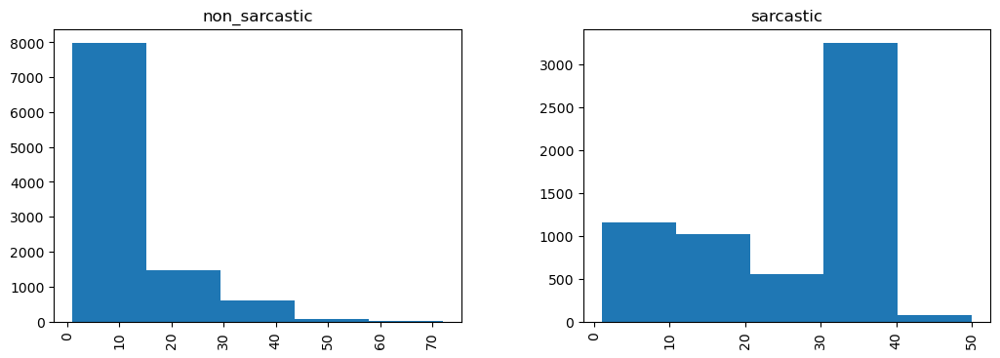

In [92]:
df.hist(column = 'word_count', by ='label',figsize=(12,4), bins = 5)

In [93]:
import collections
corpus_list =[]
for i in range(len(df)):
    corpus_list +=df['text'][i]
counter=collections.Counter(corpus_list)
print(counter)

Counter({'.': 26957, '1': 10889, ',': 10422, 'नेहरू': 6695, '!': 5524, '': 5205, 'लेते': 4775, '।': 4027, '-': 2851, 'शी': 2710, '(': 2610, ')': 2606, 'अगर': 2517, 'मास्टर': 2460, 'सिगरेट': 2410, 'बीवी': 2390, 'किताब': 2390, 'वश': 2385, 'जिनपिंग': 2380, 'पटाकर': 2380, 'पिलाकर': 2380, 'तिब्बत': 2380, 'सीधे': 2380, 'शंघाई': 2380, 'कब्जा': 2380, 'इश्क़': 2380, 'जंग': 2380, 'जायज़': 2380, 'द': 2380, 'ठरकी': 2380, 'कांग्रेस': 2310, 'एडविना': 2230, 'आक': 2230, 'थू': 2230, 'जय': 2200, '💦💦1': 2190, '"': 1940, 'वो': 1775, 'स्कूल': 1640, 'हमारे': 1455, 'w': 1268, 'चला': 975, '/': 955, 'बस': 935, 'मंत्री': 935, 'सरकार': 930, 'पता': 890, 'v': 873, 'बच्चों': 865, 'आने': 855, 'बेटे': 855, 'रहते': 845, 'बड़ा': 839, 'गांव': 825, 'मोहल्ले': 820, 'भतीजे': 820, 'कैंटीन': 820, 'भांजे': 820, 'पढ़ाने': 820, 'रिश्तेदार': 820, 'पिता': 815, 'चीन': 808, 'हरे': 735, 'देता': 655, '*': 630, 'क्या': 571, 'अब': 561, 'लोग': 560, 'z': 555, 'खत्म': 555, 'दिल्ली': 525, 'जिंदगी': 525, 'है1': 516, 'कोरोना': 476, 'कृष्ण': 

In [95]:
to_remove = ['नेहरू', 'लेते', 'कटाक्ष', 'जय', 'शी', 'अगर', 'मास्टर', 'वो', 'सिगरेट', 'बीवी', 'इश्क़', 'किताब', 'वश', 'पटाकर', 'पिलाकर','.','!','1']
for i in range(len(df)):
    df['text'][i]=[ele for ele in df['text'][i] if ele not in (to_remove)]
count_length()

C:\Users\muska\AppData\Local\Temp\ipykernel_20764\418683405.py:3: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df['text'][i]=[ele for ele in df['text'][i] if ele not in (to_remove)]
C:\Users\muska\AppData\Local\Temp\ipykernel_20764\418683405.py:3: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df['text'][i]=[ele for ele in df['text'][i] if ele not in (to_remove)]
C:\Users\muska\AppData\Local\Temp\ipykernel_20764\418683405.py:3: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing

C:\Users\muska\AppData\Local\Temp\ipykernel_20764\418683405.py:3: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df['text'][i]=[ele for ele in df['text'][i] if ele not in (to_remove)]
C:\Users\muska\AppData\Local\Temp\ipykernel_20764\418683405.py:3: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df['text'][i]=[ele for ele in df['text'][i] if ele not in (to_remove)]
C:\Users\muska\AppData\Local\Temp\ipykernel_20764\418683405.py:3: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing

C:\Users\muska\AppData\Local\Temp\ipykernel_20764\418683405.py:3: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df['text'][i]=[ele for ele in df['text'][i] if ele not in (to_remove)]
C:\Users\muska\AppData\Local\Temp\ipykernel_20764\418683405.py:3: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df['text'][i]=[ele for ele in df['text'][i] if ele not in (to_remove)]
C:\Users\muska\AppData\Local\Temp\ipykernel_20764\418683405.py:3: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing

C:\Users\muska\AppData\Local\Temp\ipykernel_20764\418683405.py:3: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df['text'][i]=[ele for ele in df['text'][i] if ele not in (to_remove)]
C:\Users\muska\AppData\Local\Temp\ipykernel_20764\418683405.py:3: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df['text'][i]=[ele for ele in df['text'][i] if ele not in (to_remove)]
C:\Users\muska\AppData\Local\Temp\ipykernel_20764\418683405.py:3: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing

C:\Users\muska\AppData\Local\Temp\ipykernel_20764\418683405.py:3: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df['text'][i]=[ele for ele in df['text'][i] if ele not in (to_remove)]
C:\Users\muska\AppData\Local\Temp\ipykernel_20764\418683405.py:3: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df['text'][i]=[ele for ele in df['text'][i] if ele not in (to_remove)]
C:\Users\muska\AppData\Local\Temp\ipykernel_20764\418683405.py:3: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing

C:\Users\muska\AppData\Local\Temp\ipykernel_20764\418683405.py:3: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df['text'][i]=[ele for ele in df['text'][i] if ele not in (to_remove)]
C:\Users\muska\AppData\Local\Temp\ipykernel_20764\418683405.py:3: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df['text'][i]=[ele for ele in df['text'][i] if ele not in (to_remove)]
C:\Users\muska\AppData\Local\Temp\ipykernel_20764\418683405.py:3: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing

C:\Users\muska\AppData\Local\Temp\ipykernel_20764\418683405.py:3: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df['text'][i]=[ele for ele in df['text'][i] if ele not in (to_remove)]
C:\Users\muska\AppData\Local\Temp\ipykernel_20764\418683405.py:3: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df['text'][i]=[ele for ele in df['text'][i] if ele not in (to_remove)]
C:\Users\muska\AppData\Local\Temp\ipykernel_20764\418683405.py:3: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing

C:\Users\muska\AppData\Local\Temp\ipykernel_20764\418683405.py:3: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df['text'][i]=[ele for ele in df['text'][i] if ele not in (to_remove)]
C:\Users\muska\AppData\Local\Temp\ipykernel_20764\418683405.py:3: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df['text'][i]=[ele for ele in df['text'][i] if ele not in (to_remove)]
C:\Users\muska\AppData\Local\Temp\ipykernel_20764\418683405.py:3: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing

C:\Users\muska\AppData\Local\Temp\ipykernel_20764\418683405.py:3: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df['text'][i]=[ele for ele in df['text'][i] if ele not in (to_remove)]
C:\Users\muska\AppData\Local\Temp\ipykernel_20764\418683405.py:3: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df['text'][i]=[ele for ele in df['text'][i] if ele not in (to_remove)]
C:\Users\muska\AppData\Local\Temp\ipykernel_20764\418683405.py:3: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing

C:\Users\muska\AppData\Local\Temp\ipykernel_20764\418683405.py:3: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df['text'][i]=[ele for ele in df['text'][i] if ele not in (to_remove)]
C:\Users\muska\AppData\Local\Temp\ipykernel_20764\418683405.py:3: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df['text'][i]=[ele for ele in df['text'][i] if ele not in (to_remove)]
C:\Users\muska\AppData\Local\Temp\ipykernel_20764\418683405.py:3: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing

IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.

Current values:
NotebookApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
NotebookApp.rate_limit_window=3.0 (secs)

C:\Users\muska\AppData\Local\Temp\ipykernel_20764\418683405.py:3: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df['text'][i]=[ele for ele in df['text'][i] if ele not in (to_remove)]
C:\Users\muska\AppData\Local\Temp\ipykernel_20764\418683405.py:3: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[

C:\Users\muska\AppData\Local\Temp\ipykernel_20764\418683405.py:3: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df['text'][i]=[ele for ele in df['text'][i] if ele not in (to_remove)]
C:\Users\muska\AppData\Local\Temp\ipykernel_20764\418683405.py:3: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df['text'][i]=[ele for ele in df['text'][i] if ele not in (to_remove)]
C:\Users\muska\AppData\Local\Temp\ipykernel_20764\418683405.py:3: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing

C:\Users\muska\AppData\Local\Temp\ipykernel_20764\418683405.py:3: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df['text'][i]=[ele for ele in df['text'][i] if ele not in (to_remove)]
C:\Users\muska\AppData\Local\Temp\ipykernel_20764\418683405.py:3: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df['text'][i]=[ele for ele in df['text'][i] if ele not in (to_remove)]
C:\Users\muska\AppData\Local\Temp\ipykernel_20764\418683405.py:3: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing

C:\Users\muska\AppData\Local\Temp\ipykernel_20764\418683405.py:3: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df['text'][i]=[ele for ele in df['text'][i] if ele not in (to_remove)]
C:\Users\muska\AppData\Local\Temp\ipykernel_20764\418683405.py:3: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df['text'][i]=[ele for ele in df['text'][i] if ele not in (to_remove)]
C:\Users\muska\AppData\Local\Temp\ipykernel_20764\418683405.py:3: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing

C:\Users\muska\AppData\Local\Temp\ipykernel_20764\418683405.py:3: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df['text'][i]=[ele for ele in df['text'][i] if ele not in (to_remove)]
C:\Users\muska\AppData\Local\Temp\ipykernel_20764\418683405.py:3: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df['text'][i]=[ele for ele in df['text'][i] if ele not in (to_remove)]
C:\Users\muska\AppData\Local\Temp\ipykernel_20764\418683405.py:3: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing

C:\Users\muska\AppData\Local\Temp\ipykernel_20764\418683405.py:3: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df['text'][i]=[ele for ele in df['text'][i] if ele not in (to_remove)]
C:\Users\muska\AppData\Local\Temp\ipykernel_20764\418683405.py:3: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df['text'][i]=[ele for ele in df['text'][i] if ele not in (to_remove)]
C:\Users\muska\AppData\Local\Temp\ipykernel_20764\418683405.py:3: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing

C:\Users\muska\AppData\Local\Temp\ipykernel_20764\418683405.py:3: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df['text'][i]=[ele for ele in df['text'][i] if ele not in (to_remove)]
C:\Users\muska\AppData\Local\Temp\ipykernel_20764\418683405.py:3: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df['text'][i]=[ele for ele in df['text'][i] if ele not in (to_remove)]
C:\Users\muska\AppData\Local\Temp\ipykernel_20764\418683405.py:3: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing

C:\Users\muska\AppData\Local\Temp\ipykernel_20764\418683405.py:3: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df['text'][i]=[ele for ele in df['text'][i] if ele not in (to_remove)]
C:\Users\muska\AppData\Local\Temp\ipykernel_20764\418683405.py:3: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df['text'][i]=[ele for ele in df['text'][i] if ele not in (to_remove)]
C:\Users\muska\AppData\Local\Temp\ipykernel_20764\418683405.py:3: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing

In [96]:
least_common= [word for word, word_count in collections.Counter(corpus_list).most_common()[:-50:-1]]
for i in range(len(df)):
    df['text'][i]=[ele for ele in df['text'][i] if ele not in (least_common)]

C:\Users\muska\AppData\Local\Temp\ipykernel_20764\3728083620.py:3: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df['text'][i]=[ele for ele in df['text'][i] if ele not in (least_common)]
C:\Users\muska\AppData\Local\Temp\ipykernel_20764\3728083620.py:3: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df['text'][i]=[ele for ele in df['text'][i] if ele not in (least_common)]
C:\Users\muska\AppData\Local\Temp\ipykernel_20764\3728083620.py:3: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide

C:\Users\muska\AppData\Local\Temp\ipykernel_20764\3728083620.py:3: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df['text'][i]=[ele for ele in df['text'][i] if ele not in (least_common)]
C:\Users\muska\AppData\Local\Temp\ipykernel_20764\3728083620.py:3: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df['text'][i]=[ele for ele in df['text'][i] if ele not in (least_common)]
C:\Users\muska\AppData\Local\Temp\ipykernel_20764\3728083620.py:3: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide

C:\Users\muska\AppData\Local\Temp\ipykernel_20764\3728083620.py:3: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df['text'][i]=[ele for ele in df['text'][i] if ele not in (least_common)]
C:\Users\muska\AppData\Local\Temp\ipykernel_20764\3728083620.py:3: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df['text'][i]=[ele for ele in df['text'][i] if ele not in (least_common)]
C:\Users\muska\AppData\Local\Temp\ipykernel_20764\3728083620.py:3: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide

C:\Users\muska\AppData\Local\Temp\ipykernel_20764\3728083620.py:3: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df['text'][i]=[ele for ele in df['text'][i] if ele not in (least_common)]
C:\Users\muska\AppData\Local\Temp\ipykernel_20764\3728083620.py:3: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df['text'][i]=[ele for ele in df['text'][i] if ele not in (least_common)]
C:\Users\muska\AppData\Local\Temp\ipykernel_20764\3728083620.py:3: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide

C:\Users\muska\AppData\Local\Temp\ipykernel_20764\3728083620.py:3: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df['text'][i]=[ele for ele in df['text'][i] if ele not in (least_common)]
C:\Users\muska\AppData\Local\Temp\ipykernel_20764\3728083620.py:3: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df['text'][i]=[ele for ele in df['text'][i] if ele not in (least_common)]
C:\Users\muska\AppData\Local\Temp\ipykernel_20764\3728083620.py:3: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide

C:\Users\muska\AppData\Local\Temp\ipykernel_20764\3728083620.py:3: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df['text'][i]=[ele for ele in df['text'][i] if ele not in (least_common)]
C:\Users\muska\AppData\Local\Temp\ipykernel_20764\3728083620.py:3: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df['text'][i]=[ele for ele in df['text'][i] if ele not in (least_common)]
C:\Users\muska\AppData\Local\Temp\ipykernel_20764\3728083620.py:3: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide

C:\Users\muska\AppData\Local\Temp\ipykernel_20764\3728083620.py:3: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df['text'][i]=[ele for ele in df['text'][i] if ele not in (least_common)]
C:\Users\muska\AppData\Local\Temp\ipykernel_20764\3728083620.py:3: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df['text'][i]=[ele for ele in df['text'][i] if ele not in (least_common)]
C:\Users\muska\AppData\Local\Temp\ipykernel_20764\3728083620.py:3: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide

C:\Users\muska\AppData\Local\Temp\ipykernel_20764\3728083620.py:3: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df['text'][i]=[ele for ele in df['text'][i] if ele not in (least_common)]
C:\Users\muska\AppData\Local\Temp\ipykernel_20764\3728083620.py:3: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df['text'][i]=[ele for ele in df['text'][i] if ele not in (least_common)]
C:\Users\muska\AppData\Local\Temp\ipykernel_20764\3728083620.py:3: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide

C:\Users\muska\AppData\Local\Temp\ipykernel_20764\3728083620.py:3: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df['text'][i]=[ele for ele in df['text'][i] if ele not in (least_common)]
C:\Users\muska\AppData\Local\Temp\ipykernel_20764\3728083620.py:3: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df['text'][i]=[ele for ele in df['text'][i] if ele not in (least_common)]
C:\Users\muska\AppData\Local\Temp\ipykernel_20764\3728083620.py:3: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide

C:\Users\muska\AppData\Local\Temp\ipykernel_20764\3728083620.py:3: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df['text'][i]=[ele for ele in df['text'][i] if ele not in (least_common)]
C:\Users\muska\AppData\Local\Temp\ipykernel_20764\3728083620.py:3: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df['text'][i]=[ele for ele in df['text'][i] if ele not in (least_common)]
C:\Users\muska\AppData\Local\Temp\ipykernel_20764\3728083620.py:3: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide

C:\Users\muska\AppData\Local\Temp\ipykernel_20764\3728083620.py:3: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df['text'][i]=[ele for ele in df['text'][i] if ele not in (least_common)]
C:\Users\muska\AppData\Local\Temp\ipykernel_20764\3728083620.py:3: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df['text'][i]=[ele for ele in df['text'][i] if ele not in (least_common)]
C:\Users\muska\AppData\Local\Temp\ipykernel_20764\3728083620.py:3: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide

C:\Users\muska\AppData\Local\Temp\ipykernel_20764\3728083620.py:3: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df['text'][i]=[ele for ele in df['text'][i] if ele not in (least_common)]
C:\Users\muska\AppData\Local\Temp\ipykernel_20764\3728083620.py:3: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df['text'][i]=[ele for ele in df['text'][i] if ele not in (least_common)]
C:\Users\muska\AppData\Local\Temp\ipykernel_20764\3728083620.py:3: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide

C:\Users\muska\AppData\Local\Temp\ipykernel_20764\3728083620.py:3: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df['text'][i]=[ele for ele in df['text'][i] if ele not in (least_common)]
C:\Users\muska\AppData\Local\Temp\ipykernel_20764\3728083620.py:3: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df['text'][i]=[ele for ele in df['text'][i] if ele not in (least_common)]
C:\Users\muska\AppData\Local\Temp\ipykernel_20764\3728083620.py:3: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide

C:\Users\muska\AppData\Local\Temp\ipykernel_20764\3728083620.py:3: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df['text'][i]=[ele for ele in df['text'][i] if ele not in (least_common)]
C:\Users\muska\AppData\Local\Temp\ipykernel_20764\3728083620.py:3: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df['text'][i]=[ele for ele in df['text'][i] if ele not in (least_common)]
C:\Users\muska\AppData\Local\Temp\ipykernel_20764\3728083620.py:3: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide

C:\Users\muska\AppData\Local\Temp\ipykernel_20764\3728083620.py:3: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df['text'][i]=[ele for ele in df['text'][i] if ele not in (least_common)]
C:\Users\muska\AppData\Local\Temp\ipykernel_20764\3728083620.py:3: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df['text'][i]=[ele for ele in df['text'][i] if ele not in (least_common)]
C:\Users\muska\AppData\Local\Temp\ipykernel_20764\3728083620.py:3: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide

IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.

Current values:
NotebookApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
NotebookApp.rate_limit_window=3.0 (secs)

C:\Users\muska\AppData\Local\Temp\ipykernel_20764\3728083620.py:3: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df['text'][i]=[ele for ele in df['text'][i] if ele not in (least_common)]
C:\Users\muska\AppData\Local\Temp\ipykernel_20764\3728083620.py:3: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy


C:\Users\muska\AppData\Local\Temp\ipykernel_20764\3728083620.py:3: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df['text'][i]=[ele for ele in df['text'][i] if ele not in (least_common)]
C:\Users\muska\AppData\Local\Temp\ipykernel_20764\3728083620.py:3: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df['text'][i]=[ele for ele in df['text'][i] if ele not in (least_common)]
C:\Users\muska\AppData\Local\Temp\ipykernel_20764\3728083620.py:3: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide

C:\Users\muska\AppData\Local\Temp\ipykernel_20764\3728083620.py:3: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df['text'][i]=[ele for ele in df['text'][i] if ele not in (least_common)]
C:\Users\muska\AppData\Local\Temp\ipykernel_20764\3728083620.py:3: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df['text'][i]=[ele for ele in df['text'][i] if ele not in (least_common)]
C:\Users\muska\AppData\Local\Temp\ipykernel_20764\3728083620.py:3: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide

C:\Users\muska\AppData\Local\Temp\ipykernel_20764\3728083620.py:3: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df['text'][i]=[ele for ele in df['text'][i] if ele not in (least_common)]
C:\Users\muska\AppData\Local\Temp\ipykernel_20764\3728083620.py:3: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df['text'][i]=[ele for ele in df['text'][i] if ele not in (least_common)]
C:\Users\muska\AppData\Local\Temp\ipykernel_20764\3728083620.py:3: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide

C:\Users\muska\AppData\Local\Temp\ipykernel_20764\3728083620.py:3: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df['text'][i]=[ele for ele in df['text'][i] if ele not in (least_common)]
C:\Users\muska\AppData\Local\Temp\ipykernel_20764\3728083620.py:3: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df['text'][i]=[ele for ele in df['text'][i] if ele not in (least_common)]
C:\Users\muska\AppData\Local\Temp\ipykernel_20764\3728083620.py:3: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide

C:\Users\muska\AppData\Local\Temp\ipykernel_20764\3728083620.py:3: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df['text'][i]=[ele for ele in df['text'][i] if ele not in (least_common)]
C:\Users\muska\AppData\Local\Temp\ipykernel_20764\3728083620.py:3: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df['text'][i]=[ele for ele in df['text'][i] if ele not in (least_common)]
C:\Users\muska\AppData\Local\Temp\ipykernel_20764\3728083620.py:3: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide

C:\Users\muska\AppData\Local\Temp\ipykernel_20764\3728083620.py:3: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df['text'][i]=[ele for ele in df['text'][i] if ele not in (least_common)]
C:\Users\muska\AppData\Local\Temp\ipykernel_20764\3728083620.py:3: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df['text'][i]=[ele for ele in df['text'][i] if ele not in (least_common)]
C:\Users\muska\AppData\Local\Temp\ipykernel_20764\3728083620.py:3: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide

C:\Users\muska\AppData\Local\Temp\ipykernel_20764\3728083620.py:3: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df['text'][i]=[ele for ele in df['text'][i] if ele not in (least_common)]
C:\Users\muska\AppData\Local\Temp\ipykernel_20764\3728083620.py:3: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df['text'][i]=[ele for ele in df['text'][i] if ele not in (least_common)]
C:\Users\muska\AppData\Local\Temp\ipykernel_20764\3728083620.py:3: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide

C:\Users\muska\AppData\Local\Temp\ipykernel_20764\3728083620.py:3: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df['text'][i]=[ele for ele in df['text'][i] if ele not in (least_common)]
C:\Users\muska\AppData\Local\Temp\ipykernel_20764\3728083620.py:3: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df['text'][i]=[ele for ele in df['text'][i] if ele not in (least_common)]
C:\Users\muska\AppData\Local\Temp\ipykernel_20764\3728083620.py:3: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide

C:\Users\muska\AppData\Local\Temp\ipykernel_20764\3728083620.py:3: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df['text'][i]=[ele for ele in df['text'][i] if ele not in (least_common)]
C:\Users\muska\AppData\Local\Temp\ipykernel_20764\3728083620.py:3: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df['text'][i]=[ele for ele in df['text'][i] if ele not in (least_common)]
C:\Users\muska\AppData\Local\Temp\ipykernel_20764\3728083620.py:3: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide

array([<Axes: title={'center': 'non_sarcastic'}>,
       <Axes: title={'center': 'sarcastic'}>], dtype=object)

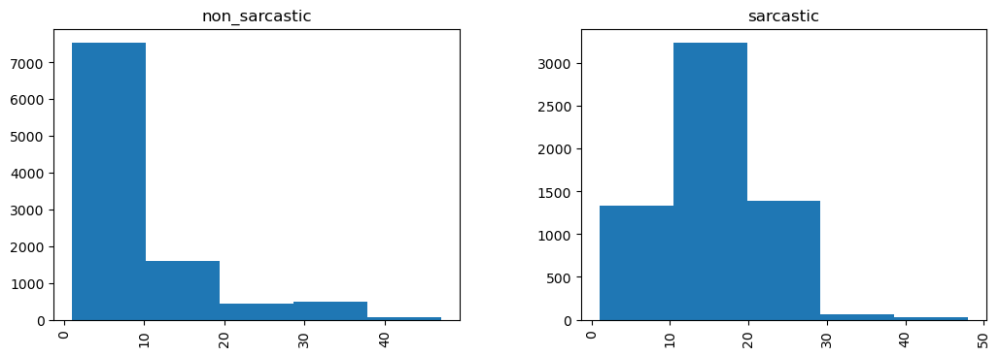

In [98]:
df.hist(column = 'word_count', by ='label',figsize=(12,4), bins = 5)

In [100]:
df['label'] = df['label'].map({'sarcastic':0,'non_sarcastic':1})

C:\Users\muska\AppData\Local\Temp\ipykernel_20764\1333091658.py:1: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df['label'] = df['label'].map({'sarcastic':0,'non_sarcastic':1})


In [129]:
X_train, X_test, y_train, y_test = train_test_split(df[['text','word_count']], df['label'], random_state=0)

In [130]:
print(X_train.shape,X_test.shape)

(9003, 2) (3002, 2)


In [3]:
X_train

NameError: name 'X_train' is not defined

# Model

In [141]:
from transformers import DistilBertTokenizer, TFDistilBertModel
import tensorflow as tf

tokenizer = DistilBertTokenizer.from_pretrained("distilbert-base-uncased")
model = TFDistilBertModel.from_pretrained("distilbert-base-uncased")


Some weights of the PyTorch model were not used when initializing the TF 2.0 model TFDistilBertModel: ['vocab_transform.weight', 'vocab_layer_norm.bias', 'vocab_layer_norm.weight', 'vocab_projector.bias', 'vocab_transform.bias']
- This IS expected if you are initializing TFDistilBertModel from a PyTorch model trained on another task or with another architecture (e.g. initializing a TFBertForSequenceClassification model from a BertForPreTraining model).
- This IS NOT expected if you are initializing TFDistilBertModel from a PyTorch model that you expect to be exactly identical (e.g. initializing a TFBertForSequenceClassification model from a BertForSequenceClassification model).
All the weights of TFDistilBertModel were initialized from the PyTorch model.
If your task is similar to the task the model of the checkpoint was trained on, you can already use TFDistilBertModel for predictions without further training.


In [ ]:
X_train_inputs = []
for i in X_train['text']:
    temp = tokenizer(i, return_tensors="np",add_special_tokens = True, max_length =300,padding = 'max_length',truncation=True)
    X_train_inputs.append(model(temp)[0][:, 0, :])  
    print(i)
X_test_inputs = []
for i in X_test['text']:
    temp = tokenizer(i, return_tensors="np",add_special_tokens = True, max_length =300,padding = 'max_length',truncation=True)
    X_test_inputs.append(model(temp)[0][:, 0, :])   

['🙏🌹ॐ', 'नम', 'शिवाय🌹🙏हरहरमहादेव', 'जयगणेशाय🌷🌷1']
['बिल्कुल', 'सही', 'v', 'सर🙏जीवित', 'रहकर', 'कम', 'कम', 'हालातों', 'बदल', 'पाएंगे', ',', ',', ',', 'मरने', 'खत्म😞पर', 'ऐसी', 'मौते', 'सवाल', 'छोड़', 'जाती', 'सबक', 'सवाल', 'इतनी', 'चकाचौंध', ',', 'इतनी', 'भीड़', 'इंसान', 'अकेला', 'क्यों', 'सबक', 'जिंदगी', 'बड़ी', 'जरूरत']
['जिनपिंग', 'एडविना', ',', 'तिब्बत', 'सीधे', 'शंघाई', 'कब्जा', 'जंग', 'जायज़', '(', 'द', 'ठरकी', ')', 'कांग्रेस', 'आक', 'थू', '💦💦1']
['दिल्ली', 'स्वास्थ्य', 'मंत्री', 'yको', 'दिल्ली', 'सरकारी', 'अस्पताल', 'निकाल', 'दिल्ली', 'प्राइवेट', 'अस्पताल', 'भर्ती', 'कराया', 'हैइतने', 'दिल्लीवाले', 'बोल', 'vw', 'दिल्ली', 'हेल्थ', 'सेक्टर', 'वर्ल्ड', 'क्लास', 'बनाया']
['भारतीय', 'राष्ट्रीय', 'कांग्रेस', 'पूर्व', 'अध्यक्ष', ',', 'लोकसभा', 'सांसद', 'जननायक', 'नेता']
['इतना', 'क्यों', 'सिखाए', 'जिंदगी', 'हमें', 'सी', 'सदियाँ', 'गुजांरनी', '।', 'गुलज़ार', 'zz']
['खत्म', 'ख्वाहिशों', 'हमारे', 'सपनों', 'सजाता', ',', 'पिता', 'खुद', 'पीछे', 'रहकर', 'हमें', 'बढ़ाता', ',', 'कुर्बान', 'देता'

['चलो', 'अन्तर्राष्ट्रीय', 'योग', 'दिवस', 'मनाये', ',', 'पूरे', 'विश्व', 'योग', 'कराये']
['वाकई', 'कभी', '-', 'कभी', 'ज़िन्दगी', 'सोच', 'समझ', 'दायरे', 'दूर', 'सी', 'लगती', '।', 'बेहद', 'दुःखद', '🙏💐😥1']
['चुभ', 'जाती', 'बात', 'कभी', ',', 'कभी', 'लहज़े', 'मार', 'जाते', ',', 'ज़िंदगी', 'साहब', ',', 'गैरों', 'ज़्यादा', 'अपनों', 'हार', 'जाते', '']
['खुद', 'जाऊंगा', '"', 'तुम्हे', 'कभी', 'नही', 'दूंगा', '😔वोह', 'लफ्ज़']
['क्या', 'काँग्रेसियो', 'खिलौने', 'सर्विसिंग', 'चाइना', '😂😂', '#']
['बेटियों', 'बाप', 'क्या', 'सिर्फ', 'बेटियां', 'समझ', 'सकती', 'हैं1']
['चीन', 'मुद्दे', 'ओवैसी', 'इतना', 'गुस्से', ',', '"', 'पिंग', '"', 'मिनट', 'चीनी', 'आर्मी', '/', 'पुलिस', 'हटाने', 'कह', ',', 'पूरे', 'चीन', 'खत्म', 'देगा']
['जिनपिंग', 'एडविना', ',', 'तिब्बत', 'सीधे', 'शंघाई', 'कब्जा', 'जंग', 'जायज़', '(', 'द', 'ठरकी', ')', 'कांग्रेस', 'आक', 'थू', '💦💦1']
['चाय', ',', 'हमसफर', ',', 'फिलहाल', 'चाय', '।']
['चीन', 'मुद्दे', 'ओवैसी', 'इतना', 'गुस्से', ',', '"', 'पिंग', '"', 'मिनट', 'चीनी', 'आर्मी', '/', 'पुलिस

['अब', 'त़ो', 'बेरोजगार', 'योग्य', 'युवाओं', 'मानसिक', 'प्रताड़ना', 'मुक्ति', 'दिजिए', ',', 'कहीं', 'लोग', 'टूट', 'जाए', 'सुशांत']
['😂😙🔥', '', '', '', '', '', '😂😂😂🔥', '', '#']
['जिनपिंग', 'एडविना', ',', 'तिब्बत', 'सीधे', 'शंघाई', 'कब्जा', 'जंग', 'जायज़', '(', 'द', 'ठरकी', ')', 'कांग्रेस', 'आक', 'थू', '💦💦1']
['चीन', 'मुद्दे', 'ओवैसी', 'इतना', 'गुस्से', ',', '"', 'पिंग', '"', 'मिनट', 'चीनी', 'आर्मी', '/', 'पुलिस', 'हटाने', 'कह', ',', 'पूरे', 'चीन', 'खत्म', 'देगा']
['w', '🙂']
['"', 'पत्थर', '"', 'हूँ', ',', 'माता', '-', 'पिता', '"', 'शिल्पकार', '"', 'हर', '"', 'तारीफ़', '"', 'असली', '"', 'हक़दार', '']
['v', 'सही', 'आपने', 'नम्बर']
['zy', '-', 'w', '#']
['/', '/', '/', 'v', 'नेता', 'प्रतिपक्ष', 'गुलाबचंद', 'कटारिया', 'पहुंचे', 'बीजेपी', 'मुख्यालय', ',', 'राज्यसभा', 'चुनावों', 'लेकर', 'सरगर्मियां']
['जिनपिंग', 'एडविना', ',', 'तिब्बत', 'सीधे', 'शंघाई', 'कब्जा', 'जंग', 'जायज़', '(', 'द', 'ठरकी', ')', 'कांग्रेस', 'आक', 'थू', '💦💦1']
['हमारे', 'गांव', 'रहते', ',', 'मोहल्ले', 'बच्चों', 'स्कूल', '

['लफज', 'सादा', 'इतने', 'प्यारे', 'हमारे', 'हो—', '-', 'तुम्हारे']
['जिनपिंग', 'एडविना', ',', 'तिब्बत', 'सीधे', 'शंघाई', 'कब्जा', 'जंग', 'जायज़', '(', 'द', 'ठरकी', ')', 'कांग्रेस', 'आक', 'थू', '💦💦1']
['आशिकों', 'बस्ती', 'टूटा', 'मकान', 'किसका', ',', ',', 'कहीं', 'दिल', 'कहीं', 'जान', 'बिखरा', 'सामान', 'किसका', ',', ',']
['जिनपिंग', 'एडविना', ',', 'तिब्बत', 'सीधे', 'शंघाई', 'कब्जा', 'जंग', 'जायज़', '(', 'द', 'ठरकी', ')', 'कांग्रेस', 'आक', 'थू', '💦💦1']
['z', '', 'vy']
['बिना', 'पल', 'गवारा', ',', 'पिता', 'साथी', ',', 'पिता', 'सहारा', ',', 'पिता', 'खुशियों', 'पिटारा', '।']
['चेहरे', 'मुस्कराहट', 'वजह', 'बनें', ',']
['हमारे', 'गांव', 'रहते', ',', 'मोहल्ले', 'बच्चों', 'स्कूल', 'आने', '।', 'बड़ा', 'पता', 'चला', '-', 'स्कूल', 'बेटे', ',', 'बस', 'भतीजे', ',', 'कैंटीन', 'भांजे', 'पढ़ाने', 'रिश्तेदार', 'सरकार', 'मंत्री']
['पल', 'आपको']
['जिनपिंग', 'एडविना', ',', 'तिब्बत', 'सीधे', 'शंघाई', 'कब्जा', 'जंग', 'जायज़', '(', 'द', 'ठरकी', ')', 'कांग्रेस', 'आक', 'थू', '💦💦1']
['🙏🌹ॐ', 'नम', 'शिवाय🌹🙏हरहरमहा

['हमारे', 'लाडले', ',', 'छोटे', 'बेटे', '"', 'अद्विक', 'तिवारी', '"', 'शुभ', 'जन्मदिन', ',', 'शुभ', 'साल', '।', 'मित्रो', ',', 'वरिष्ठों', 'अनुरोध', ',', 'शुभ', 'जीवन', 'तिजोरी', 'शुभाशीष', ',', 'आशीर्वाद', 'रूपी', 'धन', 'देवें', 'क्योकि', 'धन', 'जीवन', 'भर', 'काम', 'आयेगा', '।']
['बिल्कुल', 'सही', 'v', 'सर🙏जीवित', 'रहकर', 'कम', 'कम', 'हालातों', 'बदल', 'पाएंगे', ',', ',', ',', 'मरने', 'खत्म😞पर', 'ऐसी', 'मौते', 'सवाल', 'छोड़', 'जाती', 'सबक', 'सवाल', 'इतनी', 'चकाचौंध', ',', 'इतनी', 'भीड़', 'इंसान', 'अकेला', 'क्यों', 'सबक', 'जिंदगी', 'बड़ी', 'जरूरत']
['लाई', 'मक़ाम', 'ज़िंदगी', 'मुझे…महसूस', 'ख़ुद', 'कमी', 'मुझे…1']
['जिनपिंग', 'एडविना', ',', 'तिब्बत', 'सीधे', 'शंघाई', 'कब्जा', 'जंग', 'जायज़', '(', 'द', 'ठरकी', ')', 'कांग्रेस', 'आक', 'थू', '💦💦1']
['दिल', 'आवाज़', 'आवाज़', 'मिलाते', 'रहिए', 'जागते', 'रहिए', 'ज़माने', 'जगाते', 'रहिए', '', '-', 'हफ़ीज़', 'बनारसी']
['याद', 'रोते', 'याद', 'मुस्कुराया', 'करो', 'कभी']
['समयनुसार', 'बिहार', 'चुनाव', 'राजद', '+', 'कांग्रेस', 'बुरी', 'हार', '।', 'v

['जिनपिंग', 'एडविना', ',', 'तिब्बत', 'सीधे', 'शंघाई', 'कब्जा', 'जंग', 'जायज़', '(', 'द', 'ठरकी', ')', 'कांग्रेस', 'आक', 'थू', '💦💦1']
['चीन', 'मुद्दे', 'ओवैसी', 'इतना', 'गुस्से', ',', '"', 'पिंग', '"', 'मिनट', 'चीनी', 'आर्मी', '/', 'पुलिस', 'हटाने', 'कह', ',', 'पूरे', 'चीन', 'खत्म', 'देगा']
['जिनपिंग', 'एडविना', ',', 'तिब्बत', 'सीधे', 'शंघाई', 'कब्जा', 'जंग', 'जायज़', '(', 'द', 'ठरकी', ')', 'कांग्रेस', 'आक', 'थू', '💦💦1']
['w', 'लहरू', 'जिनपिंग', 'ऐडविना', ',', 'तिब्बत', 'सीधे', 'शंघाई', 'कब्जा', 'जंग', 'जायज़', '(', 'लहरू', 'द', 'ठरकी', 'लहरू', ')']
['तुम्हारा', 'कितने', 'नेता']
['हमारे', 'गांव', 'रहते', ',', 'मोहल्ले', 'बच्चों', 'स्कूल', 'आने', '।', 'बड़ा', 'पता', 'चला', '-', 'स्कूल', 'बेटे', ',', 'बस', 'भतीजे', ',', 'कैंटीन', 'भांजे', 'पढ़ाने', 'रिश्तेदार', 'सरकार', 'मंत्री']
['🤔🤔🤔🤔🤔🤔🤔🤔🤔इतनी', 'नफ़रत', 'कहाँ', 'लाते', 'लोग', 'क्या', 'मिल', 'जाता', 'मरने', 'नही', 'छोड़ते', 'देश', 'ग़म', 'डूबा']
['अजनबी', 'तुम्हारा', 'चला', 'जाना', 'जिंदगी', 'से1']
['जिनपिंग', 'एडविना', ',', 'तिब्बत', '

['w', '(', ')', '🙌', '-', 'राधा', 'माधव', 'मंगल', 'आरती', 'दर्शन🙌हरे', 'कृष्ण', 'हरे', 'कृष्ण', 'कृष्ण', 'कृष्ण', 'हरे', 'हरे', '।', 'हरे', 'राम', 'हरे', 'राम', 'राम', 'राम', 'हरे', 'हरे', '।', '।', '😊1']
['हैँ', 'समाज', 'नियम', 'पिता', 'सदा', 'गम्भीर', ',', 'मन', 'भाव', 'छुपे', 'लाखोँ', ',', 'आँखों', 'नीर', 'बहे']
['w', 'मोदी', 'मुमकिंन', 'चाये', 'पैदल', 'चलना', 'पड़े', 'मजदूर', 'भाइयो', 'आयेगा', 'मोदी', '-', '-', '-', '-', '#']
['जिनपिंग', 'एडविना', ',', 'तिब्बत', 'सीधे', 'शंघाई', 'कब्जा', 'जंग', 'जायज़', '(', 'द', 'ठरकी', ')', 'कांग्रेस', 'आक', 'थू', '💦💦1']
['', '', '-', '(', '-', ')', '', '', '', '', '']
['हमारे', 'गांव', 'रहते', ',', 'मोहल्ले', 'बच्चों', 'स्कूल', 'आने', '।', 'बड़ा', 'पता', 'चला', '-', 'स्कूल', 'बेटे', ',', 'बस', 'भतीजे', ',', 'कैंटीन', 'भांजे', 'पढ़ाने', 'रिश्तेदार', 'सरकार', 'मंत्री']
['-', ',', '~', '(', '🥀', '-', '"', '"', '🤫😼😡🤣😂', '']
['जेब', 'खाली', ',', 'मना', 'देखा', ',', 'मैंने', 'पिता', 'अमीर', ',', 'इंसान', 'देखा']
['दुख', 'सिर्फ']
['शौहरत', 'पिता', 'वजह

['हमारे', 'गांव', 'रहते', ',', 'मोहल्ले', 'बच्चों', 'स्कूल', 'आने', '।', 'बड़ा', 'पता', 'चला', '-', 'स्कूल', 'बेटे', ',', 'बस', 'भतीजे', ',', 'कैंटीन', 'भांजे', 'पढ़ाने', 'रिश्तेदार', 'सरकार', 'मंत्री']
['🤔🤔🤔🤔🤔🤔🤔🤔🤔इतनी', 'नफ़रत', 'कहाँ', 'लाते', 'लोग', 'क्या', 'मिल', 'जाता', 'मरने', 'नही', 'छोड़ते', 'देश', 'ग़म', 'डूबा']
['जिनपिंग', 'एडविना', ',', 'तिब्बत', 'सीधे', 'शंघाई', 'कब्जा', 'जंग', 'जायज़', '(', 'द', 'ठरकी', ')', 'कांग्रेस', 'आक', 'थू', '💦💦1']
['चीन', 'मुद्दे', 'ओवैसी', 'इतना', 'गुस्से', ',', '"', 'पिंग', '"', 'मिनट', 'चीनी', 'आर्मी', '/', 'पुलिस', 'हटाने', 'कह', ',', 'पूरे', 'चीन', 'खत्म', 'देगा']
['🤔🤔🤔🤔🤔🤔🤔🤔🤔इतनी', 'नफ़रत', 'कहाँ', 'लाते', 'लोग', 'क्या', 'मिल', 'जाता', 'मरने', 'नही', 'छोड़ते', 'देश', 'ग़म', 'डूबा']
['चीन', 'मुद्दे', 'ओवैसी', 'इतना', 'गुस्से', ',', '"', 'पिंग', '"', 'मिनट', 'चीनी', 'आर्मी', '/', 'पुलिस', 'हटाने', 'कह', ',', 'पूरे', 'चीन', 'खत्म', 'देगा']
['दुख', 'सिर्फ']
['z', 'z', 'v', '😂1']
['रात', 'गहरी', 'डर', ',', ',', 'बिछड़े', 'सोचा', 'पागल', 'मर', '।', 

['खत्म', 'ख्वाहिशों', 'हमारे', 'सपनों', 'सजाता', ',', 'पिता', 'खुद', 'पीछे', 'रहकर', 'हमें', 'बढ़ाता', ',', 'कुर्बान', 'देता', 'हैसारे', 'सुख', 'हमारे', 'नाम', 'देता', 'हैबेटा', 'मेरा', 'उड़े', 'आसमान', 'मेंये', 'सोचकर', 'पापा', 'पंख', 'नीलाम', 'देता', 'है1']
['रीट', 'भर्ती', 'लेकर', 'सरकार', 'मांग', '/', '/', '/', 'xx', 'v']
['चेहरे', 'मुस्कराहट', 'वजह', 'बनें', ',']
['मोहब्ब्त', 'बेहिसाब', 'जाए', ',', 'समझ', 'जाना', 'किस्मत', '', '#']
['😊😇😊हज़ार', 'गम', 'फितरत', 'नही', 'बदल', ',', 'क्या', 'करूँ', 'आदत', 'मुस्कुराने', 'है1']
['दिखाई', 'बेशक', 'दे', ',', 'शामिल', 'ज़रूर', ',', 'हर', 'खुदकुशी', 'कातिल', 'ज़रूर', '।']
['हमारे', 'गांव', 'रहते', ',', 'मोहल्ले', 'बच्चों', 'स्कूल', 'आने', '।', 'बड़ा', 'पता', 'चला', '-', 'स्कूल', 'बेटे', ',', 'बस', 'भतीजे', ',', 'कैंटीन', 'भांजे', 'पढ़ाने', 'रिश्तेदार', 'सरकार', 'मंत्री']
['कॉफी', 'पीने', 'बहाने', 'बुलाते', 'रहोगेऔर', 'कहीं', 'चाय', 'प्याली', 'पकड़े', 'दिल', 'लुटा', 'आयेगी', '।', '।', '😜1']
['हारने', 'लेकिन1']
['राहुल', 'गांधी', 'जन्मदिन', 'ह

['w', 'लहरू', 'जिनपिंग', 'ऐडविना', ',', 'तिब्बत', 'सीधे', 'शंघाई', 'कब्जा', 'जंग', 'जायज़', '(', 'लहरू', 'द', 'ठरकी', 'लहरू', ')']
['चीन', 'मुद्दे', 'ओवैसी', 'इतना', 'गुस्से', ',', '"', 'पिंग', '"', 'मिनट', 'चीनी', 'आर्मी', '/', 'पुलिस', 'हटाने', 'कह', ',', 'पूरे', 'चीन', 'खत्म', 'देगा']
['शिक्षा', 'क्रांति', 'क्रांतिवीर', 'मनीष', 'सिसोदिया', 'दिल्ली', 'स्वास्थ्य', 'मंत्रालय', 'कार्यभार', 'संभाला', 'कोरोना', 'संक्रमितों', 'नया', 'कीर्तिमान', 'कोरोना', 'मामलों', 'अर्धशतक', 'बना', 'बैठे1']
['काजू', 'बादाम', 'छोड़ो', 'औरधोखा', 'खाओ', 'ज्यदा', 'अकल', 'आएगी']
['v', 'w', 'v', 'v', 'शिक्षा', 'मंत्री']
['अब', 'घरवालों', 'सुबह', 'जल्दी', 'उठानाछोड़', '🌄', '🙃अब', 'जानते', 'बिस्तर', 'उठा', 'दियातो']
['हमारे', 'गांव', 'रहते', ',', 'मोहल्ले', 'बच्चों', 'स्कूल', 'आने', '।', 'बड़ा', 'पता', 'चला', '-', 'स्कूल', 'बेटे', ',', 'बस', 'भतीजे', ',', 'कैंटीन', 'भांजे', 'पढ़ाने', 'रिश्तेदार', 'सरकार', 'मंत्री']
['हारने', 'लेकिन1']
['“', ',', 'w', '”', 'y’', '“', '”', '😅😅😅']
['चीन', 'मुद्दे', 'ओवैसी', 'इतना', 

['🤔🤔🤔🤔🤔🤔🤔🤔🤔इतनी', 'नफ़रत', 'कहाँ', 'लाते', 'लोग', 'क्या', 'मिल', 'जाता', 'मरने', 'नही', 'छोड़ते', 'देश', 'ग़म', 'डूबा']
['हमारे', 'गांव', 'रहते', ',', 'मोहल्ले', 'बच्चों', 'स्कूल', 'आने', '।', 'बड़ा', 'पता', 'चला', '-', 'स्कूल', 'बेटे', ',', 'बस', 'भतीजे', ',', 'कैंटीन', 'भांजे', 'पढ़ाने', 'रिश्तेदार', 'सरकार', 'मंत्री']
['जिनपिंग', 'एडविना', ',', 'तिब्बत', 'सीधे', 'शंघाई', 'कब्जा', 'जंग', 'जायज़', '(', 'द', 'ठरकी', ')', 'कांग्रेस', 'आक', 'थू', '💦💦1']
['vw', 'v', 'w', 'yy', 'v', 'v', 'wv', 'ww', 'v']
['बिल्कुल', 'सही', 'v', 'सर🙏जीवित', 'रहकर', 'कम', 'कम', 'हालातों', 'बदल', 'पाएंगे', ',', ',', ',', 'मरने', 'खत्म😞पर', 'ऐसी', 'मौते', 'सवाल', 'छोड़', 'जाती', 'सबक', 'सवाल', 'इतनी', 'चकाचौंध', ',', 'इतनी', 'भीड़', 'इंसान', 'अकेला', 'क्यों', 'सबक', 'जिंदगी', 'बड़ी', 'जरूरत']
['राजस्थान', 'विश्वविद्यालय', 'आन', 'बान', 'शान', 'वर्तमान', 'छात्र', 'संघ', 'अध्यक्ष', 'छोटी', 'बहिन', 'v', 'जन्मदिन', 'हार्दिक', 'बधाई', 'शुभकामनाएं', '।', '💐💐💐🌹🌹🌹🎂🎂🎂🎁🎁🎁🍫🍫🍫1']
['😭👏दफ़्न', 'नब्ज़', 'जांच', 'लेना', 'साहेब

['जिनपिंग', 'एडविना', ',', 'तिब्बत', 'सीधे', 'शंघाई', 'कब्जा', 'जंग', 'जायज़', '(', 'द', 'ठरकी', ')', 'कांग्रेस', 'आक', 'थू', '💦💦1']
['वक़्त', 'लगता', ',', 'कामों', 'जनाब', '।', 'दर्द', 'सहते', '-', 'सहते', 'मुस्कुराना', 'पड़ता', '।', '।', '', '~', 'यूँ', 'अचानक', 'मरता', '।', 'साज़िश', ',', 'साजिश', '।', '।']
['जिनपिंग', 'एडविना', ',', 'तिब्बत', 'सीधे', 'शंघाई', 'कब्जा', 'जंग', 'जायज़', '(', 'द', 'ठरकी', ')', 'कांग्रेस', 'आक', 'थू', '💦💦1']
['जिनपिंग', 'एडविना', ',', 'तिब्बत', 'सीधे', 'शंघाई', 'कब्जा', 'जंग', 'जायज़', '(', 'द', 'ठरकी', ')', 'कांग्रेस', 'आक', 'थू', '💦💦1']
['गाय', 'पेशाब', 'पीना', 'पुण्य', 'दलित', 'हाथ', 'पानी', 'पीना', 'पाप', 'धर्म', 'भ्रष्ट', 'जाता', '।', 'आखिर', 'क्यों1']
['पिता', 'स्वस्थ', 'रहने', 'योग', 'प्रेरित', '।', 'मां', 'पिता', 'हर', 'इंसान', 'जीवन', 'खास', 'महत्व', '।', 'भले', 'पिता', 'प्यार', 'इजहार', 'बच्चे', 'करे', 'हर', 'पल', 'साये', 'पीछे', 'खड़े', 'होकर', 'सहारा', 'देते', '।']
['', '#']
['w', ',', '', '', '🤣😂🤣']
['हमारे', 'गांव', 'रहते', ',', 'मोहल्ले',

['जिनपिंग', 'एडविना', ',', 'तिब्बत', 'सीधे', 'शंघाई', 'कब्जा', 'जंग', 'जायज़', '(', 'द', 'ठरकी', ')', 'कांग्रेस', 'आक', 'थू', '💦💦1']
['हमारे', 'गांव', 'रहते', ',', 'मोहल्ले', 'बच्चों', 'स्कूल', 'आने', '।', 'बड़ा', 'पता', 'चला', '-', 'स्कूल', 'बेटे', ',', 'बस', 'भतीजे', ',', 'कैंटीन', 'भांजे', 'पढ़ाने', 'रिश्तेदार', 'सरकार', 'मंत्री']
['yv', 'v', 'अजब', 'तनाव', 'माहौल', 'कहें', '', 'चोरों', 'देश', 'दिमक', 'खोखला', 'अब', 'कोइसी', 'मलाल', 'अवसाद', 'भरी', 'जिंदगी', 'कहें']
['जिनपिंग', 'एडविना', ',', 'तिब्बत', 'सीधे', 'शंघाई', 'कब्जा', 'जंग', 'जायज़', '(', 'द', 'ठरकी', ')', 'कांग्रेस', 'आक', 'थू', '💦💦1']
['ट्विटर', 'अच्छा', 'बड़े', 'नेता', 'पत्रकार', 'हीरो', 'नाम', 'इस्तेमाल', 'करके', 'आईडी', 'बना', 'फॉलोवर्स', 'ले', 'लो', 'नाम', 'चिपका', 'ट्रेंड', '।']
['महवा', 'विधायक', 'ओम', 'प्रकाश', 'हुड़ला', 'जन्मदिन', 'हार्दिक', 'शुभकामनाएं', '']
['जिनपिंग', 'एडविना', ',', 'तिब्बत', 'सीधे', 'शंघाई', 'कब्जा', 'जंग', 'जायज़', '(', 'द', 'ठरकी', ')', 'कांग्रेस', 'आक', 'थू', '💦💦1']
['अजनबी', 'तुम्हारा', '

['w', ',', '-', '-', 'z', ',', '', ',', '', '-', 'v', '', '', '', '']
['जिनपिंग', 'एडविना', ',', 'तिब्बत', 'सीधे', 'शंघाई', 'कब्जा', 'जंग', 'जायज़', '(', 'द', 'ठरकी', ')', 'कांग्रेस', 'आक', 'थू', '💦💦1']
['बार', 'अर्जुन', 'कृष्ण', 'कहाइस', 'दीवार', 'ऐसा', 'लिखो', 'ख़ुशी', 'पढूं']
['z', ',', '', '', '-', '', '', '', '', '']
['टूटे', 'कांच', ',', 'चकना', 'चुर', 'गए', ',', 'चुभ', 'जाए', 'कहीं', ',', 'इसलिए', 'दूर', 'गए', '।']
[',', '😇❤1']
['जिनपिंग', 'एडविना', ',', 'तिब्बत', 'सीधे', 'शंघाई', 'कब्जा', 'जंग', 'जायज़', '(', 'द', 'ठरकी', ')', 'कांग्रेस', 'आक', 'थू', '💦💦1']
['लफज', 'सादा', 'इतने', 'प्यारे', 'हमारे', 'हो—', '-', 'तुम्हारे']
['हमारे', 'गांव', 'रहते', ',', 'मोहल्ले', 'बच्चों', 'स्कूल', 'आने', '।', 'बड़ा', 'पता', 'चला', '-', 'स्कूल', 'बेटे', ',', 'बस', 'भतीजे', ',', 'कैंटीन', 'भांजे', 'पढ़ाने', 'रिश्तेदार', 'सरकार', 'मंत्री']
['सुकून', 'कमाना', 'अब', 'ग़ालिबनाम', 'शोहरत', 'मोत', 'मिल', 'जाती', 'है1']
['भूमि', 'तिनका', 'उगता', 'भूमि', 'काँग्रेस', 'बेचैनी', 'समझ', 'परे', '।', 'मोदी',

['तकलीफ', 'किस्मत', 'धोखा', 'दियामेरा', 'यकीन', 'किस्मत', 'नही1']
['भागा', 'भागा', 'पहुँचा', ',', 'आसरा', 'मेरा', ',', 'सुना', ',', 'भगवान', 'दूसरा', 'बसेरा', ',', 'उम्मीद', 'भरी', 'नजर', 'देखा', ',', 'आंसुओं', 'रोक', 'देखा', ',', 'हाथों', 'तप', ',', 'जल', ',', 'लौटा', ',', 'अब', 'क्या', ',', 'ली', 'ख़ुदकुशी']
[',', 'जिनपिंग', 'एडविना', ',', 'तिब्बत', ',', 'सीधे', 'शंघाई', 'कब्जा', 'जंग', 'जायज़', ',', '(', 'द', 'ठरकी', ')', 'आक', 'थू', 'कांग्रेस']
['गाय', 'पेशाब', 'पीना', 'पुण्य', 'दलित', 'हाथ', 'पानी', 'पीना', 'पाप', 'धर्म', 'भ्रष्ट', 'जाता', '।', 'आखिर', 'क्यों1']
['"', 'पत्थर', '"', 'हूँ', ',', 'माता', '-', 'पिता', '"', 'शिल्पकार', '"', 'हर', '"', 'तारीफ़', '"', 'असली', '"', 'हक़दार', '']
['सुकून', 'कमाना', 'अब', 'ग़ालिबनाम', 'शोहरत', 'मोत', 'मिल', 'जाती', 'है1']
[',', 'जिनपिंग', 'एडविना', ',', 'तिब्बत', ',', 'सीधे', 'शंघाई', 'कब्जा', 'जंग', 'जायज़', ',', '(', 'द', 'ठरकी', ')', 'आक', 'थू', 'कांग्रेस']
['लफज', 'सादा', 'इतने', 'प्यारे', 'हमारे', 'हो—', '-', 'तुम्हारे']
['खत्म', 'ख्वा

['पतझड़', 'कहानियाँ', 'सुना', 'उदास', 'ऐ', 'जिंदगी', 'नए', 'मौसम', 'पता', 'बता', ',', 'गुजर', ',', 'गुजर']
['चीन', 'मुद्दे', 'ओवैसी', 'इतना', 'गुस्से', ',', '"', 'पिंग', '"', 'मिनट', 'चीनी', 'आर्मी', '/', 'पुलिस', 'हटाने', 'कह', ',', 'पूरे', 'चीन', 'खत्म', 'देगा']
['अजनबी', 'तुम्हारा', 'चला', 'जाना', 'जिंदगी', 'से1']
['चीन', 'मुद्दे', 'ओवैसी', 'इतना', 'गुस्से', ',', '"', 'पिंग', '"', 'मिनट', 'चीनी', 'आर्मी', '/', 'पुलिस', 'हटाने', 'कह', ',', 'पूरे', 'चीन', 'खत्म', 'देगा']
['हमारे', 'गांव', 'रहते', ',', 'मोहल्ले', 'बच्चों', 'स्कूल', 'आने', '।', 'बड़ा', 'पता', 'चला', '-', 'स्कूल', 'बेटे', ',', 'बस', 'भतीजे', ',', 'कैंटीन', 'भांजे', 'पढ़ाने', 'रिश्तेदार', 'सरकार', 'मंत्री']
['जिनपिंग', 'एडविना', ',', 'तिब्बत', 'सीधे', 'शंघाई', 'कब्जा', 'जंग', 'जायज़', '(', 'द', 'ठरकी', ')', 'कांग्रेस', 'आक', 'थू', '💦💦1']
['', 'w', '😢😢', '#']
['*', '*', '*', 'मुझ', '*', '*', 'पूछ', '*', 'बैठा', '‘', '*', 'बदलना', '*', '‘', '*', '', '*', '*', '', '*', 'सोच', '*', 'पड़', 'हूँ', '*', 'मिसाल', '*', 'दूँ', '*',

['नफरतों', 'बाजार', 'जीने', 'अलग', 'मजा', 'लोग', '"', 'रूलाना', '"', 'छोडते', 'जिंदादिल', '"', 'हसना', '"', 'छोडते', '।', '', '#']
['बड़े', 'शौक', 'हमारी', 'मजबूरी', 'मजाक', 'उड़ाते', '।', 'मरने', 'बड़े', 'अफसोस', 'दफनाते', 'हों', '।']
['खत्म', 'ख्वाहिशों', 'हमारे', 'सपनों', 'सजाता', ',', 'पिता', 'खुद', 'पीछे', 'रहकर', 'हमें', 'बढ़ाता', ',', 'कुर्बान', 'देता', 'हैसारे', 'सुख', 'हमारे', 'नाम', 'देता', 'हैबेटा', 'मेरा', 'उड़े', 'आसमान', 'मेंये', 'सोचकर', 'पापा', 'पंख', 'नीलाम', 'देता', 'है1']
['😭👏दफ़्न', 'नब्ज़', 'जांच', 'लेना', 'साहेब', 'कलाकार', 'उम्दा', 'कहीं', 'किरदार', '😓😓1']
['जानते', 'समझते']
['नज़र', 'नज़र', 'मिलाओ', 'बहार', 'कहती', 'हैग़मों', 'भूल', 'जाओ', 'बहार', 'कहती']
[',', 'y🤣🤣w']
['अमित', 'शाह', 'गृहमंत्री', 'कम', '', '"', 'चुनावी', 'चीयर', 'लीडर', '"', 'ज्यादा', '।']
['चीन', 'ख़ैर', ',', 'टुकड़े', '-', 'टुकड़े', 'देंगे', 'हमारे', 'चैनल', 'शाम', 'कड़ी', 'निंदा', 'जाएगी', ',', 'देख', 'लेना']
['सलाम', 'आती', 'नंगे', 'पाँव', 'बहार', 'खिले', 'फूल', 'तेरे', 'मुस्कुराने', '', '-

['गाय', 'पेशाब', 'पीना', 'पुण्य', 'दलित', 'हाथ', 'पानी', 'पीना', 'पाप', 'धर्म', 'भ्रष्ट', 'जाता', '।', 'आखिर', 'क्यों', 'v1']
['बॉलीवुड', 'एक्टर']
['जिनपिंग', 'एडविना', ',', 'तिब्बत', 'सीधे', 'शंघाई', 'कब्जा', 'जंग', 'जायज़', '(', 'द', 'ठरकी', ')', 'कांग्रेस', 'आक', 'थू', '💦💦1']
['मन', 'छोड़ो', 'यार', ',', 'अब', 'हक', 'बनता', '।', '।', '', '-', '(', 'कृष्ण', 'कान्त', 'मीणा', ')', '', '-', '/', '', '-', '/', 'y1']
['तन्हा', '-', 'तन्हा', 'सा', 'पल', 'अहसास', ',', 'बेहतर', 'शायद', 'पास', '🙂🙂🙂w', '', '', '#']
['खुद', 'जाऊंगा', '"', 'तुम्हे', 'कभी', 'नही', 'दूंगा', '😔वोह', 'लफ्ज़']
['हमारे', 'गांव', 'रहते', ',', 'मोहल्ले', 'बच्चों', 'स्कूल', 'आने', '।', 'बड़ा', 'पता', 'चला', '-', 'स्कूल', 'बेटे', ',', 'बस', 'भतीजे', ',', 'कैंटीन', 'भांजे', 'पढ़ाने', 'रिश्तेदार', 'सरकार', 'मंत्री']
['हाँ', 'हूँ', 'गुनेहगार', 'तेरा', ',', 'समझा', 'प्यार', 'तेरा', ',', 'नफरतें', ',', 'गलतफहमियाँ', 'तुमसे', 'अब', ',', 'सिर्फ', 'मजबूरियाँ', 'अब', 'दोनों', 'दरमियाँ', '']
['जिनपिंग', 'एडविना', ',', 'तिब्बत', 'सीध

['जिनपिंग', 'एडविना', ',', 'तिब्बत', 'सीधे', 'शंघाई', 'कब्जा', 'जंग', 'जायज़', '(', 'द', 'ठरकी', ')', 'कांग्रेस', 'आक', 'थू', '💦💦1']
['🙏🌹ॐ', 'नम', 'शिवाय🌹🙏हरहरमहादेव', 'जयगणेशाय🌷🌷1']
['जिंदगी', 'वार', 'दूँ', 'पापा', 'क्या', 'उपहार', 'दूँ', 'तोहफे', 'फूल', 'दूँ', 'गुलाबो', 'हार', 'दूँमेरी', 'जिंदगी', 'प्यारा', 'जिंदगी', 'वार', 'दूँ1']
['जिनपिंग', 'एडविना', ',', 'तिब्बत', 'सीधे', 'शंघाई', 'कब्जा', 'जंग', 'जायज़', '(', 'द', 'ठरकी', ')', 'कांग्रेस', 'आक', 'थू', '💦💦1']
['सुकून', 'कमाना', 'अब', 'ग़ालिबनाम', 'शोहरत', 'मोत', 'मिल', 'जाती', 'है1']
['चेहरे', 'मुस्कराहट', 'वजह', 'बनें', ',']
['काजू', 'बादाम', 'छोड़ो', 'औरधोखा', 'खाओ', 'ज्यदा', 'अकल', 'आएगी']
['हमारे', 'गांव', 'रहते', ',', 'मोहल्ले', 'बच्चों', 'स्कूल', 'आने', '।', 'बड़ा', 'पता', 'चला', '-', 'स्कूल', 'बेटे', ',', 'बस', 'भतीजे', ',', 'कैंटीन', 'भांजे', 'पढ़ाने', 'रिश्तेदार', 'सरकार', 'मंत्री']
['जिनपिंग', 'एडविना', ',', 'तिब्बत', 'सीधे', 'शंघाई', 'कब्जा', 'जंग', 'जायज़', '(', 'द', 'ठरकी', ')', 'कांग्रेस', 'आक', 'थू', '💦💦1']
['अब', '

['भारत', 'महत्वपूर्ण', '"', 'आसन', '"', '', '"', 'आश्वासन', '"']
['बिल्कुल', 'सही', 'v', 'सर🙏जीवित', 'रहकर', 'कम', 'कम', 'हालातों', 'बदल', 'पाएंगे', ',', ',', ',', 'मरने', 'खत्म😞पर', 'ऐसी', 'मौते', 'सवाल', 'छोड़', 'जाती', 'सबक', 'सवाल', 'इतनी', 'चकाचौंध', ',', 'इतनी', 'भीड़', 'इंसान', 'अकेला', 'क्यों', 'सबक', 'जिंदगी', 'बड़ी', 'जरूरत']
['हमारे', 'गांव', 'रहते', ',', 'मोहल्ले', 'बच्चों', 'स्कूल', 'आने', '।', 'बड़ा', 'पता', 'चला', '-', 'स्कूल', 'बेटे', ',', 'बस', 'भतीजे', ',', 'कैंटीन', 'भांजे', 'पढ़ाने', 'रिश्तेदार', 'सरकार', 'मंत्री']
['लोग', 'तुम्हारा', 'मान', 'देख', 'बातें', 'करेंगे', '', 'वही', 'समय', '।']
['चेहरे', 'मुस्कराहट', 'वजह', 'बनें', ',']
['चेहरे', 'मुस्कराहट', 'वजह', 'बनें', ',']
['मेरा', 'प्यारा', 'सा']
['w', '🙂']
['राजस्थान', 'शेरनी', ',', 'राजस्थान', 'विश्वविद्यालय', 'आन', 'बान', 'शान', 'वर्तमान', 'छात्र', 'संघ', 'अध्यक्ष', 'बहिन']
['z', ',', '']
['दिल्ली', 'स्वास्थ्य', 'मंत्री', 'yको', 'दिल्ली', 'सरकारी', 'अस्पताल', 'निकाल', 'दिल्ली', 'प्राइवेट', 'अस्पताल', 'भर्ती', '

['आजसू', 'पार्टी', 'सुप्रीमो', 'सह', 'पूर्व', 'उप', '-', 'मुख्यमंत्री', 'आदरणीय', 'सुदेश', 'कुमार', 'महतो', 'जन्मदिन', 'हार्दिक', 'शुभकामनाएँ', '।']
['इंतजार', 'उसका', 'चाहिएजिसकी', 'आने', 'उम्मीद', 'उसका', 'इंतजार', 'करके', 'क्या', 'फायदा', 'मज़बूरी', 'तुम्हारे', 'आना', 'चाहता', '।', '😔😔1']
['w', 'गगन', 'चंद्रमा', ',', 'धरा', 'धूल', 'हूँतुम', 'प्राणों', 'देवता', ',', 'समर्पित', 'फूल', 'हूँतुम', 'पूजा', 'पुजारी', ',', 'सुधा', 'प्यास', 'हूँ']
['कामयाब', 'व्यक्ति', 'चेहरे', 'चीजें', 'रखता', '-', 'मुस्कराहट', 'खामोशी', '।']
['जिनपिंग', 'एडविना', ',', 'तिब्बत', 'सीधे', 'शंघाई', 'कब्जा', 'जंग', 'जायज़', '(', 'द', 'ठरकी', ')', 'कांग्रेस', 'आक', 'थू', '💦💦1']
['हारने', 'लेकिन1']
['मेडिटेशन', 'आता']
['चीन', 'मुद्दे', 'ओवैसी', 'इतना', 'गुस्से', ',', '"', 'पिंग', '"', 'मिनट', 'चीनी', 'आर्मी', '/', 'पुलिस', 'हटाने', 'कह', ',', 'पूरे', 'चीन', 'खत्म', 'देगा']
['w', 'v', 'अँधेरों', 'भटकना']
['जिनपिंग', 'एडविना', ',', 'तिब्बत', 'सीधे', 'शंघाई', 'कब्जा', 'जंग', 'जायज़', '(', 'द', 'ठरकी', ')', 'कांग्रेस

['"', 'yy', '"', 'w', '', '"', 'yy', 'v', 'yy', '"', '😂🤣1']
['कांग्रेस', 'बीजेपी', 'राज्यसभा', 'सांसदों', 'क्रॉस', 'वोटिंग', 'देते', 'शायद', 'राजस्थान', 'ग्रहण', 'हट', 'जाता', 'दुर्भाग्य', 'राजस्थान', 'जनता']
['तुझे', 'चंद', 'ले', 'चालू', '😁1']
['ऐसा', '।', 'दोनों', 'पक्षों', 'ख़बरे', 'सूत्रों', 'मुताबिक', 'आ', ',', 'आधिकारिक', 'स्टेटमेंट', 'कम', 'दिख', '।']
['रिश्तो', 'निभाने', 'भावनाएं', 'होनी', 'चाहिए', ',', 'विवशता', '।', '।', '']
['मौजूद', 'वक़्त', 'शायद', 'आने', 'वाला', 'वक़्त', 'मौजूदा', 'इतिहास', 'नए', 'रूप', 'लिख', '।', '', '#']
['z', '', 'w', '-', '', '', '', '', '']
['z', '💔', '-', '💔1']
['खत्म', 'ख्वाहिशों', 'हमारे', 'सपनों', 'सजाता', ',', 'पिता', 'खुद', 'पीछे', 'रहकर', 'हमें', 'बढ़ाता', ',', 'कुर्बान', 'देता', 'हैसारे', 'सुख', 'हमारे', 'नाम', 'देता', 'हैबेटा', 'मेरा', 'उड़े', 'आसमान', 'मेंये', 'सोचकर', 'पापा', 'पंख', 'नीलाम', 'देता', 'है1']
['/', '/', '/', 'v', 'अंतर्राष्ट्रीय', 'योग', 'दिवस', 'योग', 'सम्मान', '-', 'सिंह']
['जिनपिंग', 'एडविना', ',', 'तिब्बत', 'सीधे', 'शंघा

['जिनपिंग', 'एडविना', ',', 'तिब्बत', 'सीधे', 'शंघाई', 'कब्जा', 'जंग', 'जायज़', '(', 'द', 'ठरकी', ')', 'कांग्रेस', 'आक', 'थू', '💦💦1']
['शिक्षा', 'क्रांति', 'क्रांतिवीर', 'मनीष', 'सिसोदिया', 'दिल्ली', 'स्वास्थ्य', 'मंत्रालय', 'कार्यभार', 'संभाला', 'कोरोना', 'संक्रमितों', 'नया', 'कीर्तिमान', 'कोरोना', 'मामलों', 'अर्धशतक', 'बना', 'बैठे1']
['हमारे', 'गांव', 'रहते', ',', 'मोहल्ले', 'बच्चों', 'स्कूल', 'आने', '।', 'बड़ा', 'पता', 'चला', '-', 'स्कूल', 'बेटे', ',', 'बस', 'भतीजे', ',', 'कैंटीन', 'भांजे', 'पढ़ाने', 'रिश्तेदार', 'सरकार', 'मंत्री']
['काजू', 'बादाम', 'छोड़ो', 'औरधोखा', 'खाओ', 'ज्यदा', 'अकल', 'आएगी']
['*', '*', '', '*', '*', '', 'w']
['शिक्षा', 'क्रांति', 'क्रांतिवीर', 'मनीष', 'सिसोदिया', 'दिल्ली', 'स्वास्थ्य', 'मंत्रालय', 'कार्यभार', 'संभाला', 'कोरोना', 'संक्रमितों', 'नया', 'कीर्तिमान', 'कोरोना', 'मामलों', 'अर्धशतक', 'बना', 'बैठे1']
['बस', 'तुझको', 'खोना', 'बाकी', 'साल', 'इससे', 'बुरा', 'बाकी']
['जिनपिंग', 'एडविना', ',', 'तिब्बत', 'सीधे', 'शंघाई', 'कब्जा', 'जंग', 'जायज़', '(', 'द', 'ठ

['शिक्षा', 'क्रांति', 'क्रांतिवीर', 'मनीष', 'सिसोदिया', 'दिल्ली', 'स्वास्थ्य', 'मंत्रालय', 'कार्यभार', 'संभाला', 'कोरोना', 'संक्रमितों', 'नया', 'कीर्तिमान', 'कोरोना', 'मामलों', 'अर्धशतक', 'बना', 'बैठे1']
['जिनपिंग', 'एडविना', ',', 'तिब्बत', 'सीधे', 'शंघाई', 'कब्जा', 'जंग', 'जायज़', '(', 'द', 'ठरकी', ')', 'कांग्रेस', 'आक', 'थू', '💦💦1']
['मेडिटेशन', 'आता']
['जिनपिंग', 'एडविना', ',', 'तिब्बत', 'सीधे', 'शंघाई', 'कब्जा', 'जंग', 'जायज़', '(', 'द', 'ठरकी', ')', 'कांग्रेस', 'आक', 'थू', '💦💦1']
['जिनपिंग', 'एडविना', ',', 'तिब्बत', 'सीधे', 'शंघाई', 'कब्जा', 'जंग', 'जायज़', '(', 'द', 'ठरकी', ')', 'कांग्रेस', 'आक', 'थू', '💦💦1']
['z', '', 'vy']
['हमें', 'पढ़ाओ', 'रिश्तों', 'पढ़ी', 'बाप', 'चेहरे', 'झुर्रियाँ', '', '-', 'मेराज', 'फ़ैज़ाबादी']
['पापा', '-', 'रात', ',', 'खून', 'पसीना', 'बहाके', ',', 'ख्वाबों', ',', 'तकदीर', 'बनाने', ',', 'खुदा', 'बढ़कर', 'पिता', '।']
['yz', 'बहोत', 'अच्छी', 'बात', '|', 'वैसे', 'जगह', 'गुनाह', 'माफ़', 'जाती', '➡️भारतीय', 'जनता', 'पार्टी', '|', '', '#']
['कामयाब', 'व्यक्त

['जिनपिंग', 'एडविना', ',', 'तिब्बत', 'सीधे', 'शंघाई', 'कब्जा', 'जंग', 'जायज़', '(', 'द', 'ठरकी', ')', 'कांग्रेस', 'आक', 'थू', '💦💦1']
['लाई', 'मक़ाम', 'ज़िंदगी', 'मुझे…महसूस', 'ख़ुद', 'कमी', 'मुझे…1']
['खुद', 'जाऊंगा', '"', 'तुम्हे', 'कभी', 'नही', 'दूंगा', '😔वोह', 'लफ्ज़']
['🤔🤔🤔🤔🤔🤔🤔🤔🤔इतनी', 'नफ़रत', 'कहाँ', 'लाते', 'लोग', 'क्या', 'मिल', 'जाता', 'मरने', 'नही', 'छोड़ते', 'देश', 'ग़म', 'डूबा']
['w', '-', '😝', '#']
['🤔🤔🤔🤔🤔🤔🤔🤔🤔इतनी', 'नफ़रत', 'कहाँ', 'लाते', 'लोग', 'क्या', 'मिल', 'जाता', 'मरने', 'नही', 'छोड़ते', 'देश', 'ग़म', 'डूबा']
['आस्था', 'बढ़कर', 'दुनिया', '']
['बात', 'आपकी', 'सही']
['ñ', 'w', 'ñ', ',', 'w', '', ',', '', '-', '(', '-', ')', '', '', '', '', '']
['जिनपिंग', 'एडविना', ',', 'तिब्बत', 'सीधे', 'शंघाई', 'कब्जा', 'जंग', 'जायज़', '(', 'द', 'ठरकी', ')', 'कांग्रेस', 'आक', 'थू', '💦💦1']
['', '', '-', '(', '-', ')', '', '', '', '', '']
['लफज', 'सादा', 'इतने', 'प्यारे', 'हमारे', 'हो—', '-', 'तुम्हारे']
['नज़र', 'नज़र', 'मिलाओ', 'बहार', 'कहती', 'हैग़मों', 'भूल', 'जाओ', 'बहार', 'कहती']

['युं', ',', 'महके', 'महके', 'घुम', ',', 'हकीकत', 'हमारे', ',', 'पिताजी', 'पसीने', ',', 'खुशबू', '।']
['जिनपिंग', 'एडविना', ',', 'तिब्बत', 'सीधे', 'शंघाई', 'कब्जा', 'जंग', 'जायज़', '(', 'द', 'ठरकी', ')', 'कांग्रेस', 'आक', 'थू', '💦💦1']
['खुद', 'जाऊंगा', '"', 'तुम्हे', 'कभी', 'नही', 'दूंगा', '😔वोह', 'लफ्ज़']
['जिनपिंग', 'एडविना', ',', 'तिब्बत', 'सीधे', 'शंघाई', 'कब्जा', 'जंग', 'जायज़', '(', 'द', 'ठरकी', ')', 'कांग्रेस', 'आक', 'थू', '💦💦1']
['z', 'गाय', 'पेशाब', 'पीना', 'पुण्य', 'दलित', 'हाथ', 'पानी', 'पीना', 'पाप', 'धर्म', 'भ्रष्ट', 'जाता', '।', 'आखिर', 'क्यों1']
['जिनपिंग', 'एडविना', ',', 'तिब्बत', 'सीधे', 'शंघाई', 'कब्जा', 'जंग', 'जायज़', '(', 'द', 'ठरकी', ')', 'कांग्रेस', 'आक', 'थू', '💦💦1']
['जिनपिंग', 'एडविना', ',', 'तिब्बत', 'सीधे', 'शंघाई', 'कब्जा', 'जंग', 'जायज़', '(', 'द', 'ठरकी', ')', 'कांग्रेस', 'आक', 'थू', '💦💦1']
['बस', 'यूँ', '।']
[',', '', '💫1']
[',', '', ')', '🌸']
['हमारे', 'गांव', 'रहते', ',', 'मोहल्ले', 'बच्चों', 'स्कूल', 'आने', '।', 'बड़ा', 'पता', 'चला', '-', 'स्कूल', 'बे

['पिता', 'साया', ',', 'जीवन', 'धूप', 'घने', 'वृक्ष', 'छांव', ',', 'बच्चों', 'आने', 'वाली', 'हर\u200c', 'परेशानी', 'स्वयं', 'समेट', 'लेता', '।', 'पितृ', 'दिवस', 'हार्दिक', 'शुभकामनाएं', '।']
['सफलता', 'तीन', 'चीज़ो', 'मापी', 'जाती', 'धन', ',', 'प्रसिद्धी', 'मन', 'शांति', '।', 'धन', 'प्रसिद्धी', 'पाना', 'आसान', '।', '“मन', 'शांति”', 'केवल', 'योग', 'मिलती', '', '"', 'योग', 'कर्मसु', 'कौशलम्', '"']
['हमारे', 'गांव', 'रहते', ',', 'मोहल्ले', 'बच्चों', 'स्कूल', 'आने', '।', 'बड़ा', 'पता', 'चला', '-', 'स्कूल', 'बेटे', ',', 'बस', 'भतीजे', ',', 'कैंटीन', 'भांजे', 'पढ़ाने', 'रिश्तेदार', 'सरकार', 'मंत्री']
['दुआओ', 'सा', 'सौ', 'दफा', 'तुम्हे', 'पढ़', 'लूँ', 'हाँ', 'हमारे', 'रहो', 'जाने', 'बात', 'करो']
['जिनपिंग', 'एडविना', ',', 'तिब्बत', 'सीधे', 'शंघाई', 'कब्जा', 'जंग', 'जायज़', '(', 'द', 'ठरकी', ')', 'कांग्रेस', 'आक', 'थू', '💦💦1']
['लफज', 'सादा', 'इतने', 'प्यारे', 'हमारे', 'हो—', '-', 'तुम्हारे']
['दुख', 'सिर्फ']
['"', 'पत्थर', '"', 'हूँ', ',', 'माता', '-', 'पिता', '"', 'शिल्पकार', '"', 'हर', '"',

['जिनपिंग', 'एडविना', ',', 'तिब्बत', 'सीधे', 'शंघाई', 'कब्जा', 'जंग', 'जायज़', '(', 'द', 'ठरकी', ')', 'कांग्रेस', 'आक', 'थू', '💦💦1']
['तकलीफ', 'किस्मत', 'धोखा', 'दियामेरा', 'यकीन', 'किस्मत', 'नही1']
['जिनपिंग', 'एडविना', ',', 'तिब्बत', 'सीधे', 'शंघाई', 'कब्जा', 'जंग', 'जायज़', '(', 'द', 'ठरकी', ')', 'कांग्रेस', 'आक', 'थू', '💦💦1']
['z', '', 'w', '-', '', '', '', '', '']
['शुरू', 'कार', 'ड्राइव', 'वाली', 'गाली', 'देने', 'वाली', 'लड़कियाँ', 'पसंद', 'थीं', '।', 'ऐसा', 'लगता', 'कम', '-', '-', 'कम', 'सहती', 'होंगी', 'मर्जी', 'करती', 'होंगी']
[',', 'जिनपिंग', 'एडविना', ',', 'तिब्बत', ',', 'सीधे', 'शंघाई', 'कब्जा', 'जंग', 'जायज़', ',', '(', 'द', 'ठरकी', ')', 'आक', 'थू', 'कांग्रेस']
['जिनपिंग', 'एडविना', ',', 'तिब्बत', 'सीधे', 'शंघाई', 'कब्जा', 'जंग', 'जायज़', '(', 'द', 'ठरकी', ')', 'कांग्रेस', 'आक', 'थू', '💦💦1']
['लफज', 'सादा', 'इतने', 'प्यारे', 'हमारे', 'हो—', '-', 'तुम्हारे']
['ट्विटर', 'अच्छा', 'बड़े', 'नेता', 'पत्रकार', 'हीरो', 'नाम', 'इस्तेमाल', 'करके', 'आईडी', 'बना', 'फॉलोवर्स', 'ले', 'ल

['w', 'लहरू', 'जिनपिंग', 'ऐडविना', ',', 'तिब्बत', 'सीधे', 'शंघाई', 'कब्जा', 'जंग', 'जायज़', '(', 'लहरू', 'द', 'ठरकी', 'लहरू', ')']
['बात', 'आपकी', 'सही']
['जिनपिंग', 'एडविना', ',', 'तिब्बत', 'सीधे', 'शंघाई', 'कब्जा', 'जंग', 'जायज़', '(', 'द', 'ठरकी', ')', 'कांग्रेस', 'आक', 'थू', '💦💦1']
['चेहरे', 'मुस्कराहट', 'वजह', 'बनें', ',']
['-', 'राधा', 'माधव', 'मंगल', 'आरती', 'दर्शन🙌हरे', 'कृष्ण', 'हरे', 'कृष्ण', 'कृष्ण', 'कृष्ण', 'हरे', 'हरे', '।', 'हरे', 'राम', 'हरे', 'राम', 'राम', 'राम', 'हरे', 'हरे', '।', '।', '😊1']
['पल', 'आपको']
['जिनपिंग', 'एडविना', ',', 'तिब्बत', 'सीधे', 'शंघाई', 'कब्जा', 'जंग', 'जायज़', '(', 'द', 'ठरकी', ')', 'कांग्रेस', 'आक', 'थू', '💦💦1']
['कामयाब', 'व्यक्ति', 'चेहरे', 'चीजें', 'रखता', '-', 'मुस्कराहट', 'खामोशी', '।']
['दिल्ली', 'स्वास्थ्य', 'मंत्री', 'yको', 'दिल्ली', 'सरकारी', 'अस्पताल', 'निकाल', 'दिल्ली', 'प्राइवेट', 'अस्पताल', 'भर्ती', 'कराया', 'हैइतने', 'दिल्लीवाले', 'बोल', 'vw', 'दिल्ली', 'हेल्थ', 'सेक्टर', 'वर्ल्ड', 'क्लास', 'बनाया']
['जिनपिंग', 'एडविना', ',', 'ति

In [2]:
len(X_train_inputs)

NameError: name 'X_train_inputs' is not defined

In [4]:
PYDEVD_DISABLE_FILE_VALIDATION=1

# Embeddings of the Inputs, Train and Test data

In [137]:
# max(X_train['word_count'])
# from tensorflow.keras.preprocessing.sequence import pad_sequences
# # Padding sequences to a maximum length
# max_sequence_length = max(X_train['word_count'])  # Set the desired maximum sequence length
# padded_sequences = pad_sequences(X_train['text'], maxlen=max_sequence_length, padding='post')

# # Now 'padded_sequences' will have all sequences of the same length (padded or truncated)
# # Feed 'padded_sequences' to the model for training or evaluation
# padded_sequences

ValueError: invalid literal for int() with base 10: '🙏🌹ॐ'

In [147]:
X_train_inputs=np.array(X_train_inputs)
# X_train_inputs=np.squeeze(X_train_inputs)
X_train_inputs.shape

(2, 1, 768)

In [154]:
X_train_inputs[2]

IndexError: index 2 is out of bounds for axis 0 with size 2

In [133]:
X_test_inputs=np.array(X_test)
X_test_inputs=np.squeeze(X_test_inputs)

In [54]:
from tensorflow.keras.layers import Input, Dense, Activation, Dropout, LSTM,Flatten, BatchNormalization
from tensorflow.keras.models import Model

In [109]:
input_layer=Input(shape=(X_train_inputs.shape[0],1)) 
lstm_output=LSTM(140,return_sequences=True)(input_layer)
essay_flatten=Flatten()(lstm_output)
dense1=Dense(192,activation="relu")(essay_flatten)
dense2=Dense(256,activation="relu")(dense1)
droupout2=Dropout(0.0)(dense2)
dense4=Dense(32,activation="relu")(droupout2)
dense5=Dense(128,activation="relu")(dense4)
droupout4=Dropout(0.2)(dense5)
dense6=Dense(256,activation="relu")(droupout4)
dense7=Dense(272,activation="relu")(dense6)
bn4=BatchNormalization()(dense7)
dense3=Dense(8,activation="relu")(bn4)
dense_output=Dense(2,activation='softmax')(dense3)

In [126]:
X_train

10822                                                                                                                                                                       [🙏🌹ॐ, नम, शिवाय🌹🙏हरहरमहादेव, जयगणेशाय🌷🌷1]
11672    [बिल्कुल, सही, v, सर🙏जीवित, रहकर, कम, कम, हालातों, बदल, पाएंगे, ,, ,, ,, मरने, खत्म😞पर, ऐसी, मौते, सवाल, छोड़, जाती, सबक, सवाल, इतनी, चकाचौंध, ,, इतनी, भीड़, इंसान, अकेला, क्यों, सबक, जिंदगी, बड़ी, जरूरत]
468                                                                                                                [जिनपिंग, एडविना, ,, तिब्बत, सीधे, शंघाई, कब्जा, जंग, जायज़, (, द, ठरकी, ), कांग्रेस, आक, थू, 💦💦1]
4469                              [दिल्ली, स्वास्थ्य, मंत्री, yको, दिल्ली, सरकारी, अस्पताल, निकाल, दिल्ली, प्राइवेट, अस्पताल, भर्ती, कराया, हैइतने, दिल्लीवाले, बोल, vw, दिल्ली, हेल्थ, सेक्टर, वर्ल्ड, क्लास, बनाया]
6764                                                                                                                                    [भारतीय,

In [111]:
model1 = Model(inputs=input_layer,outputs=dense_output)

In [112]:
print(model1.summary())

Model: "model_1"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 input_2 (InputLayer)        [(None, 9003, 1)]         0         
                                                                 
 lstm_1 (LSTM)               (None, 9003, 140)         79520     
                                                                 
 flatten_1 (Flatten)         (None, 1260420)           0         
                                                                 
 dense_8 (Dense)             (None, 192)               242000832 
                                                                 
 dense_9 (Dense)             (None, 256)               49408     
                                                                 
 dropout_21 (Dropout)        (None, 256)               0         
                                                                 
 dense_10 (Dense)            (None, 32)                8224

In [114]:
Y_train = tf.keras.utils.to_categorical(y_train, 2) 
Y_test = tf.keras.utils.to_categorical(y_test, 2)

In [122]:
type(Y_train)

numpy.ndarray

In [116]:
def auc( y_true, y_pred ) :
    score = tf.py_function( auc_score,[y_true, y_pred],'float32',name='sklearnAUC' )
    return score

In [123]:
X_train_inputs = np.array(X_train_inputs)
Y_train = np.array(Y_train)
X_test_inputs = np.array(X_test_inputs)
Y_test = np.array(Y_test)

In [124]:
model1.compile(loss='categorical_crossentropy',metrics=[auc],optimizer=keras.optimizers.Adam(learning_rate=0.001))
model1.fit(X_train_inputs ,Y_train, validation_data=(X_test_inputs,Y_test), epochs=10)

ValueError: Failed to convert a NumPy array to a Tensor (Unsupported object type list).

In [121]:
type(Y_test)

numpy.ndarray